# CODEX analyses

In this notebook we demonstrate how mosna can be used to analyze spatiallly resolved omics data.  
The data used is from the publication by [Phillips et al., Nature Comm., 2023](https://doi.org/10.1038/s41467-021-26974-6) "Immune cell topography predicts response to PD-1 blockade in cutaneous T cell lymphoma".  
Here 70 Tumor MicroArray spots from 14 advanced Cutaneous T cell lymphomas (CTCL) patients enrolled in a pembrolizumab clinical trial were processed with the [CODEX](https://doi.org/10.1016/j.cell.2020.07.005) method to produce maps of numerous proteins and study the relationship between cell types in tumors with respect to immunotherapy.  

## Imports and data loading

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import warnings
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer

from tysserand import tysserand as ty
from mosna import mosna

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

In [2]:
# If need to reload modules after their modification
from importlib import reload
ty = reload(ty)
mosna = reload(mosna)

In [3]:
RUN_LONG = True

### Objects data

Load files that contains all the detected objects (the cells) across all samples and clinical data.  
Data is available from the editor, for convenience it is avaible here too:  
https://drive.google.com/drive/folders/1At8G89p4xFDm5OkLB-CRqsbWUoeLEjWZ?usp=sharing

In [4]:
data_dir = Path("../data/raw/CODEX_CTCL")
try:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet"
    obj = pd.read_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")
except FileNotFoundError:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.xlsx"
    obj = pd.read_excel(objects_path, skiprows=2)
    # for latter use
    obj.to_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")
obj

,Count,EventCount,Index in File,ClusterID,FileName,ClusterName,Spots,Patients,Groups,FOXP3,...,PD-1+CD8+,CD4+Tcells,PD-1+tumor,CD8+Tcells,Ki67+CD4+,Ki-67+Tregs,ICOS+Tregs,IDO+Tregs,Ki67+tumor,original_index
0,0,1,60,33987,reg001,B cells,1,1,1,0.692403,...,0,0,0,0,0,0,0,0,0,0
1,1,1,94,33987,reg001,B cells,1,1,1,8.094747,...,0,0,0,0,0,0,0,0,0,1
2,2,1,198,33987,reg001,B cells,1,1,1,4.110389,...,0,0,0,0,0,0,0,0,0,2
3,3,1,284,33987,reg001,B cells,1,1,1,0.000000,...,0,0,0,0,0,0,0,0,0,3
4,4,1,298,33987,reg001,B cells,1,1,1,2.937673,...,0,0,0,0,0,0,0,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117165,116917,1,633,33981,reg066,vasculature,66,14,4,84.269714,...,0,0,0,0,0,0,0,0,0,116917
117166,116918,1,677,33981,reg066,vasculature,66,14,4,56.425945,...,0,0,0,0,0,0,0,0,0,116918
117167,116919,1,681,33981,reg066,vasculature,66,14,4,63.152092,...,0,0,0,0,0,0,0,0,0,116919
117168,116920,1,705,33981,reg066,vasculature,66,14,4,66.873306,...,0,0,0,0,0,0,0,0,0,116920


In [5]:
# sample_cols = obj.columns[:10]
obj.rename(columns={'X': 'x', 'Y': 'y', 'Z':'z', 'ClusterName': 'cell type'}, inplace=True)
patient_col = 'Patients'
sample_col = 'FileName'
group_col = 'Groups'
pos_cols = ['x', 'y']
pheno_col = 'cell type'  # unique columns with all cell types
sample_cols = [sample_col, pheno_col, patient_col, 'Spots' ,group_col]
marker_cols = obj.columns[9:67]
marker_cols = [x for x in marker_cols if x != 'HOECHST1:Cyc_1_ch_1']
# pos_cols = obj.columns[69:76]
# slices are 5µm thick, so data is pseudo-2D, including z leads to spatial networks reconstruction artifacts
cell_type_cols = list(obj.columns[75:96]) # one-hot encoded cell types
marker_posit_cols = list(obj.columns[100:-1])
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + marker_posit_cols
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols
nb_clusters = obj[pheno_col].unique().size

In [6]:
with pd.option_context('display.max_rows', 40):
    print(obj[pheno_col].value_counts())

tumor cells                     38499
epithelium                      18182
macrophages (M1>M2)             13800
stroma                          11210
Tregs                            7733
vasculature                      5404
CD8+ T cells                     5350
macrophages (M1=M2)              4426
B cells                          2205
macrophages (M2>M1)              1859
Langerhans cells                 1744
CD4+ T cells                     1647
tumor cells, intraepithelial     1316
lymphatics                        783
plasma cells                      725
mast cells                        619
nerves                            572
neutrophils                       430
IDO+ stromal cells                237
CLA+ leukocytes                   218
DCs, CD11c+                       211
Name: cell type, dtype: int64


In [7]:
obj.shape

(117170, 121)

In [8]:
# Select only pre-treatment samples
obj = obj.loc[obj[group_col] < 3, :]
obj.index = np.arange(len(obj))
obj[group_col].unique()

array([1, 2])

In [9]:
# Show number of cells per sample
pd.set_option('display.max_rows', 500)
obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count()

Count
Patients Groups Spots FileName       
1        1      1     reg001     1301
                2     reg002     2324
2        1      5     reg005      112
                6     reg006      603
3        2      9     reg009     2334
                10    reg010     1970
4        2      13    reg013     1765
                14    reg014     1270
5        1      17    reg017      558
                18    reg018      458
6        2      21    reg021     2483
                22    reg022     2325
7        2      25    reg025      144
                26    reg026      257
8        2      29    reg029     1916
                30    reg030     1909
                31    reg031     1102
9        1      35    reg035     2053
                36    reg036      618
10       1      39    reg039     1225
                40    reg040     1317
11       1      41    reg041     1105
                42    reg042      385
12       2      45    reg045     1914
                46    reg046      808
13       1      51    reg051     1082
                52    reg052     1707
14       2      57    reg057     1166
                58    reg058     1854

In [10]:
pd.set_option('display.max_rows', 10)

### Response status pre/post treatment

In [11]:
code_groups = {
  1: 'Responder, pre-treatment',
  2: 'Non-responder, pre-treatment',
  3: 'Responder, post-treatment',
  4: 'Non-responder, post-treatment',
} 

In [12]:
status_path = data_dir / "41467_2021_26974_MOESM5_ESM - Patients_spots_conditons.xlsx"
status = pd.read_excel(status_path, skiprows=2, usecols=[patient_col, group_col, 'Spots'])
# samples 5, 25, 36, 37, 40, 44 are missing
# now inferred from updated data at https://static-content.springer.com/esm/art%3A10.1038%2Fs41467-021-26974-6/MediaObjects/41467_2021_26974_MOESM1_ESM.pdf
updated_data = [
    [2, 1, 5],
    [7, 2, 25],
    [9, 1, 36],
    [9, 3, 37],
    [10, 1, 40],
    [11, 3, 44],
    ]
status = pd.concat([status, pd.DataFrame(updated_data, columns=status.columns)], axis=0)

status[sample_col] = status['Spots'].apply(lambda x: f'reg{x:03}')
# pd.set_option('display.max_rows', 100)

if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'
status.sort_values('Spots')

,Patients,Groups,Spots
id,,,
reg001,1,1,1
reg002,1,1,2
reg003,1,3,3
reg004,1,3,4
reg005,2,1,5
...,...,...,...
reg066,14,4,66
reg067,9,3,67
reg068,9,3,68


In [13]:
# Status has too many missing values
# we make a status dataframe from the objects dataframe
status = obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count().reset_index()
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'

# Drop sample with too few cells
net_size_threshold = 300
net_size_threshold = 0    # no filtering
status = status.loc[status['Count'] >= net_size_threshold, :]
# status.drop(columns=['Count'], inplace=True)

# update the `object` dataframe
uniq_filenames = set(status.index)
obj = obj.query("FileName in @uniq_filenames")

pd.set_option('display.max_rows', 100)
status

,Patients,Groups,Spots,Count
id,,,,
reg001,1,1,1,1301
reg002,1,1,2,2324
reg005,2,1,5,112
reg006,2,1,6,603
reg009,3,2,9,2334
reg010,3,2,10,1970
reg013,4,2,13,1765
reg014,4,2,14,1270
reg017,5,1,17,558


### Survival data

In [14]:
survival_path = data_dir / "cohort_response.ods"
surv = pd.read_excel(survival_path)
surv.index = surv['Patient ID']
surv.drop(columns=['Patient ID'], inplace=True)
surv.index.name = patient_col
surv

,Age at screening (years),Gender,Diagnosis,Disease Stage,Prior therapies,Response status,Biopsy timepoints,CO2 (weeks),Response / progression time (weeks),EOT time (weeks),Death time (weeks),Follow-up time (weeks)
Patients,,,,,,,,,,,,
1,76.14,Male,MF,IIIA,3,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,142
2,60.59,Male,MF,IIIB,4,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,151
3,52.01,Male,SS,IVA,3,Non-responder,"Pre, EOT",NaN,NaN,98.0,98.0,98
4,85.14,Female,SS,IVA,4,Non-responder,"Pre, EOT",NaN,NaN,104.0,142.0,142
5,75.24,Male,MF,IIB,6,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,103
6,46.74,Male,MF,IVA,9,Non-responder,"Pre, CO2, EOT",3.0,NaN,25.0,NaN,25
7,46.71,Female,MF,IIIB,3,Non-responder,"Pre, EOT",NaN,NaN,9.0,NaN,9
8,67.44,Male,SS,IIIB,1,Non-responder,"Pre, EOT",NaN,NaN,104.0,121.0,121
9,77.65,Female,SS,IVA,6,Responder,"Pre, CO2, EOT",3.0,NaN,71.0,NaN,71


## Spatial networks reconstruction

### Load samples of one patient

We will have a look at the spatial networks of the 2 samples pre-treatment of the first patient to check they seem "correct", i.e. not over nor under connected.

In [15]:
# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

if nodes_labels is not None:
    nb_clust = nodes_labels.max()
    uniq = pd.Series(nodes_labels).value_counts().index

    # choose colormap
    clusters_cmap = mosna.make_cluster_cmap(uniq)
    # make color mapper
    # series to sort by decreasing order
    n_colors = len(clusters_cmap)
    celltypes_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}

processing sample reg001
there are 5/1301 nodes with < 3 edges
processing sample reg002
there are 2/2324 nodes with < 3 edges


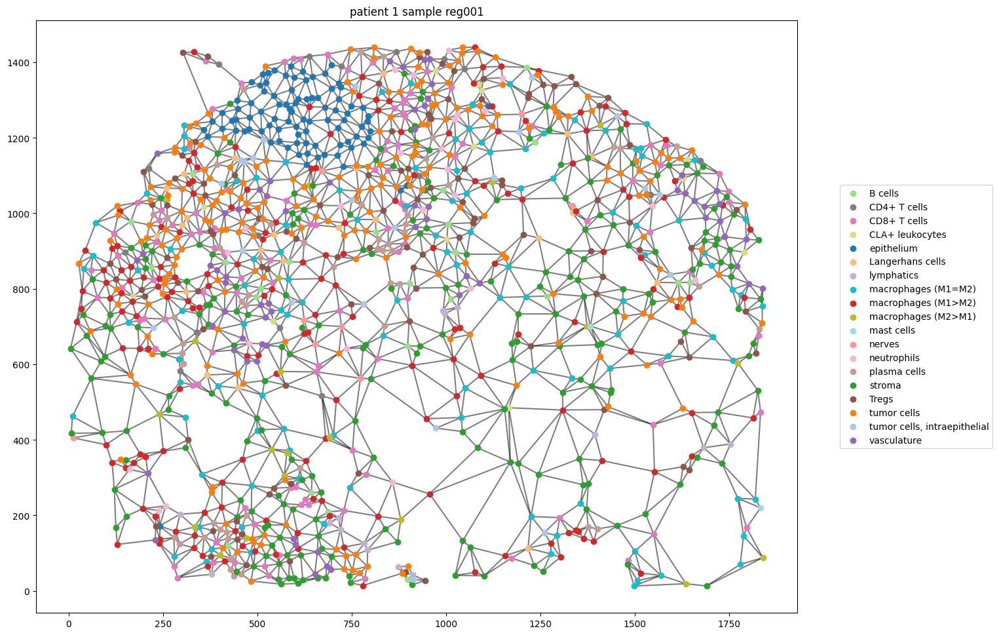

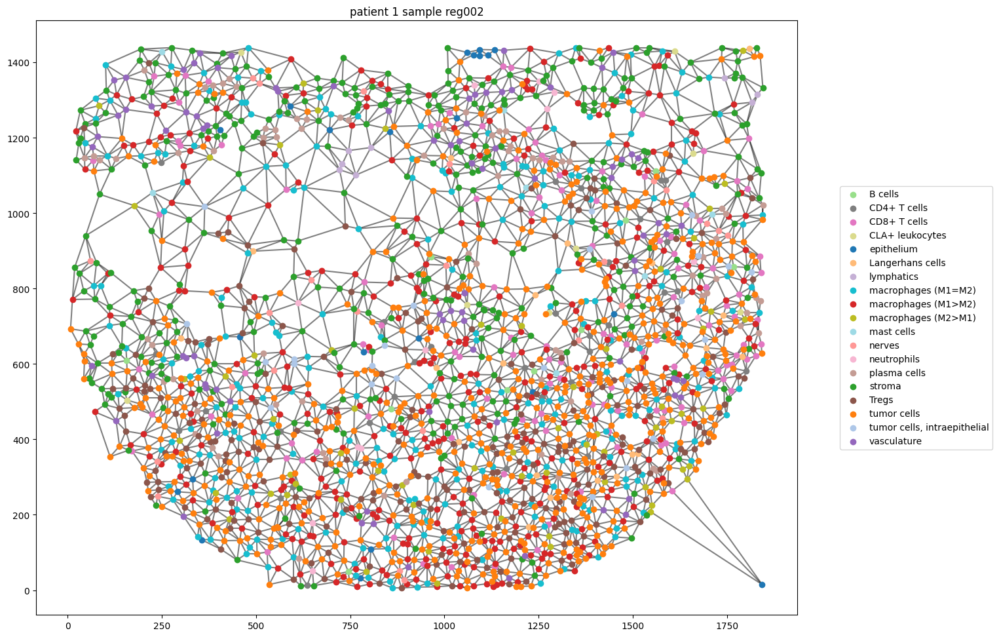

In [23]:
patient_id = 1  # that's our patient
select_patient = obj[patient_col] == patient_id
samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
for sample_id in samples:
    print("processing sample {}".format(sample_id))
    select_sample = obj[sample_col] == sample_id
    nodes = obj.loc[select_patient & select_sample, all_cols]
    coords = nodes[pos_cols].values
    pairs = ty.build_delaunay(coords)
    # we want to avoid isolated cells, so we link them to their 3 closest neighbors
    pairs = ty.link_solitaries(coords, pairs, method='delaunay', min_neighbors=3)

    fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                              color_mapper=celltypes_color_mapper, 
                              legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
    plt.title(f"patient {patient_id} sample {sample_id}")

### All samples network reconstruction

#### Plot spatial networks

In [16]:
processed_dir = Path('../data/processed/CODEX_CTCL')
dir_fig_save = processed_dir / 'figures'

In [18]:
# Choose optimal distance threshold for edge trimming

trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

save_dir = processed_dir / f"pretreatment_samples_networks_xy_choose_distance_trim_dist-{trim_dist}_solitary-{min_neighbors}"
save_dir.mkdir(parents=True, exist_ok=True)

# 'interesting' networks
samples_dst = [
    "reg001",
    "reg006",
    "reg040",
    "reg042",
    "reg051",
    "reg058",
]

k_sol = 0 

if RUN_LONG:
    for sample_id in samples_dst:
        print(f"    processing filename {sample_id}")
        select_sample = obj[sample_col] == sample_id
        nodes = obj.loc[select_sample, all_cols]
        coords = nodes[pos_cols].values
        pairs = ty.build_delaunay(
            coords, 
            node_adaptive_trimming=True, 
            n_edges=3, 
            trim_dist_ratio=2,
            min_dist=0, 
            trim_dist=trim_dist,
            )
        print("    ", end="")

        if min_neighbors > 0:
            pairs = ty.link_solitaries(
                coords, 
                pairs, 
                min_neighbors=min_neighbors,
                )
        distances = ty.distance_neighbors(coords, pairs)

        fig, ax = ty.plot_network_distances(
            coords, pairs, distances, labels=nodes[pheno_col],
            legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.2, 0.5)}
            )
        plt.axis('off');
        title = f"network_distances_sample-{sample_id}"
        plt.savefig(str(save_dir / title) + '.png', bbox_inches='tight', facecolor='white')
        plt.show()

In [17]:
trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"pretreatment_samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "networks_images_common_cmap_saturated_first"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

In [20]:
if RUN_LONG:
    for patient_id in obj[patient_col].unique():
        print(f"processing patient {patient_id}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
        for sample_id in samples:
            print(f"    processing sample {sample_id}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, all_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                                      color_mapper=celltypes_color_mapper, 
                                      legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
            plt.axis('off');
            title = f"patient {patient_id} sample {sample_id}_network_delaunay"
            plt.savefig(str(save_dir / title) + '.jpg', bbox_inches='tight', facecolor='white')
            plt.show()

#### Merge all samples

In [18]:
uniq_patients = obj[patient_col].unique()
uniq_samples = obj[sample_col].unique()
n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

In [22]:
# if RUN_LONG:
#     edges_all = pd.DataFrame(data=None, columns=['source', 'target'])
#     # number of nodes previously seen
#     nb_nodes = 0
#     for sample_id in obj[patient_col].unique():
#         print(f"processing sample {sample_id}")
#         select_sample = obj[patient_col] == sample_id
#         filenames = obj.loc[select_sample, sample_col].unique()
#         for filename in filenames:
#             print("    processing filename {}".format(filename))
#             select_file = obj[sample_col] == filename
#             nodes = obj.loc[select_sample & select_file, all_cols]
#             coords = nodes[pos_cols].values
#             pairs = ty.build_delaunay(
#                 coords, 
#                 node_adaptive_trimming=True, 
#                 n_edges=3, 
#                 trim_dist_ratio=2,
#                 min_dist=0, 
#                 trim_dist=trim_dist,
#                 )
#             if min_neighbors > 0:
#                 pairs = ty.link_solitaries(
#                     coords, 
#                     pairs, 
#                     min_neighbors=min_neighbors,
#                     )

#             # increase ids in pairs by the number of nodes in all previously loaded networks
#             pairs = pairs + nb_nodes
#             edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
#             edges[sample_col] = filename
#             # update number of nodes for next network
#             nb_nodes = nb_nodes + coords.shape[0]
#             edges_all = pd.concat([edges_all, edges], ignore_index=True)
#     edges_all.to_csv(reconst_dir / 'sample_all-edges.csv', index=False)
# else:
#     edges_all = pd.read_csv(reconst_dir / 'sample_all-edges.csv')

In [ ]:
all_cols

In [ ]:
# or save in separate file for convenience
if RUN_LONG:
    for i, patient_id in enumerate(uniq_patients):
        print(f"processing patient {patient_id} {i+1}/{n_uniq_patients}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()
        for j, sample_id in enumerate(samples):
            print(f"    processing sample {sample_id} {i+j+1}/{n_uniq_samples}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, net_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
            edges.to_parquet(edges_dir / f'edges_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

            nodes.to_parquet(nodes_dir / f'nodes_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

### Data transfomation and batch correction

#### CLR transformation

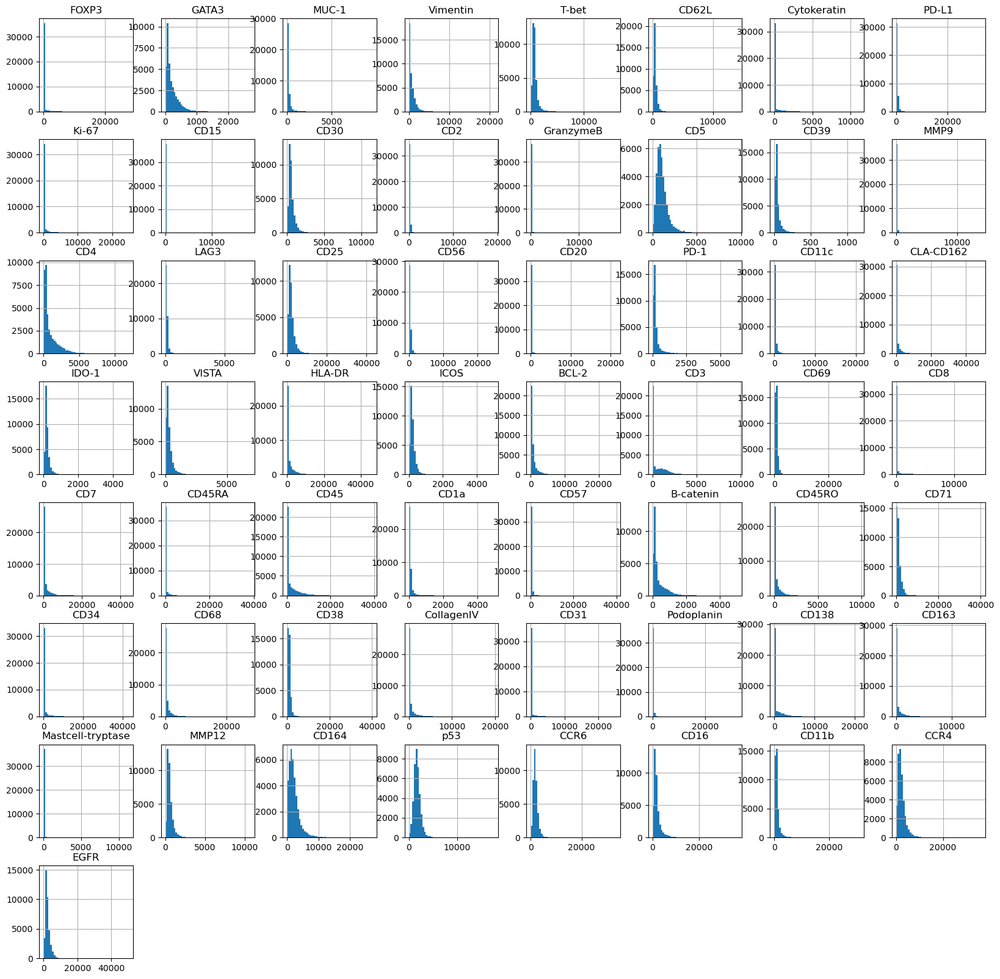

In [19]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

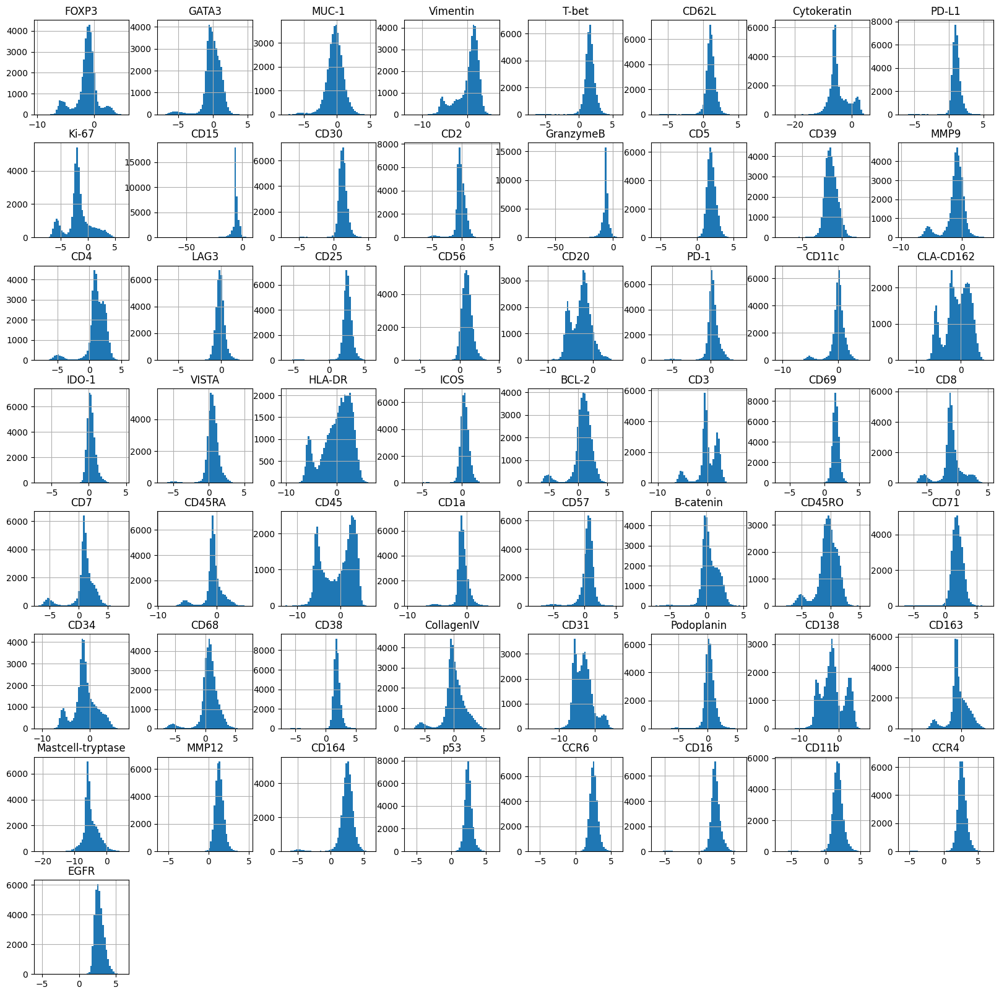

In [32]:
obj_transfo = mosna.transform_data(
    data=obj, 
    groups=sample_col,
    use_cols=marker_cols,
    method='clr')

obj_transfo[marker_cols].hist(bins=50, figsize=(20, 20));

In [27]:
nodes_dir = mosna.transform_nodes(
    nodes_dir=nodes_dir,
    id_level_1='patient',
    id_level_2='sample', 
    use_cols=marker_cols,
    method='clr',
    save_dir='auto',
)

extension: parquet


### Batch corrrection

#### make UMAP before batch correction

In [31]:
nodes_agg = mosna.aggregate_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
)

In [32]:
nodes_agg

,FOXP3,GATA3,MUC-1,Vimentin,T-bet,CD62L,Cytokeratin,PD-L1,Ki-67,CD15,...,MMP12,CD164,p53,CCR6,CD16,CD11b,CCR4,EGFR,patient,sample
0,-0.577643,0.303034,0.927949,-0.254543,0.851944,0.591799,-1.014143,1.522339,-0.601958,-2.251974,...,0.549218,0.289326,0.940971,1.641375,2.708796,0.289944,1.133214,1.207078,2,reg005
1,-4.033218,-2.332929,-2.044272,-0.798900,1.159985,-0.364916,-2.081535,1.967116,-2.880154,-4.608071,...,-1.465241,-0.273685,0.690325,0.419829,3.193155,-0.119408,3.098539,2.993863,2,reg005
2,-2.048273,-0.115249,0.215023,1.319041,1.894499,1.112348,-7.542443,1.253748,-1.996564,-6.372283,...,1.589725,3.393049,2.506503,2.419743,3.357358,2.663107,1.966820,2.683260,2,reg005
3,-1.421894,-0.095094,-0.589580,2.310676,1.796479,1.071387,-4.040258,1.084849,-2.450859,-7.075460,...,1.448667,3.458985,2.235682,2.178291,3.532978,2.236924,2.129429,2.647542,2,reg005
4,-1.072511,-0.551604,-0.770388,2.945916,1.797972,1.306224,-5.360121,1.162806,1.800443,-12.737854,...,0.825002,2.849466,2.392137,1.541138,3.435253,2.266494,1.887595,3.061349,2,reg005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38060,-0.149549,-1.043051,-2.003256,0.789330,0.380304,0.097740,-1.599680,0.585397,-2.324107,-2.378211,...,0.805515,1.117501,1.683828,1.661990,2.008904,1.183713,1.755553,1.850817,3,reg009
38061,0.250702,-1.129898,1.303055,1.391171,1.605707,1.185920,-6.081461,1.128793,-1.979856,-6.081461,...,1.319780,2.731213,2.775572,2.700915,2.659446,1.916965,2.706461,2.963308,3,reg009
38062,-0.508385,-0.081507,2.071783,0.256330,0.813486,0.784149,-7.157277,0.774346,0.957699,-7.157277,...,0.739428,1.866181,2.027164,1.918900,1.718823,0.974998,2.344081,1.826326,3,reg009
38063,0.925035,-0.753774,-2.943654,2.362044,2.032106,1.283706,-5.719733,1.141324,-5.719733,-4.729417,...,1.531272,1.507729,3.161583,2.694277,3.807474,2.364732,2.845351,3.155808,3,reg009


In [33]:
embed_viz, _ = mosna.get_reducer(nodes_agg[marker_cols], nodes_dir)

Computing dimensionality reduction


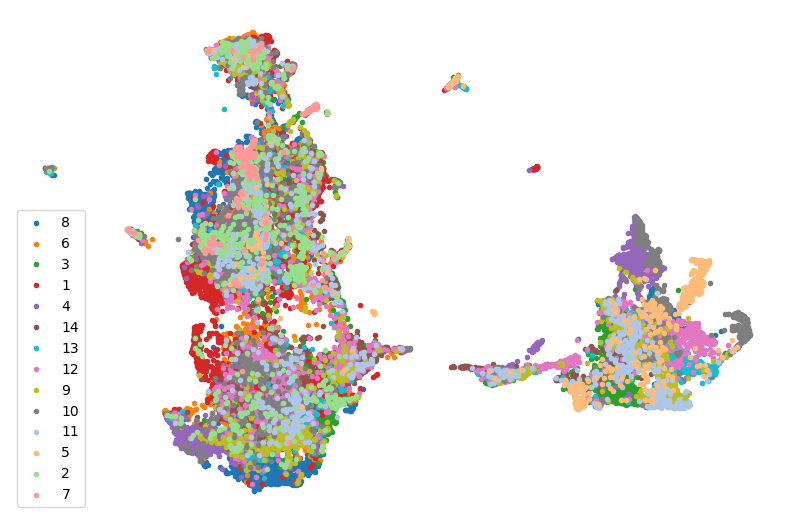

In [42]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

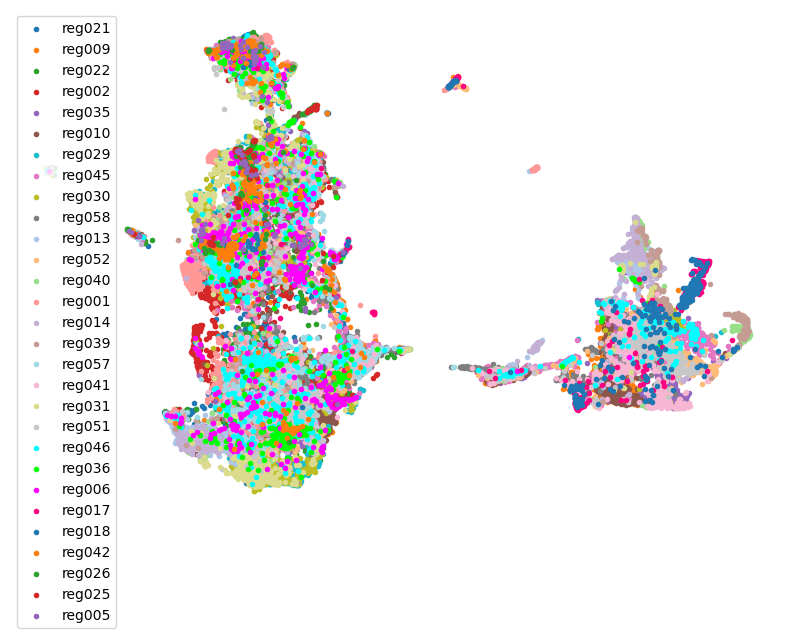

In [43]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['sample'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

#### Perform batch correction

In [ ]:
nodes_dir, nodes_corr = mosna.batch_correct_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
    batch_key='patient',
    return_nodes=True,
    )

In [85]:
embed_viz, _ = mosna.get_reducer(nodes_corr[marker_cols], nodes_dir)

Computing dimensionality reduction


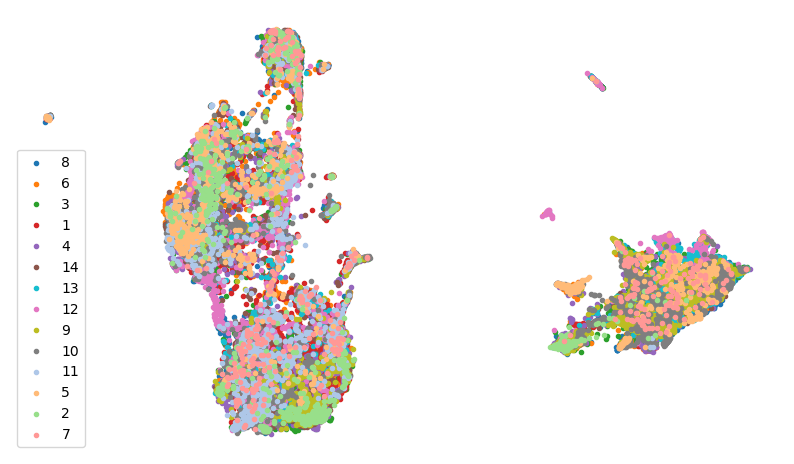

In [86]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_corr['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

## Response groups characteristics and survival analysis

We will look at what variables define or explain response to therapy or longer survival.  
For this, we will start with the simplest statistics, like proportions of cell types or marker-positive cells, and we will gradulally increase the complexity of variables, looking at interactions between cell types and finally discovering spatial neighborhoods, or "niches", potentially predictive of response to therapy.

### Cell types proportions

In [90]:
# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique() 

In [91]:
# here we don't use `sample_col` but `patient_col` in the group / unstack procedure to aggregate 
# statistics per patient and condition (before / after treatment) rather than per sample.

count_types = obj[[patient_col, group_col, 'Count']].join(nodes_all[pheno_col]).groupby([patient_col, group_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
# count_types.index.name = 'sample'
count_types.to_csv(save_dir / 'count_types_per_patient_per_condition.csv')
count_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,34,50,229,20,0,0,42,350,112,23,...,545,83,9,33,36,133,582,777,48,149
2,1,6,3,5,3,0,0,12,15,6,5,...,71,64,3,6,1,4,203,155,2,95
3,2,2,208,186,14,0,2,130,99,1759,24,...,397,39,33,17,0,4,328,546,274,86
4,2,178,20,45,0,0,0,16,9,901,7,...,202,10,12,9,0,4,356,987,5,186
5,1,0,0,1,0,0,0,5,6,913,0,...,17,2,2,3,0,1,34,7,1,18
6,2,83,200,693,15,0,3,95,357,11,102,...,809,43,20,5,26,35,679,1157,22,255
7,2,0,0,0,0,0,0,1,0,0,3,...,16,0,5,150,0,0,180,3,0,32
8,2,24,42,39,14,0,0,9,38,338,45,...,174,730,1,49,69,31,871,2081,8,306
9,1,2,19,51,2,0,0,11,9,1041,4,...,129,11,29,11,0,0,354,751,12,168


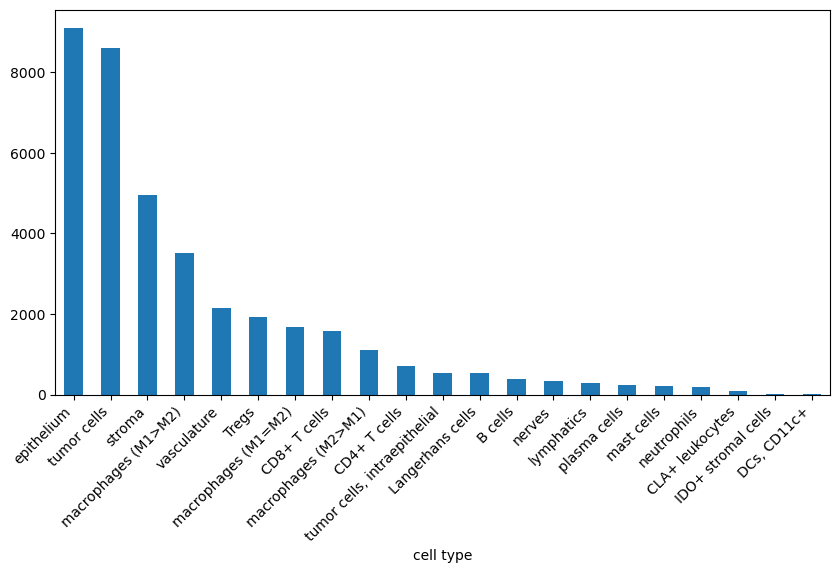

In [92]:
ax = count_types.sum().sort_values(ascending=False).plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');

Instead of counts we use proportions of cell types per patient and condition.

In [93]:
prop_types = count_types.div(count_types.sum(axis=1), axis=0)
prop_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,0.009379,0.013793,0.063172,0.005517,0.000000,0.000000,0.011586,0.096552,0.030897,0.006345,...,0.150345,0.022897,0.002483,0.009103,0.009931,0.036690,0.160552,0.214345,0.013241,0.041103
2,1,0.008392,0.004196,0.006993,0.004196,0.000000,0.000000,0.016783,0.020979,0.008392,0.006993,...,0.099301,0.089510,0.004196,0.008392,0.001399,0.005594,0.283916,0.216783,0.002797,0.132867
3,2,0.000465,0.048327,0.043216,0.003253,0.000000,0.000465,0.030204,0.023002,0.408690,0.005576,...,0.092240,0.009061,0.007667,0.003950,0.000000,0.000929,0.076208,0.126859,0.063662,0.019981
4,2,0.058649,0.006590,0.014827,0.000000,0.000000,0.000000,0.005272,0.002965,0.296870,0.002306,...,0.066557,0.003295,0.003954,0.002965,0.000000,0.001318,0.117298,0.325206,0.001647,0.061285
5,1,0.000000,0.000000,0.000984,0.000000,0.000000,0.000000,0.004921,0.005906,0.898622,0.000000,...,0.016732,0.001969,0.001969,0.002953,0.000000,0.000984,0.033465,0.006890,0.000984,0.017717
6,2,0.017263,0.041597,0.144135,0.003120,0.000000,0.000624,0.019759,0.074251,0.002288,0.021215,...,0.168261,0.008943,0.004160,0.001040,0.005408,0.007280,0.141223,0.240641,0.004576,0.053037
7,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002494,0.000000,0.000000,0.007481,...,0.039900,0.000000,0.012469,0.374065,0.000000,0.000000,0.448878,0.007481,0.000000,0.079800
8,2,0.004871,0.008524,0.007916,0.002841,0.000000,0.000000,0.001827,0.007713,0.068602,0.009133,...,0.035316,0.148163,0.000203,0.009945,0.014004,0.006292,0.176781,0.422367,0.001624,0.062107
9,1,0.000749,0.007113,0.019094,0.000749,0.000000,0.000000,0.004118,0.003370,0.389742,0.001498,...,0.048297,0.004118,0.010857,0.004118,0.000000,0.000000,0.132535,0.281168,0.004493,0.062898


In [94]:
pvals = mosna.find_DE_markers(prop_types, group_ref=1, group_tgt=2, group_var=group_col)
pvals

,pval,pval_corr
IDO+ stromal cells,0.075413,0.988974
lymphatics,0.128205,0.988974
CD4+ T cells,0.141282,0.988974
tumor cells,0.259324,0.996411
epithelium,0.317599,0.996411
CD8+ T cells,0.382867,0.996411
vasculature,0.455711,0.996411
B cells,0.481721,0.996411
macrophages (M1=M2),0.534965,0.996411
Langerhans cells,0.620047,0.996411


There are 0 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

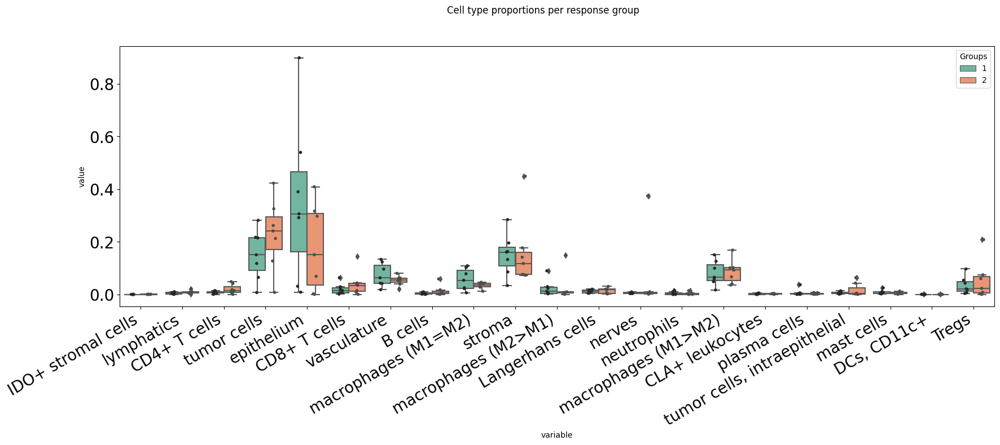

In [28]:
fig, ax = mosna.plot_distrib_groups(
    prop_types, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=-1, 
    multi_ind_to_col=True,
    )
fig.suptitle("Cell type proportions per response group", y=1.0);

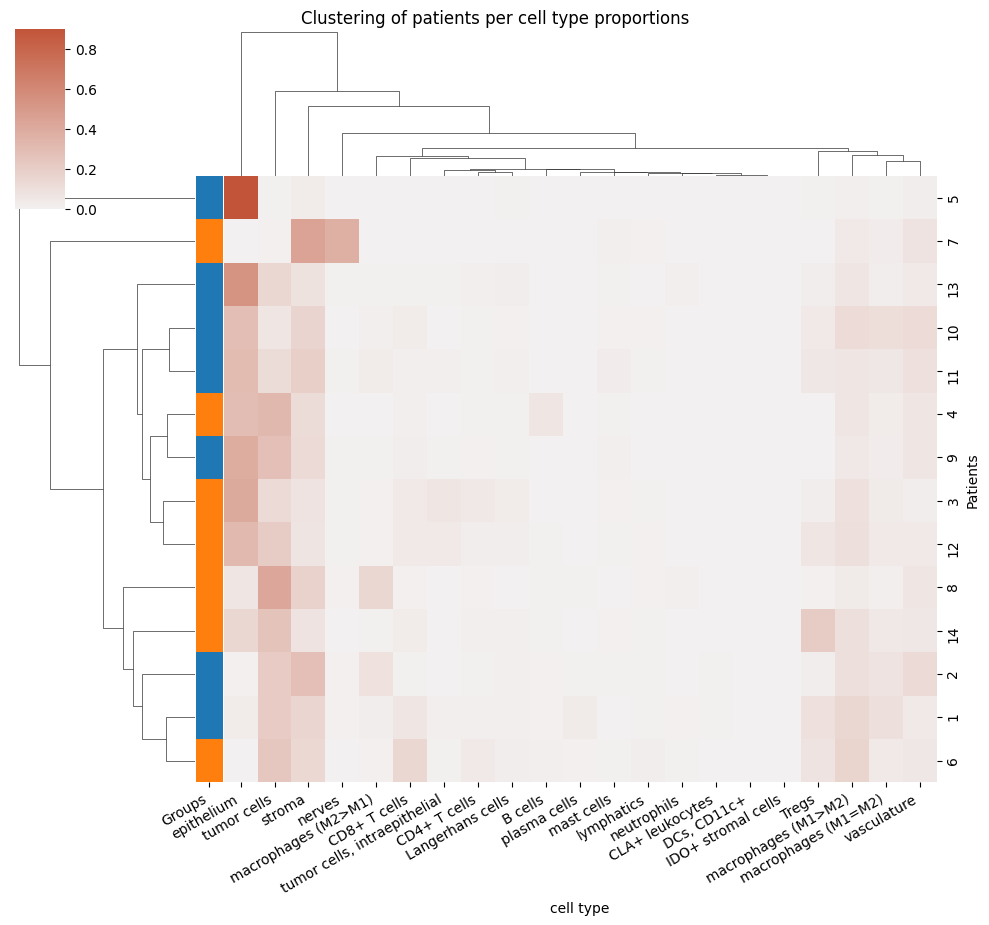

In [29]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    )
g.fig.suptitle("Clustering of patients per cell type proportions", y=1.0);

Because some variables have generally higher values than others, that give them more weight to compare samples.  
To compensate for this effect we should standardize values per variable.

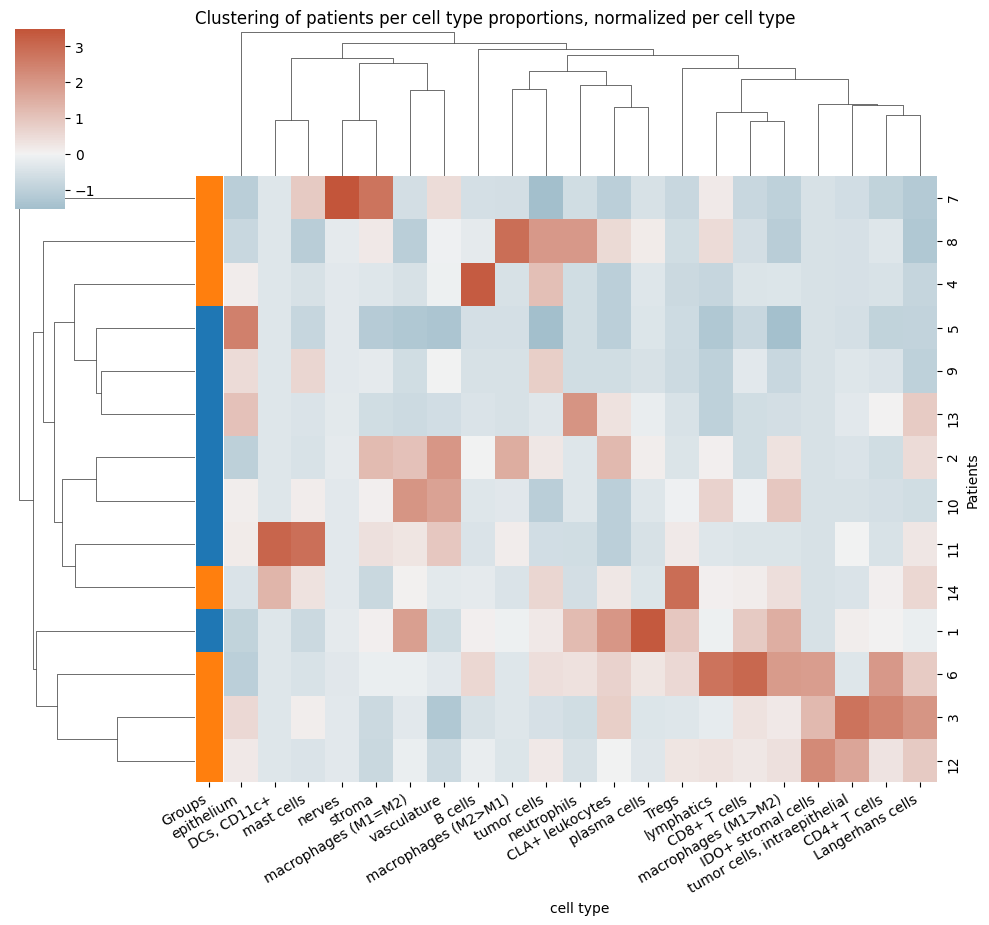

In [30]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    )
g.fig.suptitle("Clustering of patients per cell type proportions, normalized per cell type", y=1.0);

In [75]:
# With this dataset, when we filter networks without enough nodes
# we can't split patients in 5 groups having at least one occurrence
# of both groups (one patient of group 2 is deleted).

if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

        training failed
        training failed with cv <= 5
Training took 2.544s


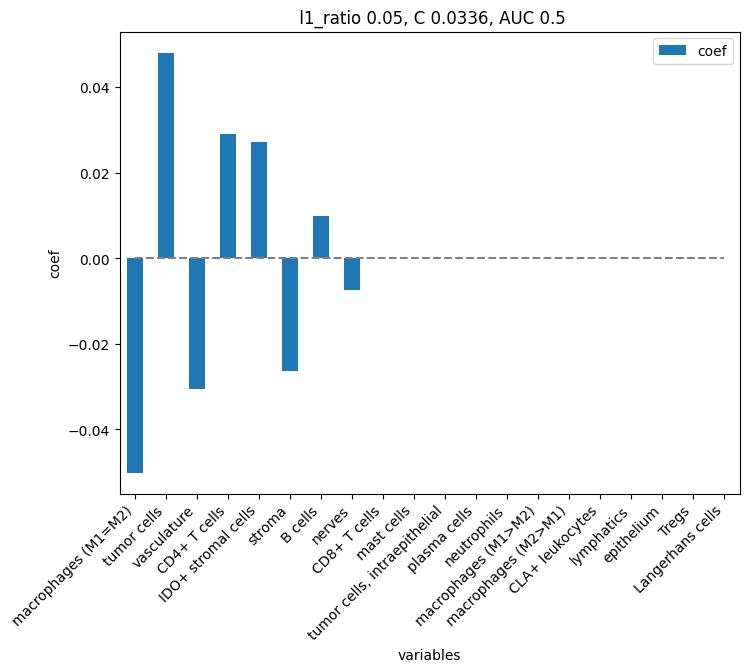

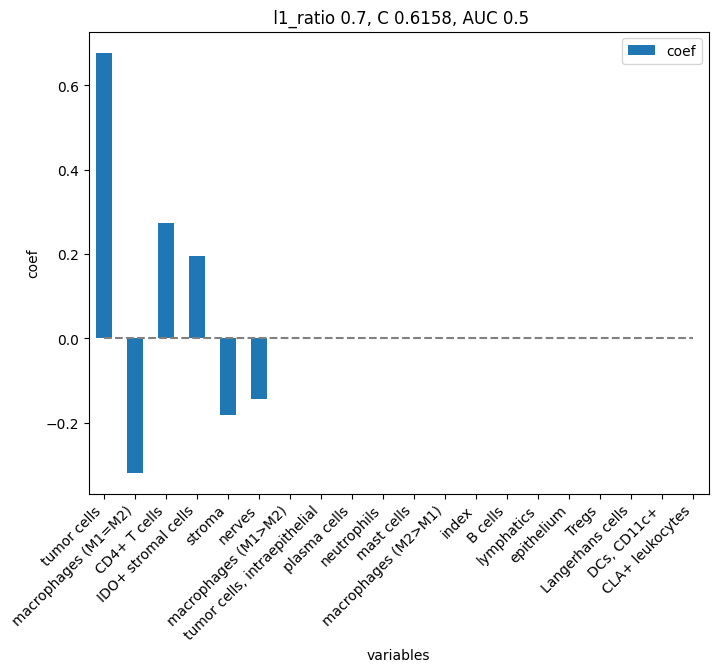

In [32]:
models = mosna.logistic_regression(
    prop_types.reset_index(),
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    figsize=(8,6),
    )

Cell types proportions are not significantly associated with response / non response in samples before treatment.  
But `mosna` can find composed variables potentially related to response of patients:

### Ratio of cell type proportions

In [33]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [34]:
pvals.head(20)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.696813
lymphatics / vasculature,0.026224,0.696813
lymphatics / macrophages (M2>M1),0.040692,0.696813
tumor cells / vasculature,0.053030,0.696813
IDO+ stromal cells / epithelium,0.053349,0.696813
IDO+ stromal cells / macrophages (M2>M1),0.053349,0.696813
"IDO+ stromal cells / tumor cells, intraepithelial",0.053349,0.696813
CD8+ T cells / IDO+ stromal cells,0.053349,0.696813
IDO+ stromal cells / Tregs,0.053349,0.696813
lymphatics / stroma,0.072844,0.696813


There are 3 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

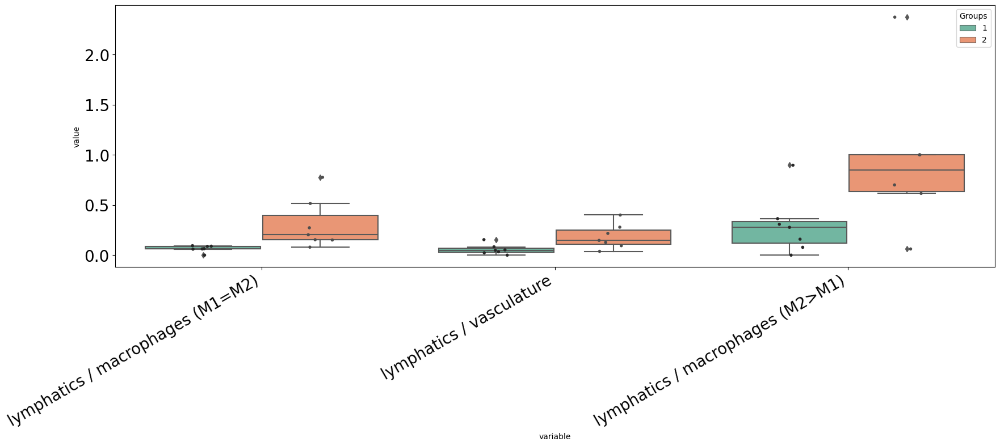

In [35]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

In [37]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 315 non finite values (9.7%)
Imputing data


In [40]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.829539
lymphatics / vasculature,0.026224,0.829539
IDO+ stromal cells / Tregs,0.030721,0.829539
IDO+ stromal cells / epithelium,0.030721,0.829539
IDO+ stromal cells / macrophages (M2>M1),0.030721,0.829539
"IDO+ stromal cells / tumor cells, intraepithelial",0.030721,0.829539
tumor cells / vasculature,0.053030,0.829539
lymphatics / macrophages (M2>M1),0.055017,0.829539
lymphatics / stroma,0.072844,0.829539
CD4+ T cells / macrophages (M2>M1),0.072844,0.829539


There are 6 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

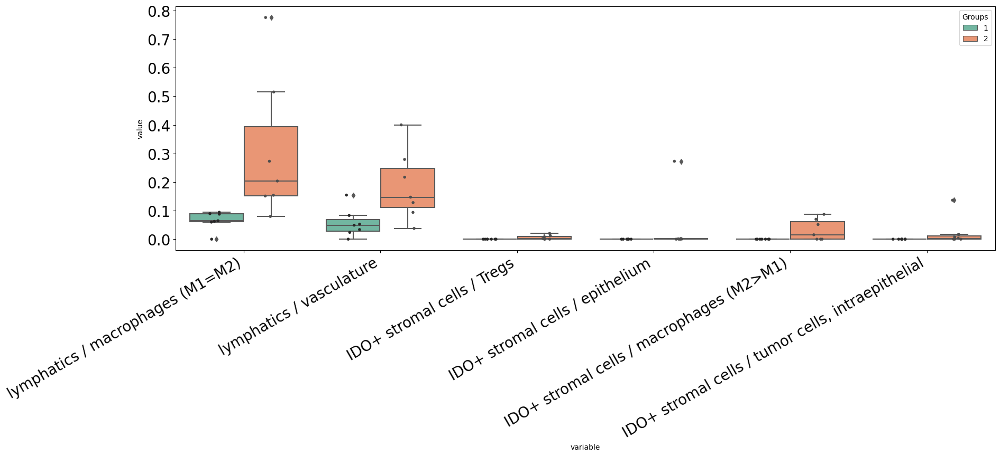

In [41]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

There are 6 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

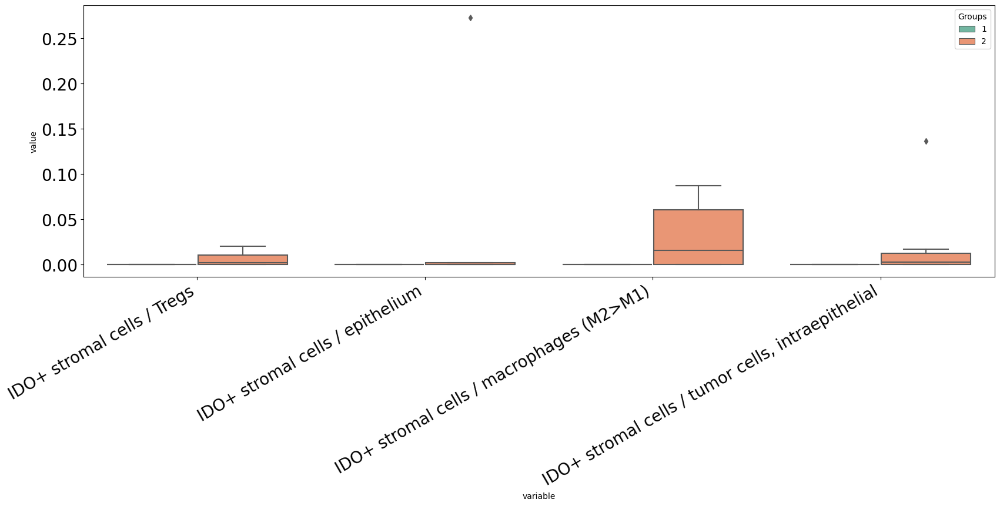

In [43]:
# ignore the first 2 composed variables as their representation hide other distributions

exclude_vars = [
    'lymphatics / macrophages (M1=M2)',
    'lymphatics / vasculature',
]

fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    add_points=False,
    )

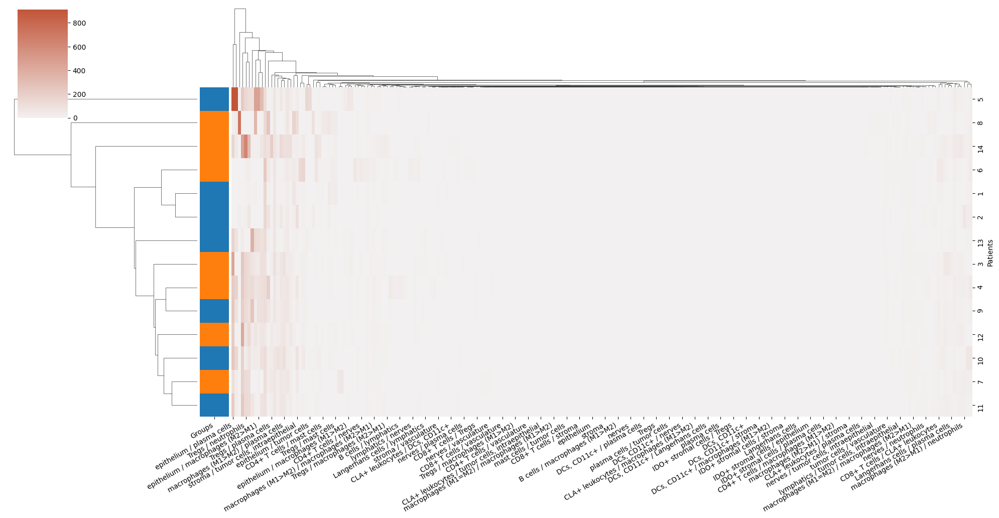

In [44]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    );

In [46]:
# We can't display the dendrogram with values normalized per variable, as some non finite values are produced and make seaborn crash.  

# best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# # or to select only 20 variables:
# # best_pval_names = pvals.head(20).index
# mosna.plot_heatmap(
#     prop_types_comp_cleaned.reset_index(), 
#     obs_labels=patient_col, 
#     group_var=group_col, 
#     groups=[1, 2],
#     z_score=1,
#     figsize=(20, 12),
#     )

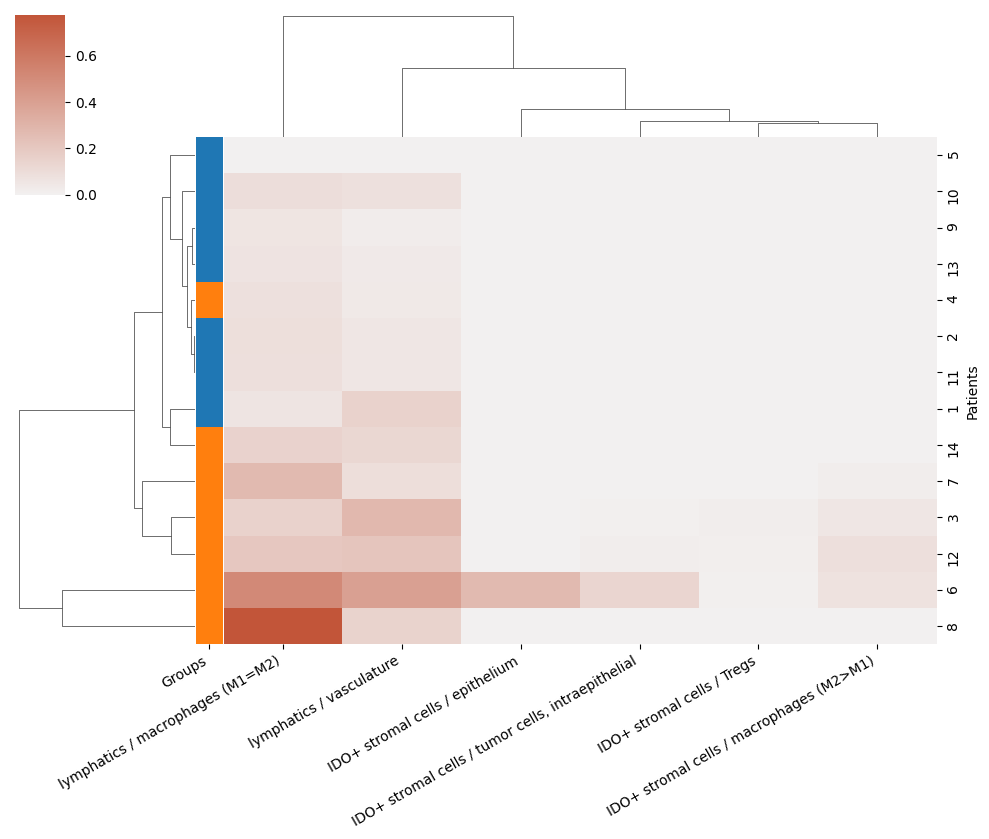

In [49]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    );

Training took 2.929s


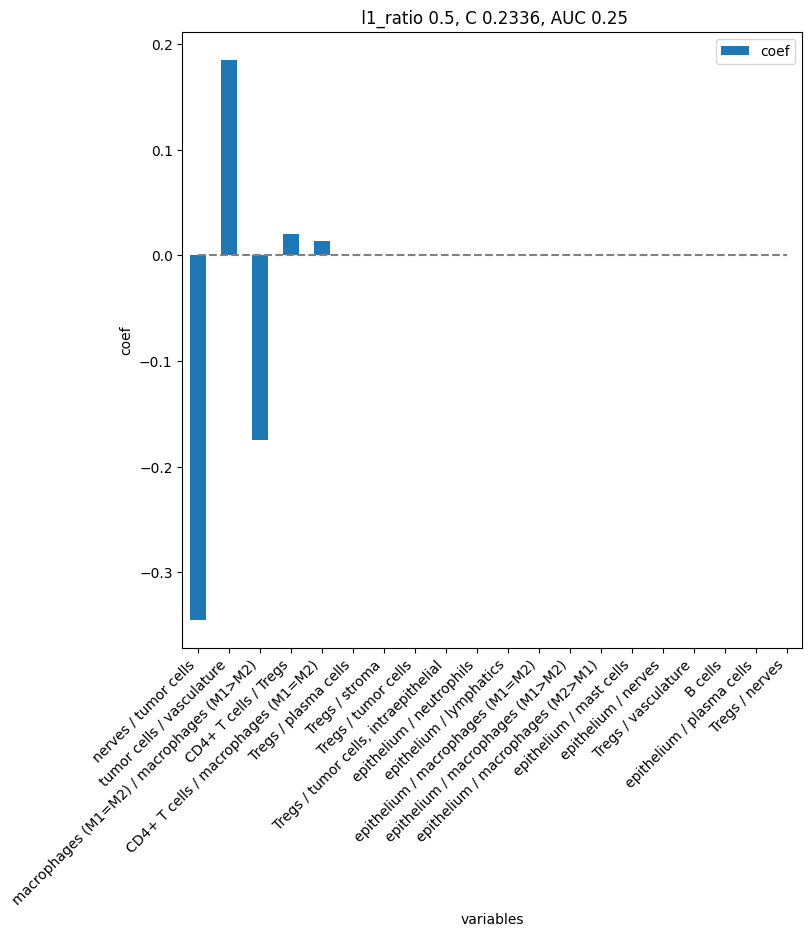

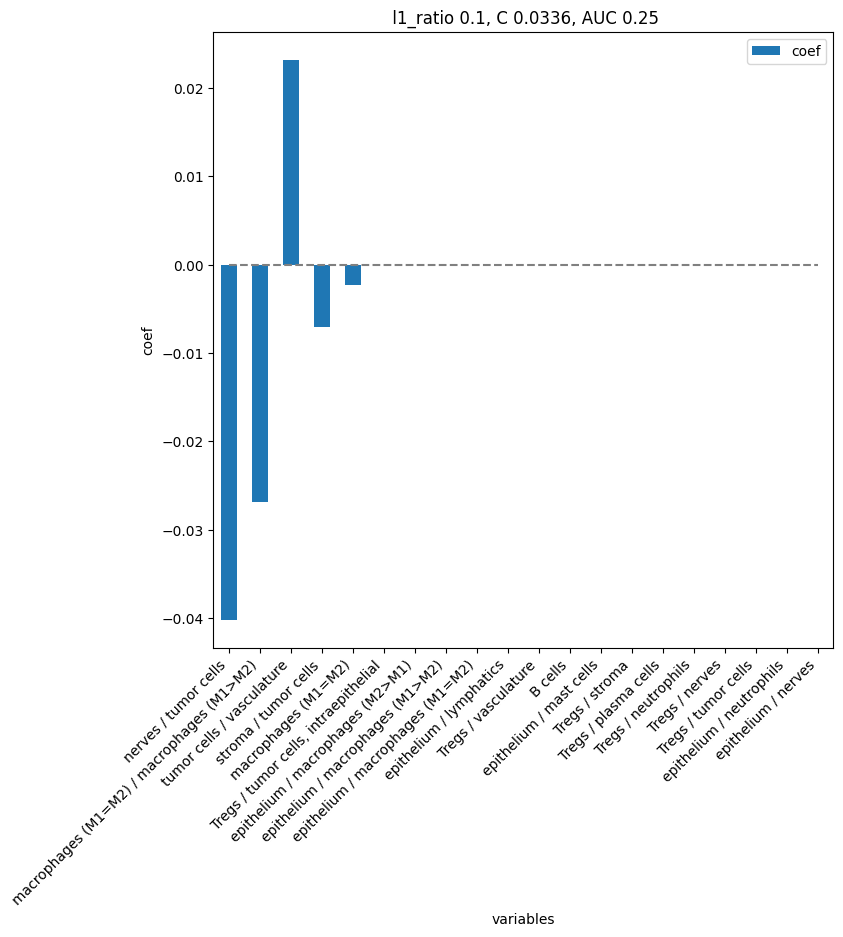

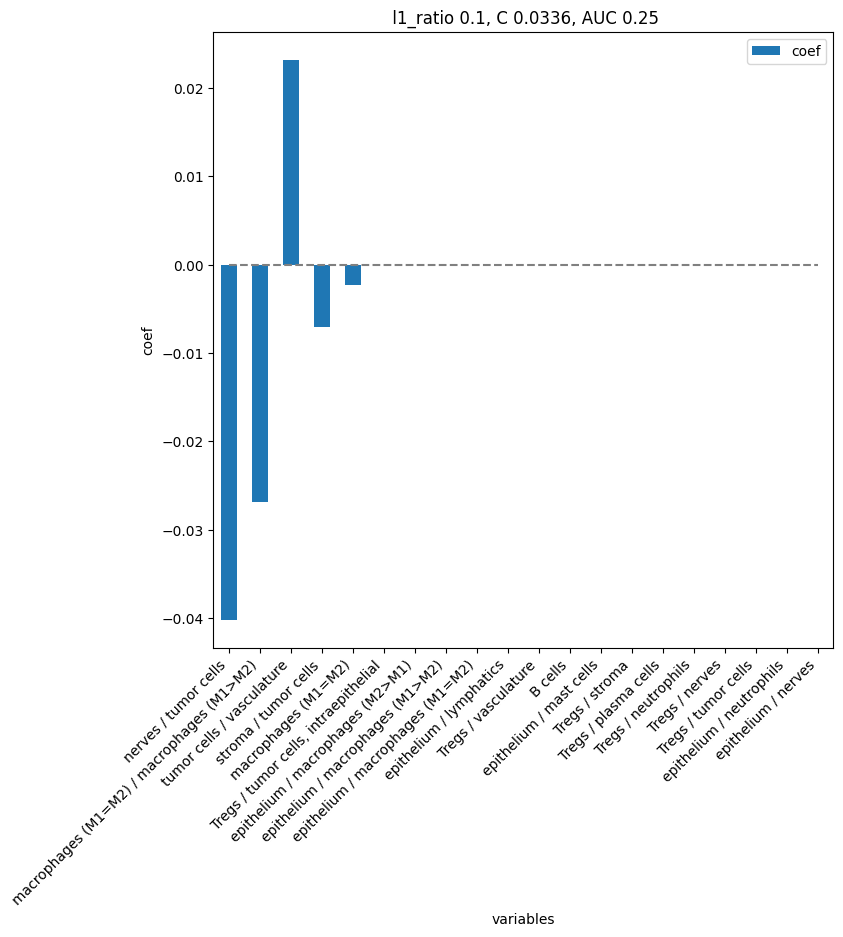

In [50]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.373s


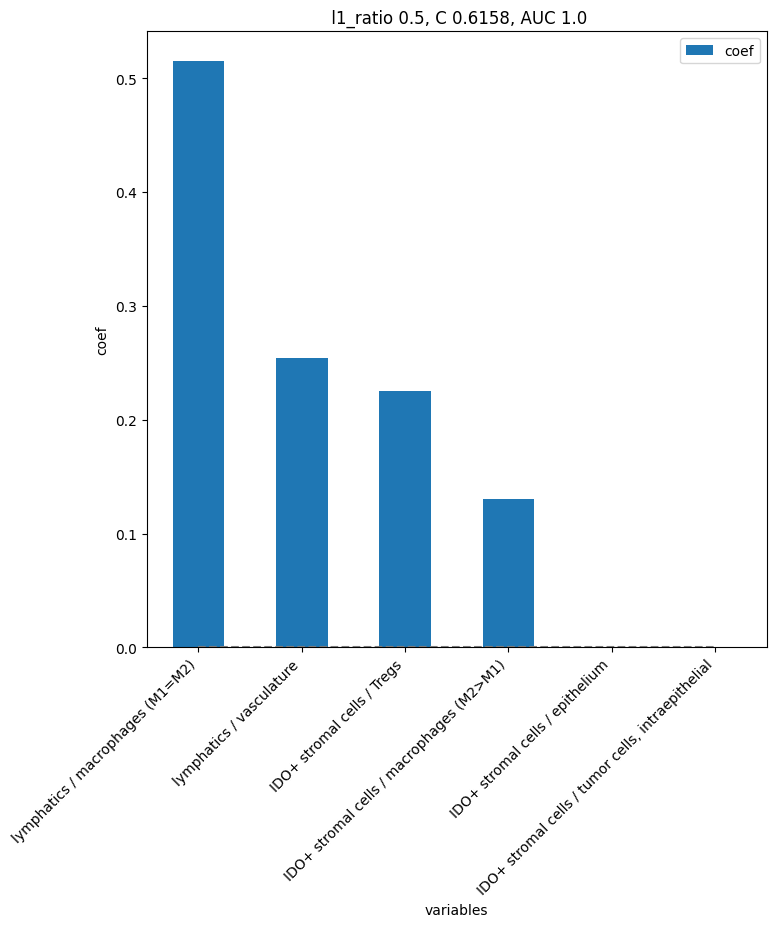

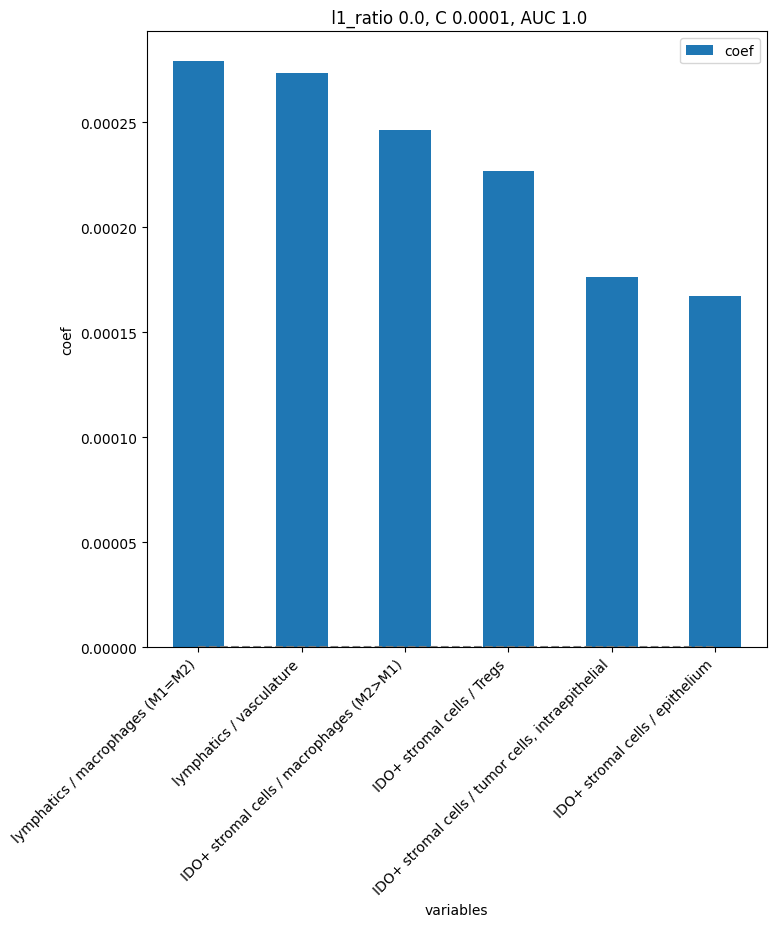

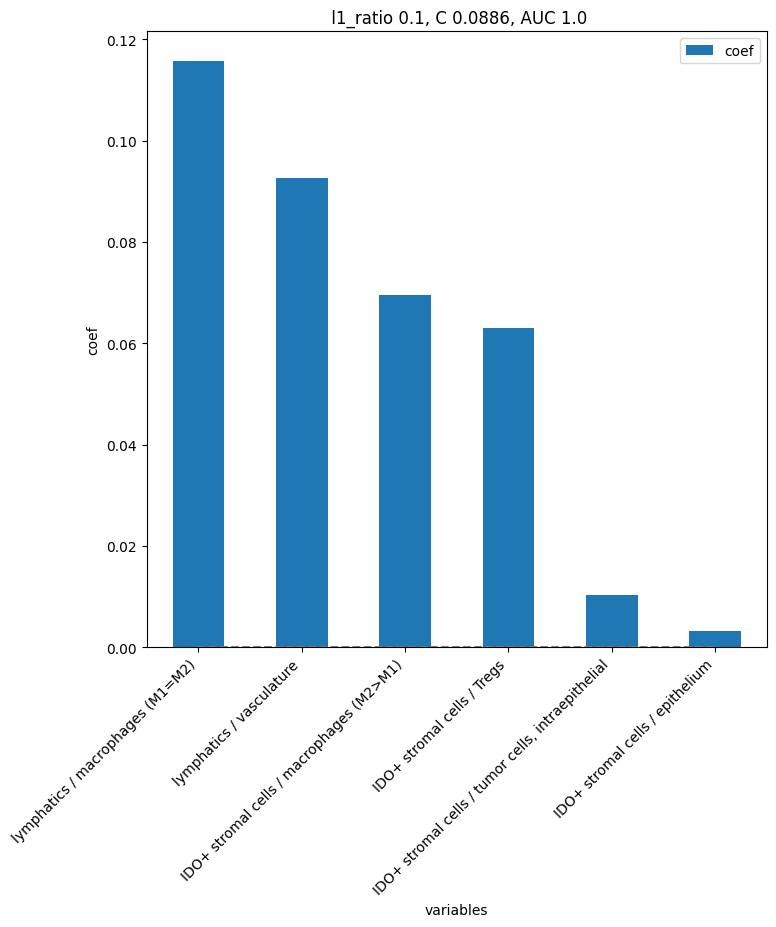

In [51]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Proportions of cell type proportions

Simple ratios can be problematic as they can lead to extreme values, such as in the case of x/0. To avoid that, we use proportions instead, i.e. a / (a + b), so all values are between 0 and 1.

In [56]:
from importlib import reload
reload(mosna)

<module 'mosna.mosna' from '/Users/Alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py'>

In [57]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='proportion', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [58]:
pvals.head(20)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.696813
lymphatics / ( lymphatics + vasculature ),0.026224,0.696813
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.696813
tumor cells / ( tumor cells + vasculature ),0.053030,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + epithelium ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + macrophages (M2>M1) ),0.053349,0.696813
"IDO+ stromal cells / ( IDO+ stromal cells + tumor cells, intraepithelial )",0.053349,0.696813
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.053349,0.696813
lymphatics / ( lymphatics + stroma ),0.072844,0.696813


There are 3 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

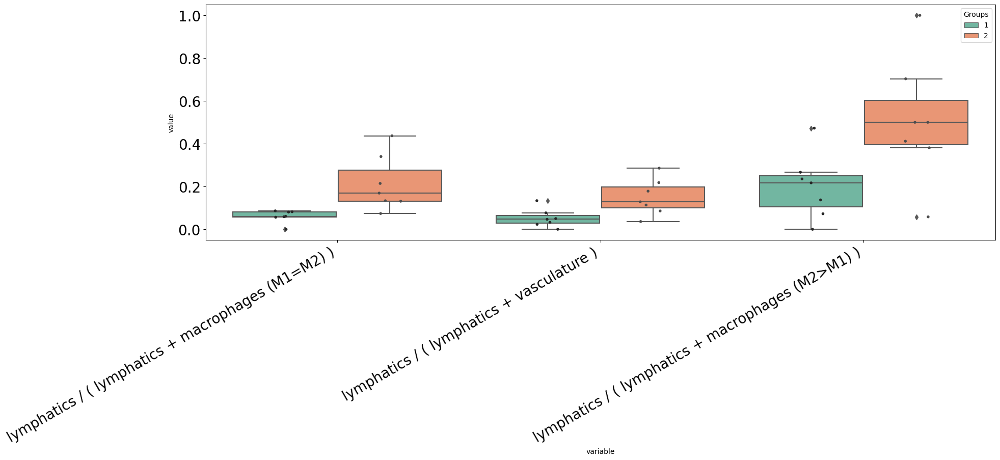

In [59]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

In [60]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN

# with proportions of variables there are 3x fewer NaNs
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 113 non finite values (3.5%)
Imputing data


In [61]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.829539
lymphatics / ( lymphatics + vasculature ),0.026224,0.829539
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.829539
tumor cells / ( tumor cells + vasculature ),0.053030,0.829539
lymphatics / ( lymphatics + macrophages (M1>M2) ),0.072844,0.829539
nerves / ( nerves + tumor cells ),0.072844,0.829539
lymphatics / ( lymphatics + stroma ),0.072844,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.075413,0.829539
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.075413,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + vasculature ),0.075413,0.829539


In [63]:
# Here there is no additional significant variable after data imputation, so we don't plot anything

# fig, ax = mosna.plot_distrib_groups(
#     prop_types_comp_cleaned, 
#     group_var=group_col,
#     groups=[1, 2], 
#     pval_data=pvals_cleaned, 
#     pval_col='pval', 
#     max_cols=20, 
#     multi_ind_to_col=True,
#     )

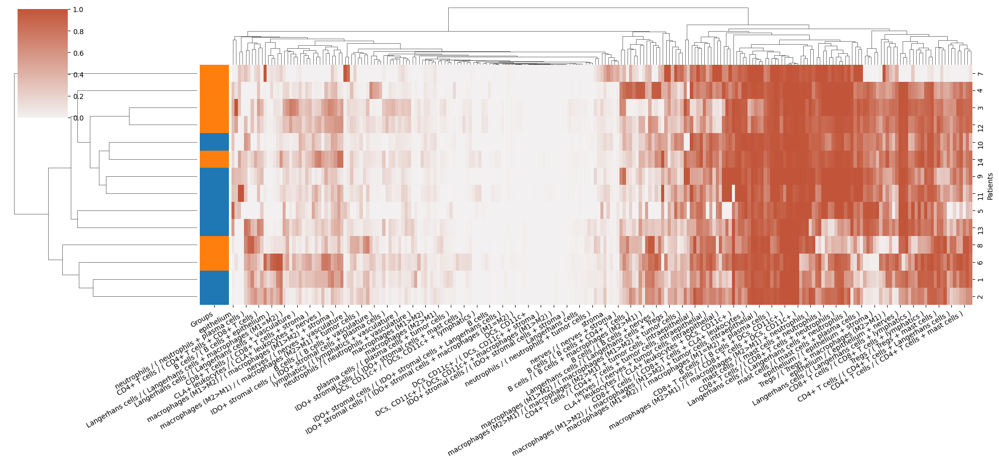

In [64]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    );

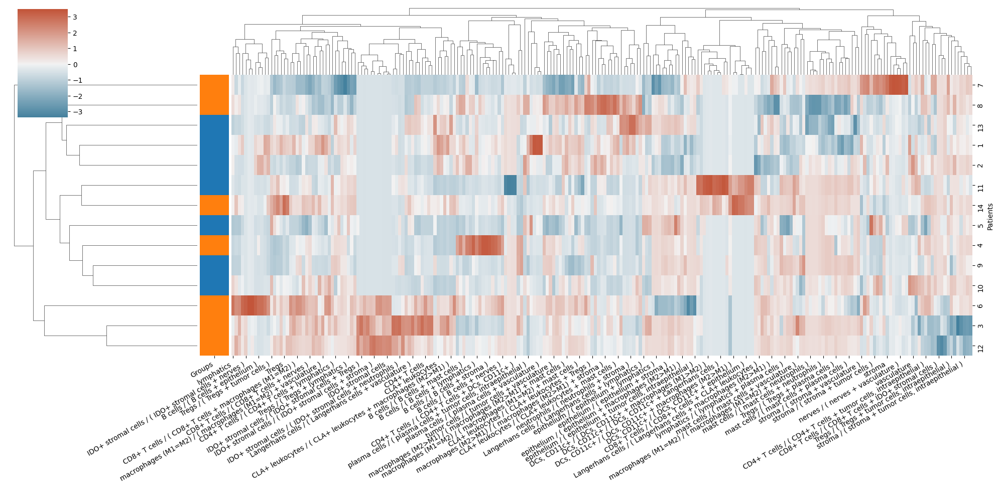

In [65]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

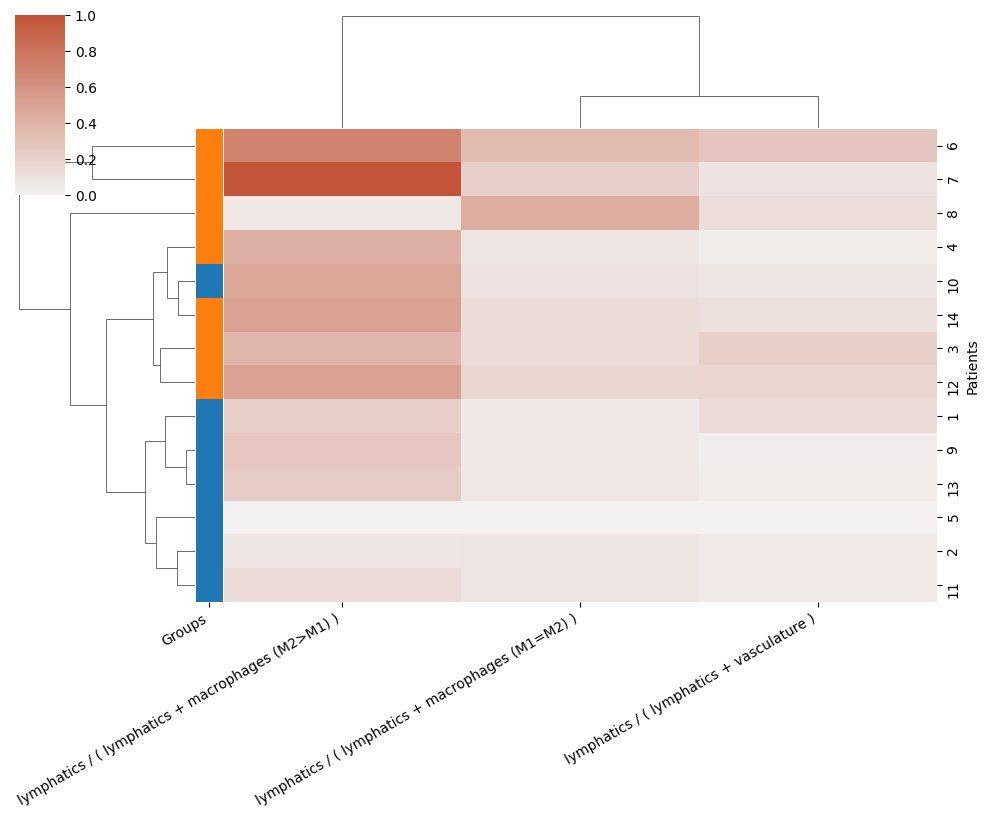

In [71]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    );

Training took 3.035s


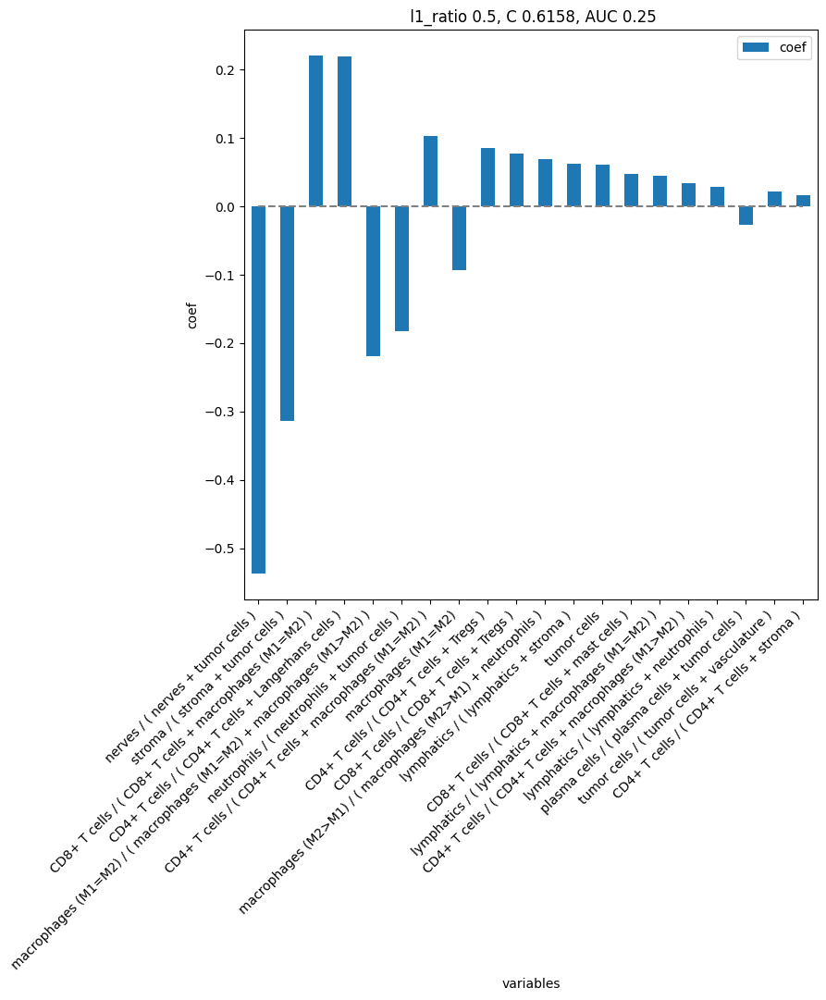

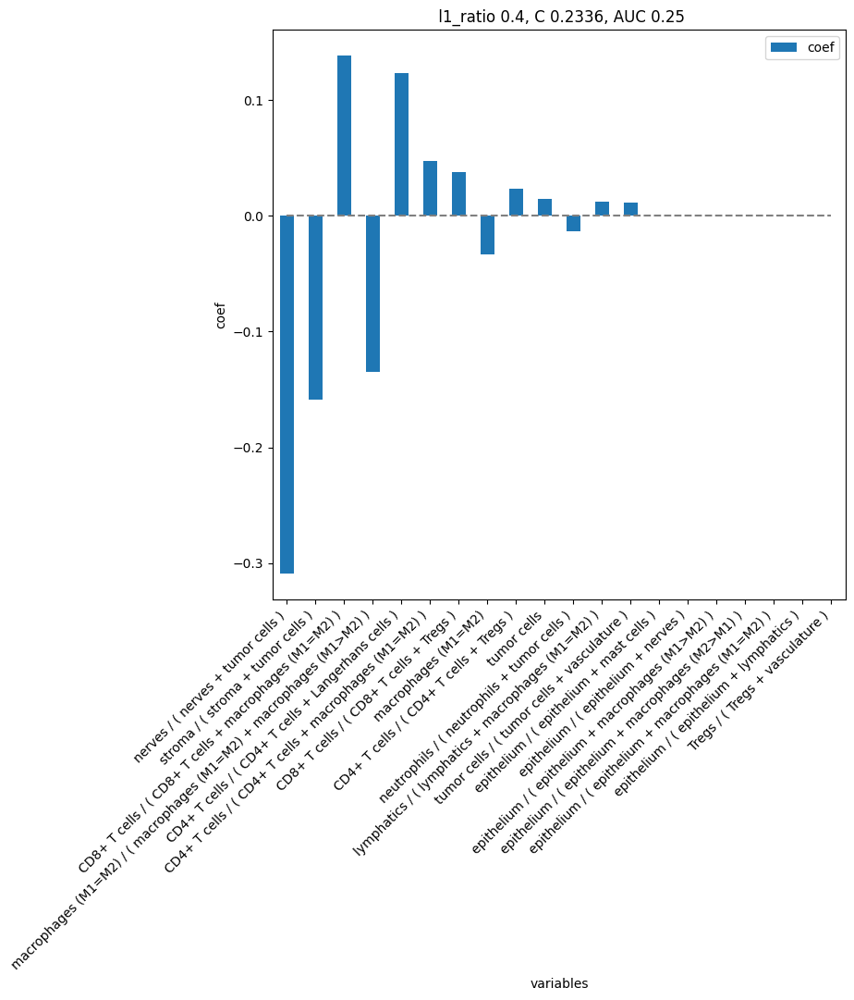

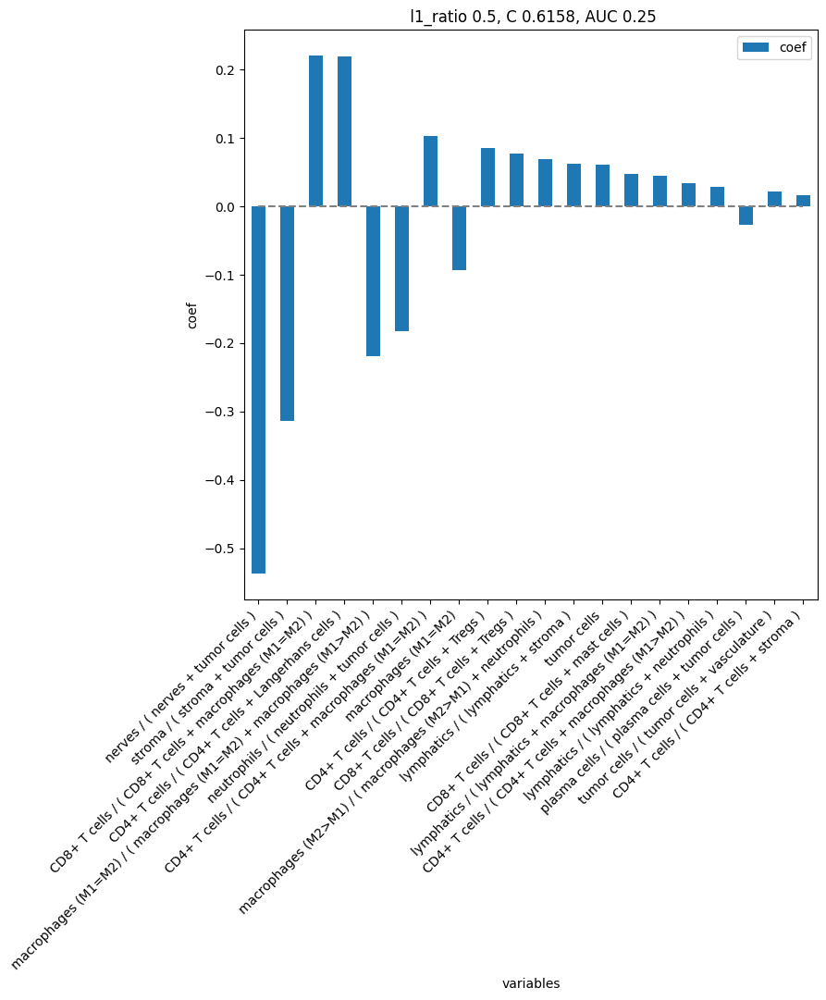

In [67]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.473s


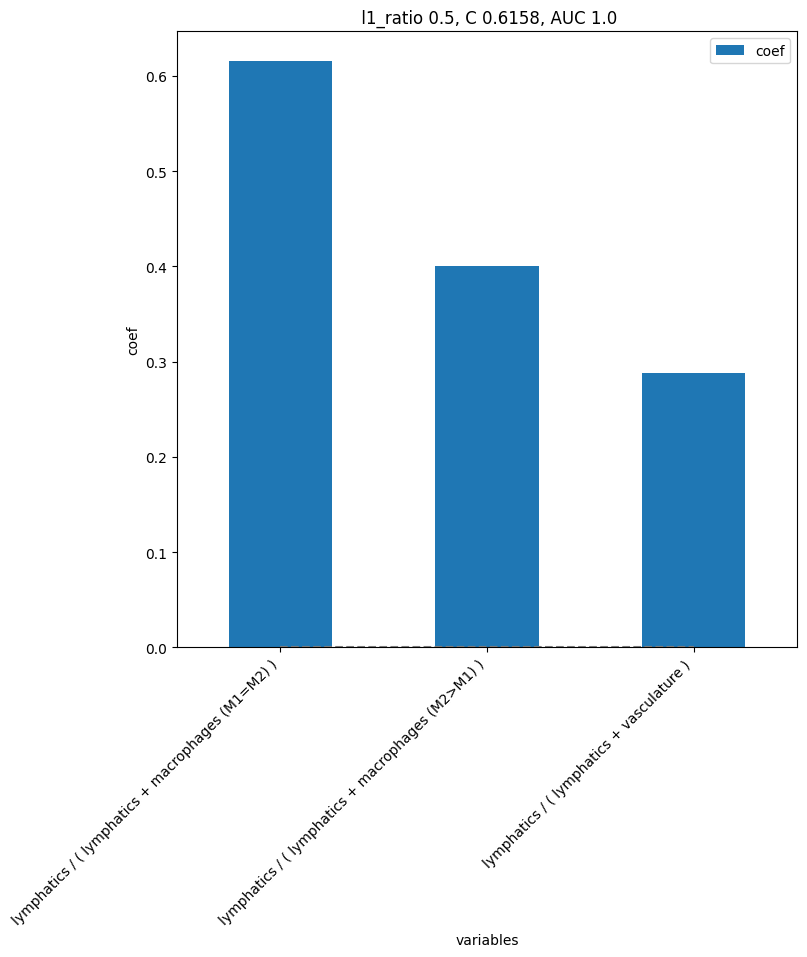

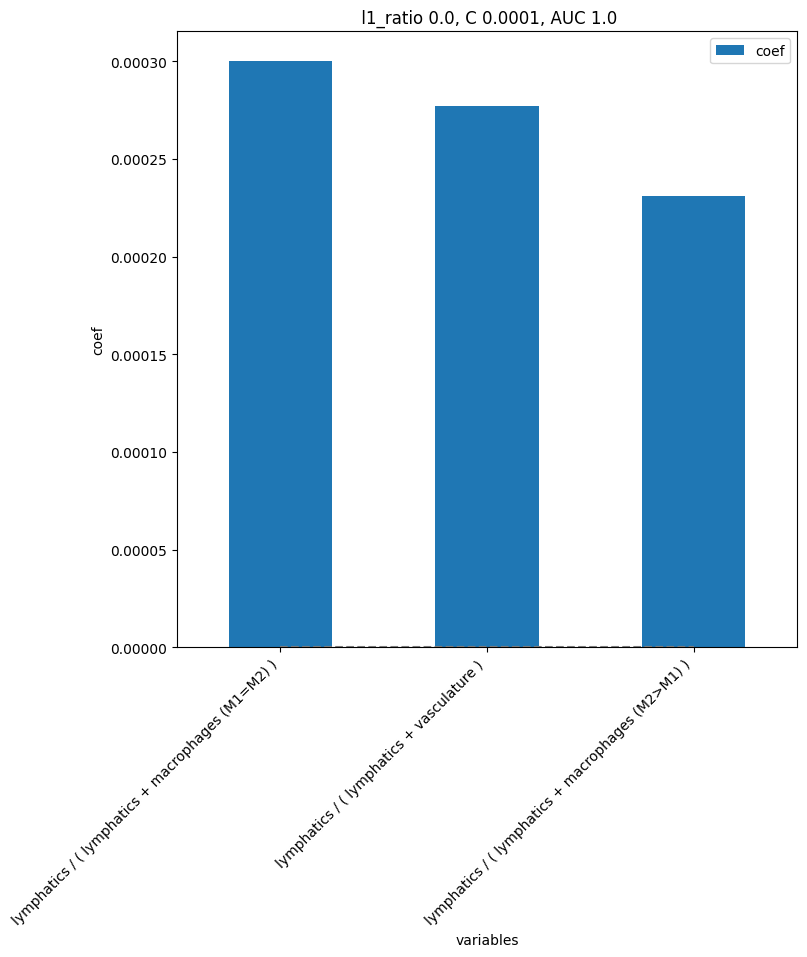

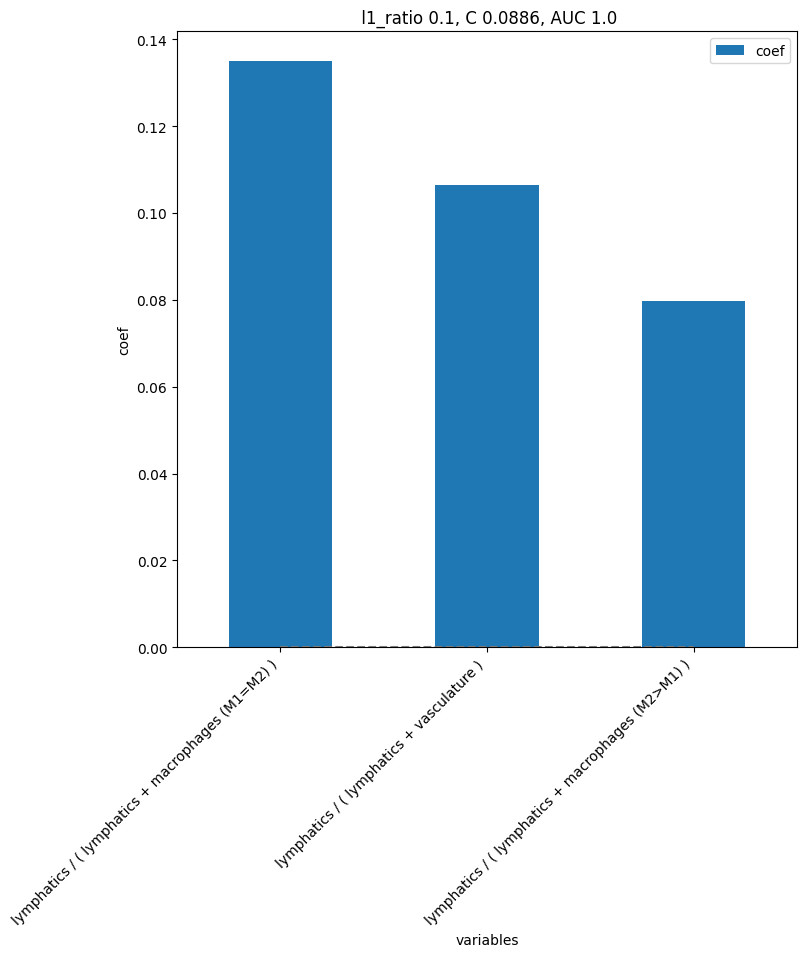

In [68]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Second order of cell types ratios

In [72]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=2)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [73]:
pvals.head(20)

,pval,pval_corr
(lymphatics / macrophages (M2>M1)) / (mast cells / tumor cells),0.002331,0.615098
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.002331,0.615098
lymphatics / macrophages (M1=M2),0.004079,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.004662,0.615098
(lymphatics / macrophages (M2>M1)) / (stroma / tumor cells),0.006993,0.615098
(lymphatics / macrophages (M1>M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / stroma),0.011072,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / vasculature),0.011072,0.615098
(CD8+ T cells / Tregs) / (nerves / tumor cells),0.013986,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / vasculature),0.013986,0.615098


In [74]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected)')

There are 58 significant variables (non corrected)


The first variables related to cell types proportions are composed variables of the 2nd order (ratio of ratios), only `lymphatics / macrophages (M1=M2)` appear in the simpler composed variables, but all corrected pvalues are > 0.05. This is because mosna produced *a lot* of composed variables.

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

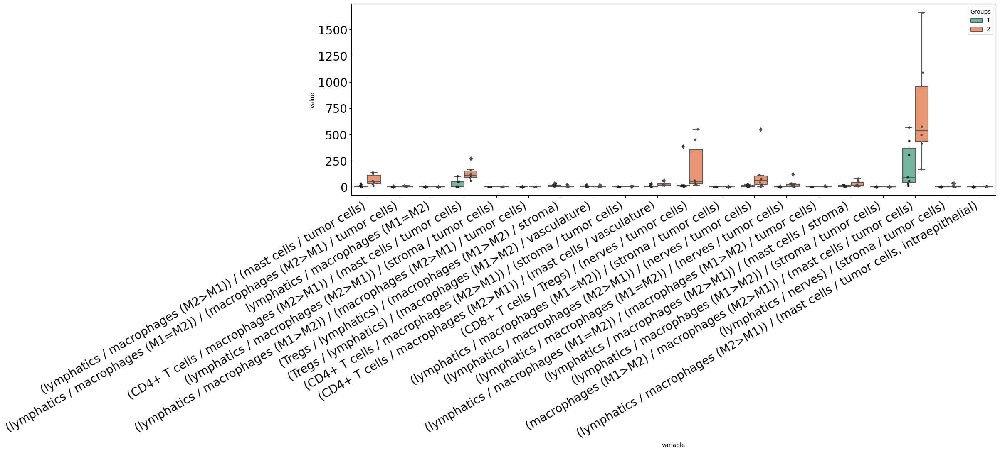

In [75]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

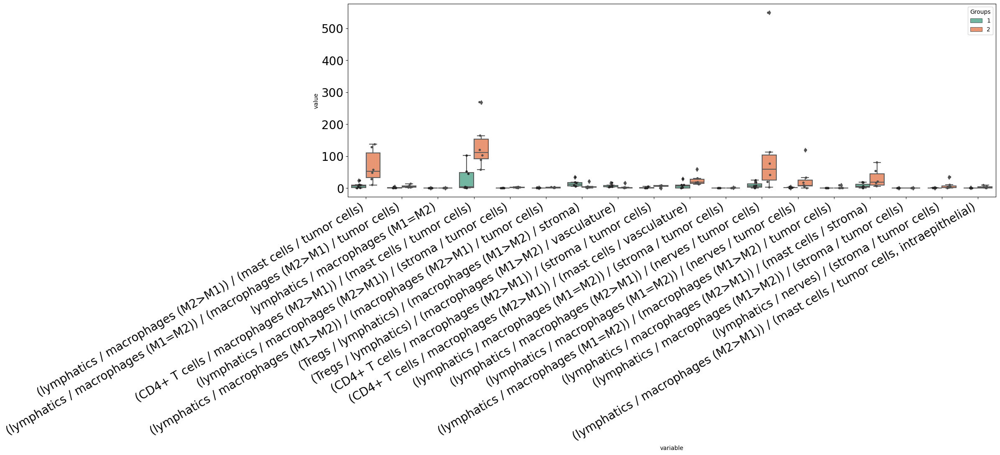

In [76]:
exclude_vars = [
    '(macrophages (M1>M2) / macrophages (M2>M1)) / (mast cells / tumor cells)',
    '(CD8+ T cells / Tregs) / (nerves / tumor cells)',
]
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    )

In [77]:
# we need to clean-up data for further analyses and visualizations
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 24017 non finite values (27.6%)
Imputing data


In [78]:
pvals = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [79]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected) after data imputation')

There are 260 significant variables (non corrected) after data imputation


In [80]:
pd.set_option('display.max_rows', None)
pvals.head(20)

,pval,pval_corr
(CD8+ T cells / mast cells) / (plasma cells / tumor cells),0.002331,0.635998
(lymphatics / macrophages (M1=M2)) / (plasma cells / tumor cells),0.002331,0.635998
lymphatics / macrophages (M1=M2),0.004079,0.635998
(lymphatics / mast cells) / (plasma cells / tumor cells),0.004079,0.635998
(CD4+ T cells / mast cells) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / macrophages (M1=M2)) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / mast cells) / (neutrophils / tumor cells),0.006993,0.635998
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.635998
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.011072,0.635998
(macrophages (M1>M2) / mast cells) / (plasma cells / tumor cells),0.011072,0.635998


In [81]:
pd.set_option('display.max_rows', 10)

There are 260 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

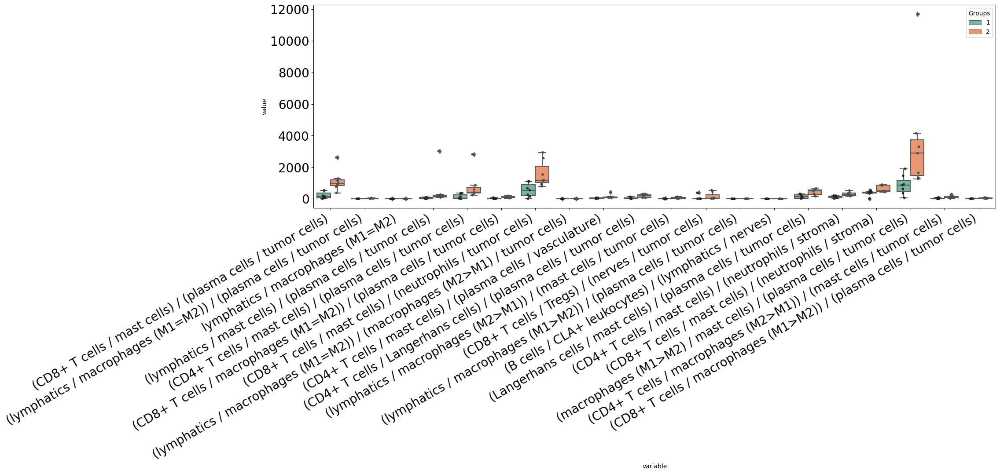

In [82]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

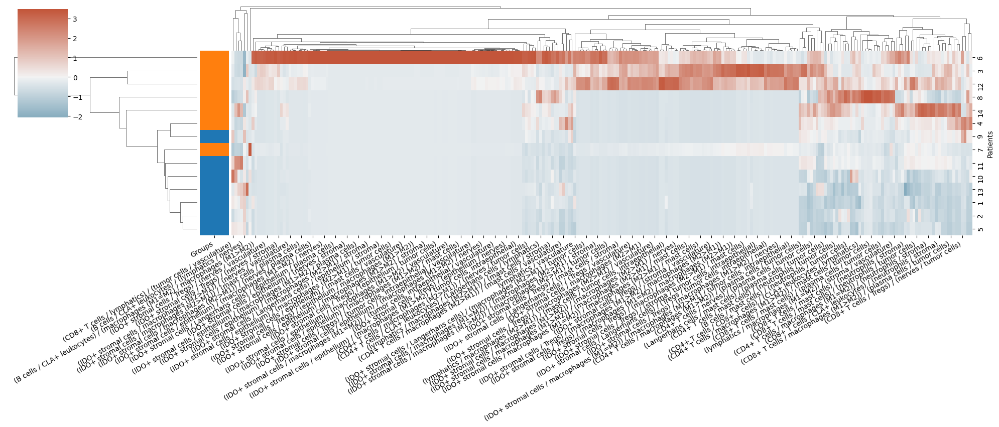

In [ ]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

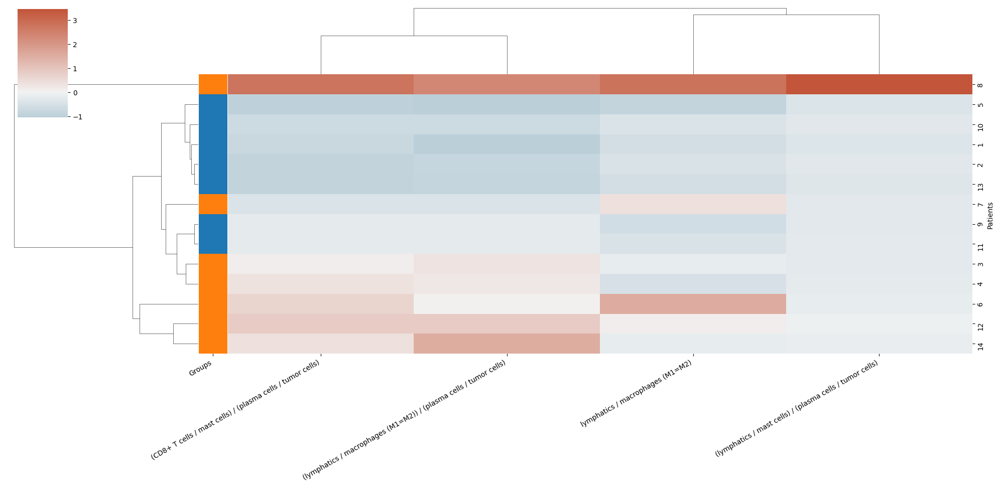

In [85]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(40).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

By selecting the variables with p-values under 5%, although their corresponding corrected p-values are not significant, we can notice a much better separation between patients groups.  
We must be careful though: we have computed a lot of composed variables, and selected those who happened to have the best p-values.

#### Stepwise logistic regression

In [86]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
model, included = mosna.stepwise_regression(X=prop_types_comp_cleaned, y_name=group_col, y_values=[1, 2], col_names=best_pval_names, verbose=True)

Add  (CD8+ T cells / macrophages (M1=M2)) / (plasma cells / tumor cells) with p-value 0.00290078
Add  lymphatics / macrophages (M1=M2) with p-value 0.00465832
Add  (macrophages (M1=M2) / macrophages (M1>M2)) / (tumor cells / vasculature) with p-value 0.0400989


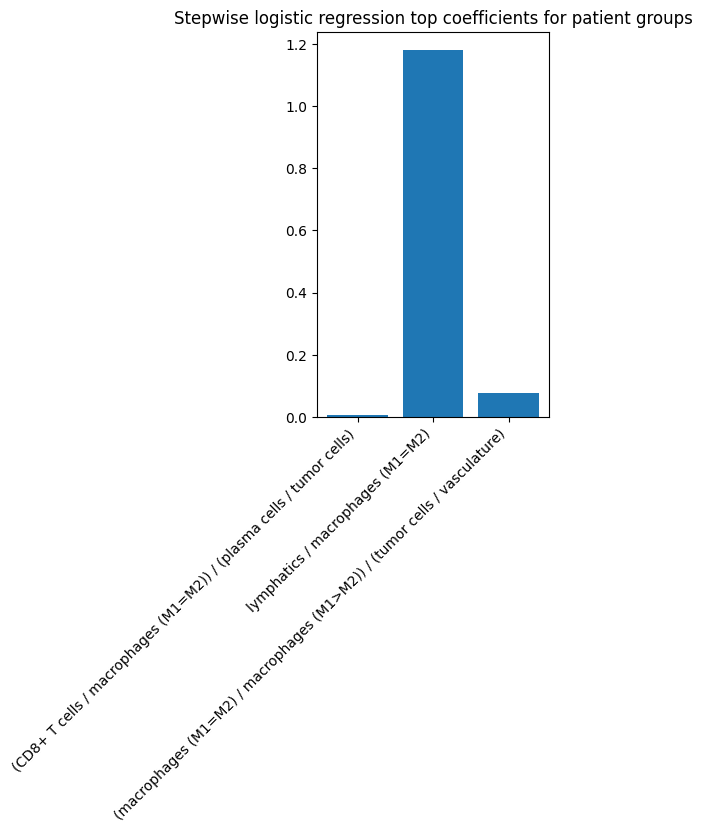

In [87]:
# plot the model's coefficients
coefs = model.params[1:] # skip intercept
nb_coefs = min(coefs.size, 20)
if nb_coefs > 0:
    fig, ax = plt.subplots(figsize=(nb_coefs,5))
    ax.bar(coefs.index, coefs)
    plt.xticks(rotation=45, ha='right');
    title = f"Stepwise logistic regression top coefficients for patient groups"
    plt.title(title)

Training took 3.398s


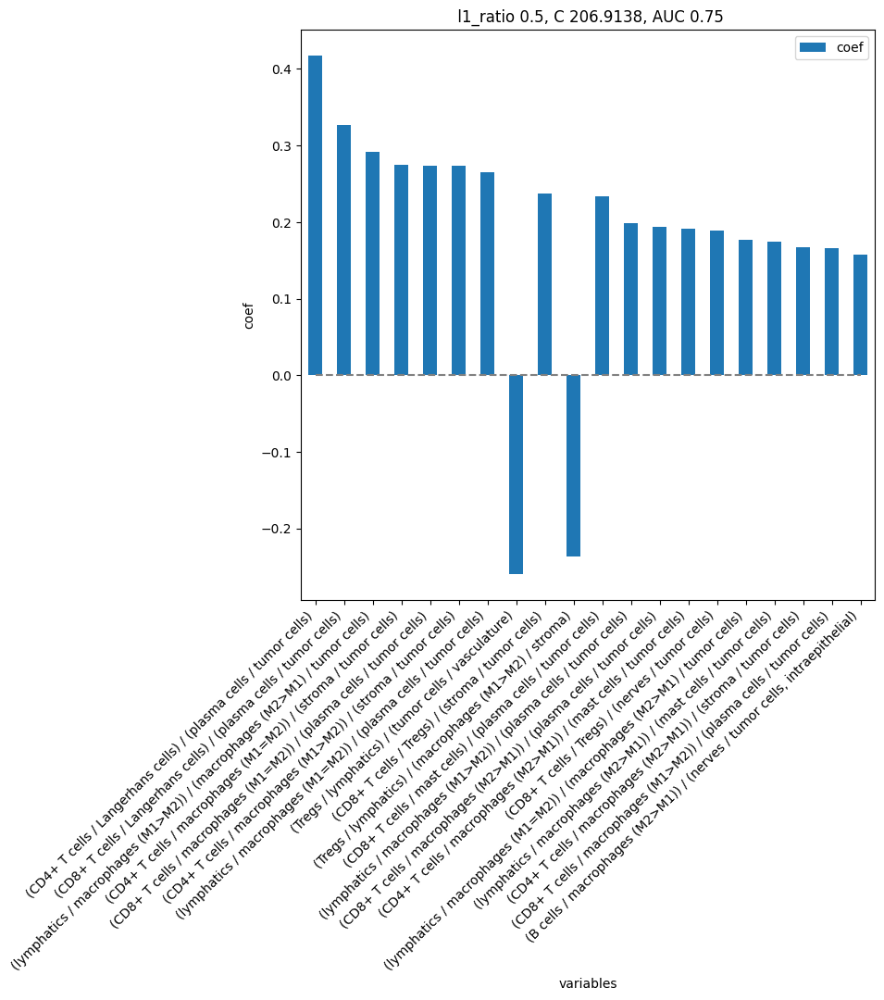

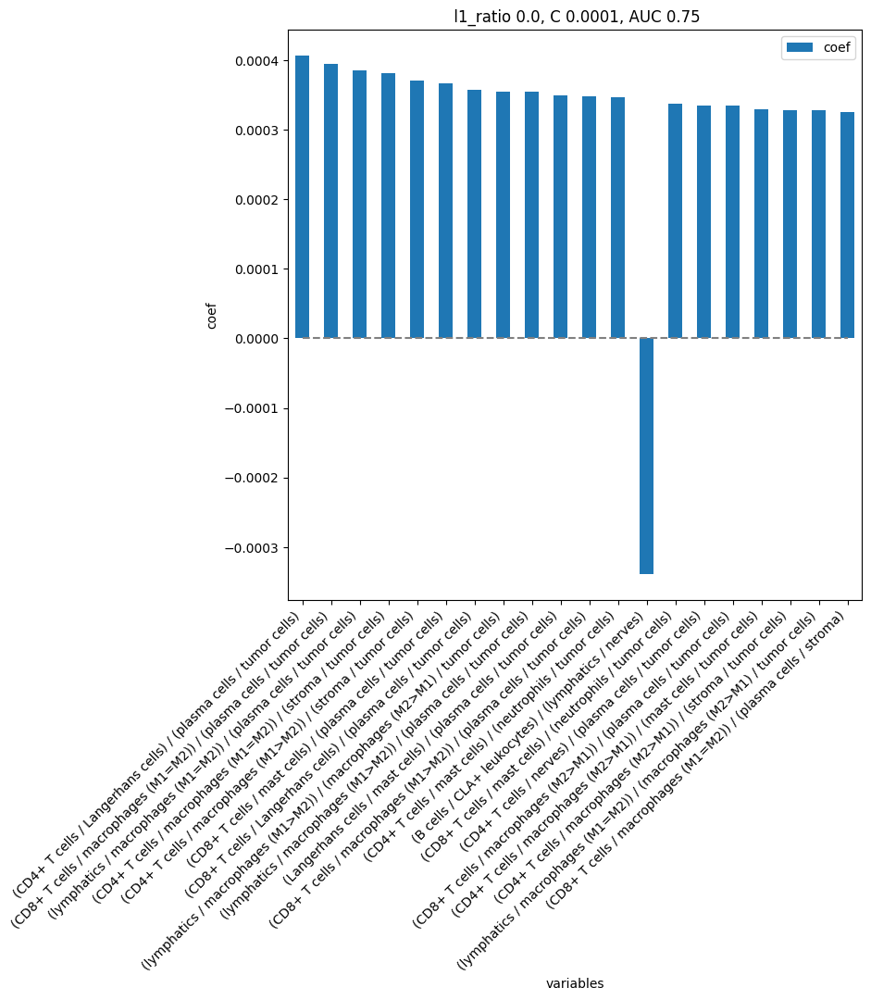

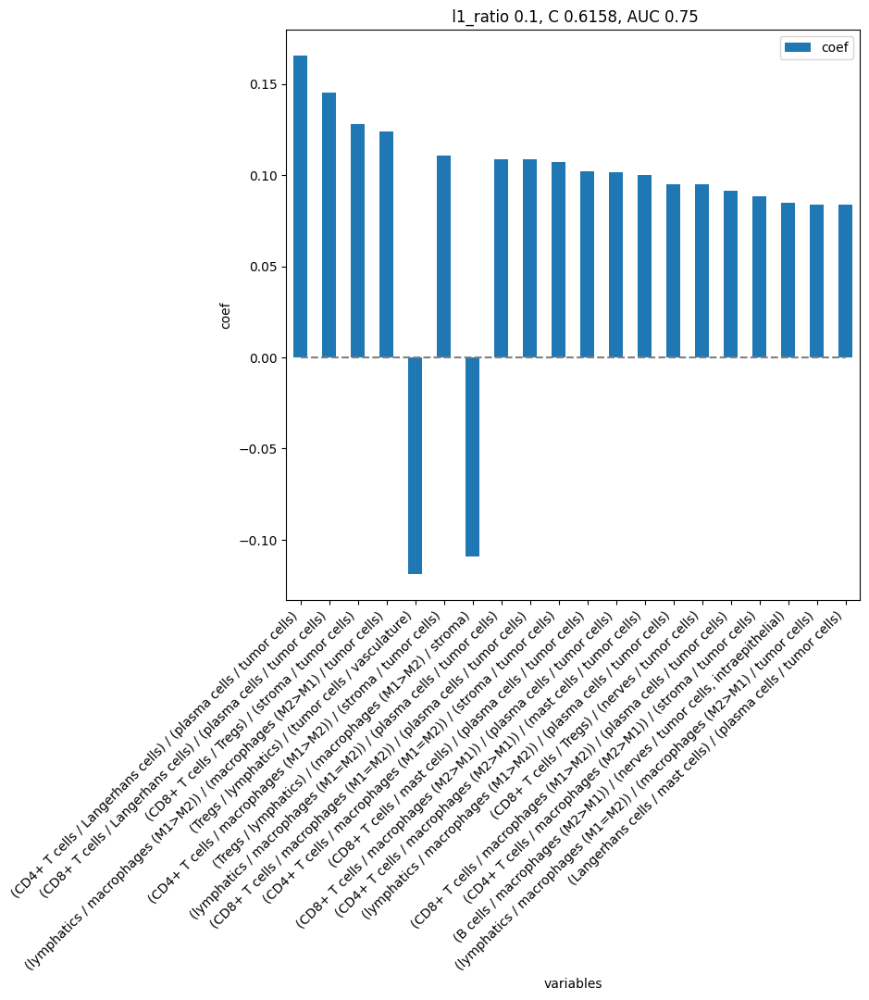

In [88]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [89]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index

In [90]:
model, included = mosna.stepwise_regression(X=prop_types_comp_cleaned, y_name=group_col, y_values=[1, 2], col_names=best_pval_names, verbose=True)

Add  (lymphatics / macrophages (M1=M2)) / (plasma cells / tumor cells) with p-value 0.00339158


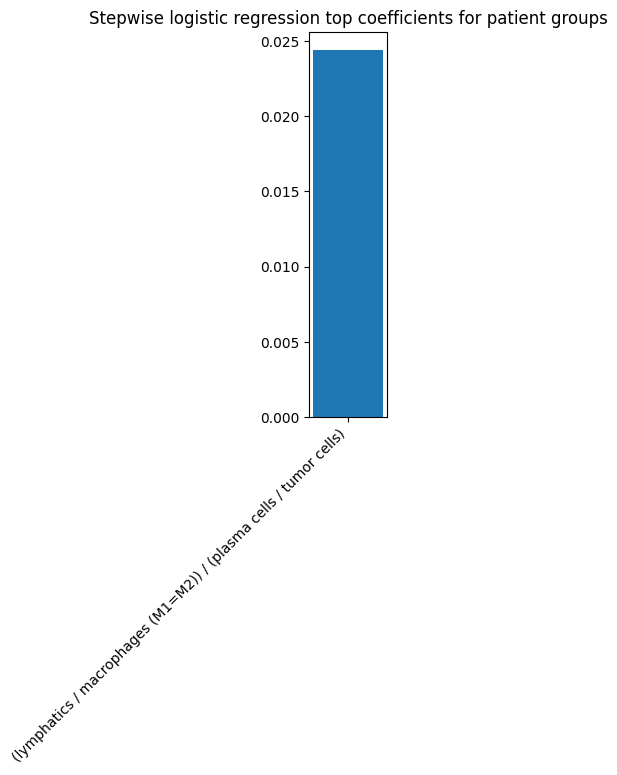

In [91]:
# plot the model's coefficients
coefs = model.params[1:] # skip intercept
nb_coefs = min(coefs.size, 20)
if nb_coefs > 0:
    fig, ax = plt.subplots(figsize=(nb_coefs,5))
    ax.bar(coefs.index, coefs)
    plt.xticks(rotation=45, ha='right');
    title = f"Stepwise logistic regression top coefficients for patient groups"
    plt.title(title)

Training took 2.348s


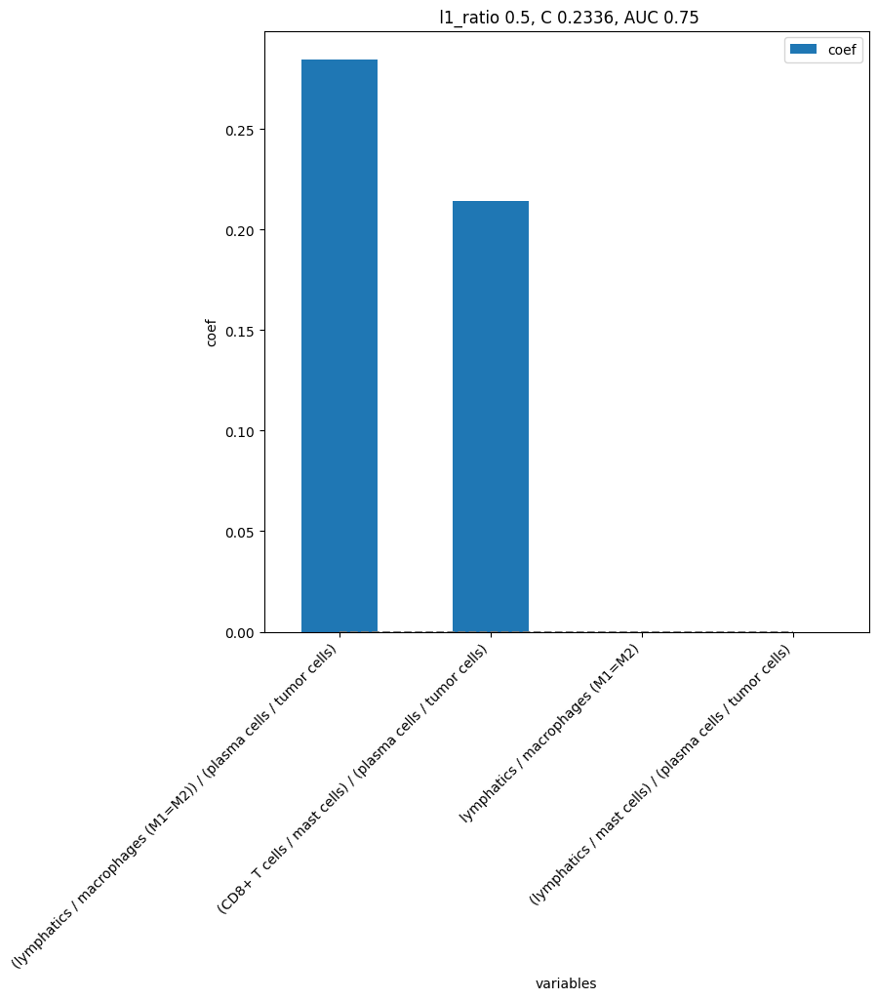

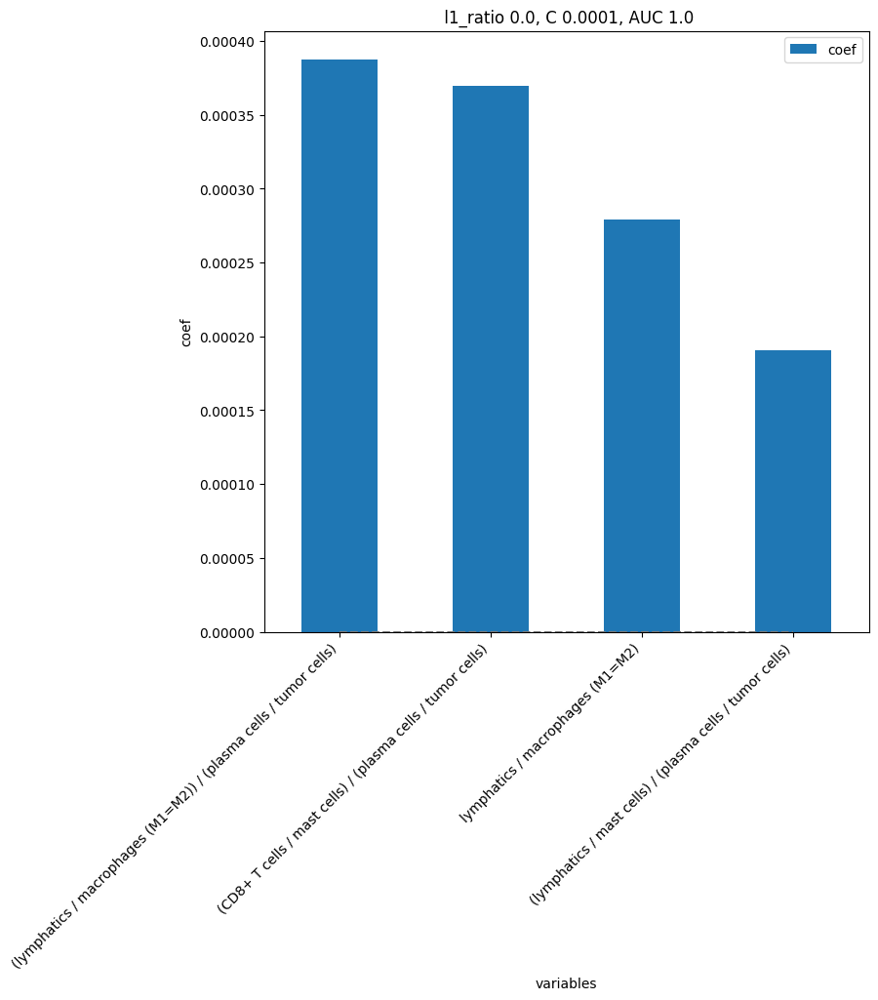

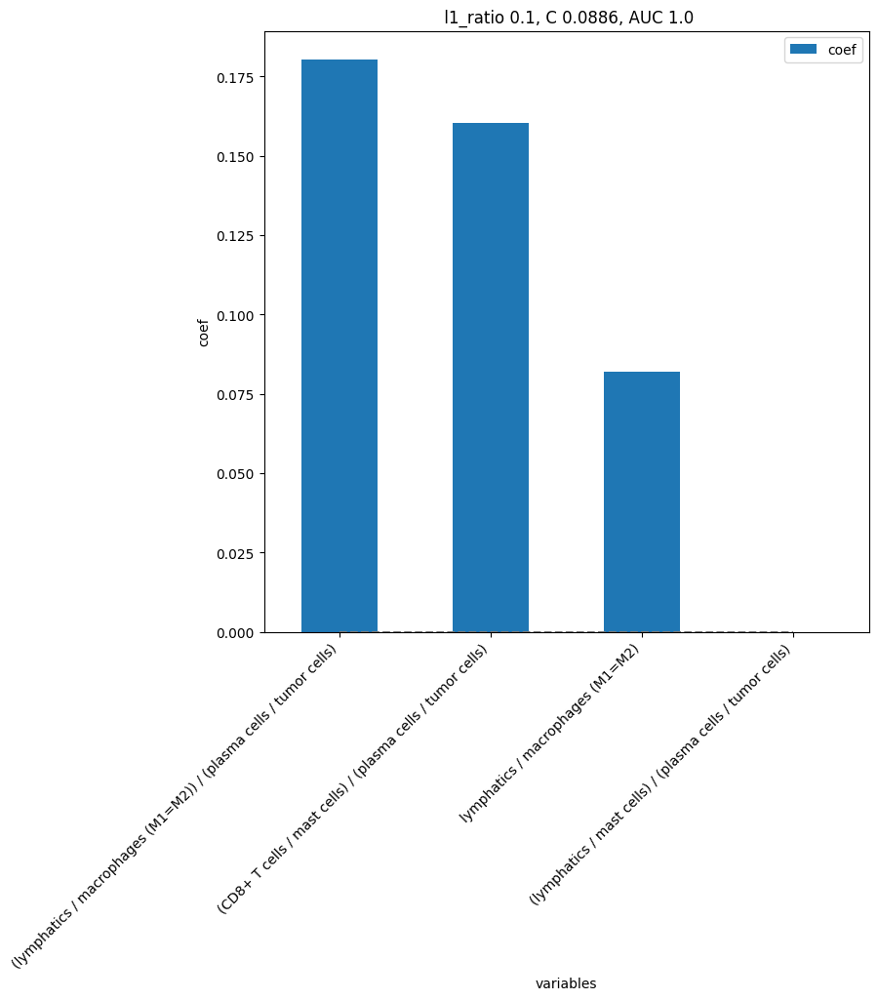

In [92]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Marker-positive cells proportions

In [93]:
def highlight_under(s, thresh=0.05, color='darkorange'):
    '''
    highlight values that are under a threshold
    '''
    is_under = s <= thresh
    attr = 'background-color: {}'.format(color)
    return [attr if v else '' for v in is_under]

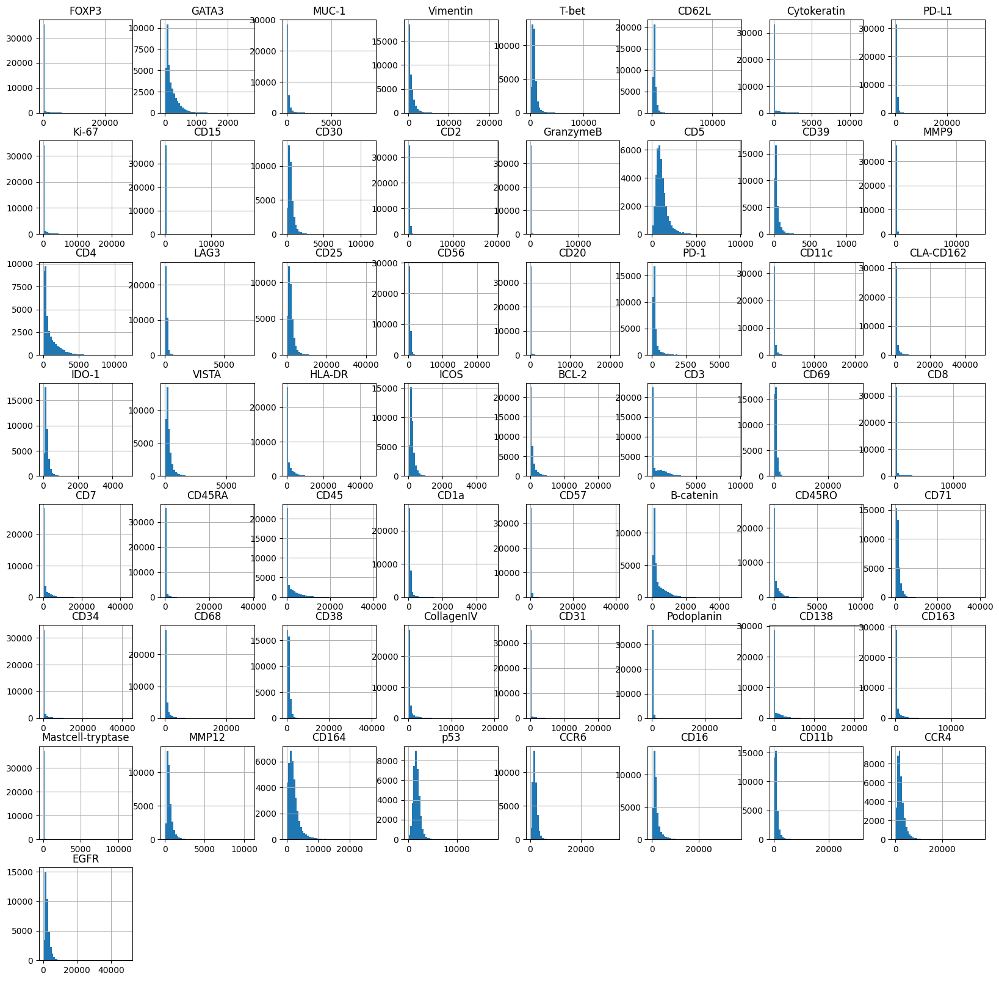

In [94]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

In [77]:
marker_thresh = {
    'FOXP3',
    'GATA3',
    'MUC-1',
    'Vimentin',
    'T-bet',
    'CD62L',
    'Cytokeratin',
    'PD-L1',
    'Ki-67',
    'CD15',
    'CD30',
    'CD2',
    'GranzymeB',
    'CD5',
    'CD39',
    'MMP9',
    'CD4',
    'LAG3',
    'CD25',
    'CD56',
    'CD20',
    'PD-1',
    'CD11c',
    'CLA-CD162',
    'IDO-1',
    'VISTA',
    'HLA-DR',
    'ICOS',
    'BCL-2',
    'CD3',
    'CD69',
    'CD8',
    'CD7',
    'CD45RA',
    'CD45',
    'CD1a',
    'CD57',
    'B-catenin',
    'CD45RO',
    'CD71',
    'CD34',
    'CD68',
    'CD38',
    'CollagenIV',
    'CD31',
    'Podoplanin',
    'CD138',
    'CD163',
    'Mastcell-tryptase',
    'MMP12',
    'CD164',
    'p53',
    'CCR6',
    'CD16',
    'CD11b',
    'CCR4',
    'EGFR'
}

In [78]:
# One needs to define a threshold for each marker, not done here.

We have seen that cell types proportions don't explain response of patient to therapy. But maybe interactions between cell types play a role in response?  
To answer this question we will look at the *mixing matrix* and *assortativity* of tissue networks.  

## Cell types interactions

We compute cell types interactions per sample to aggregate latter per patient or condition.

###  Assortativity and Mixing Matrix

#### Computation of assortativity

In [80]:
grouping = sample_col
n_shuffle = 500
load_dir = reconst_dir
save_dir = load_dir / "assortativity"
filename = save_dir / f'network_interactions_stats_grouping-{grouping}_n_shuffle-{n_shuffle}.csv'

if RUN_LONG or not filename.exists():
    print("Computing z-scored assortativity")
    start = time()
    net_stats = mosna.groups_assort_mixmat(
        net_dir=reconst_dir, 
        attributes_col=pheno_col, 
        make_onehot=False,
        id_level_1='patient',
        id_level_2='sample', 
        extension='parquet',
        n_shuffle=n_shuffle,
        parallel_groups='max',  # or False
        memory_limit='2 GB',
        save_intermediate_results=True)
    end = time()
    duration = end - start
    print(f"Assortativity took {duration:.3f}s for n_suffle {n_shuffle}")

    net_stats.index = net_stats['id']
    net_stats.drop(columns=['id'], inplace=True)

    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    net_stats.to_csv(filename)
else:
    print("Loading z-scored assortativity")
    net_stats = pd.read_csv(filename, index_col=0)

Loading z-scored assortativity


In [81]:
net_stats

,# total,% Langerhans cells,% lymphatics,% macrophages (M1=M2),% macrophages (M1>M2),% mast cells,% nerves,% stroma,% tumor cells,% vasculature,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-7_sample-reg026,257,0.003891,0.011673,0.031128,0.038911,0.019455,0.396887,0.381323,0.007782,0.108949,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-1_sample-reg002,2324,0.008606,0.003442,0.111446,0.158348,0.003012,0.010757,0.156196,0.242255,0.036575,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-6_sample-reg021,2483,0.017318,0.022956,0.050342,0.168747,0.003625,0.002014,0.130890,0.258558,0.039066,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-5_sample-reg018,458,0.004367,NaN,0.010917,0.013100,0.002183,0.004367,0.050218,0.004367,0.019651,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-2_sample-reg005,112,NaN,NaN,0.035714,0.035714,0.008929,NaN,0.419643,0.035714,0.392857,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-11_sample-reg042,385,0.007792,0.007792,0.070130,0.023377,0.062338,0.005195,0.420779,0.072727,0.272727,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg046,808,0.014851,0.011139,0.056931,0.129950,0.009901,0.003713,0.137376,0.230198,0.061881,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-13_sample-reg051,1082,0.021257,NaN,0.022181,0.073937,0.008318,0.002773,0.131238,0.174677,0.087800,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


I'm getting too many nans

#### Example of Mixing Matrix

In [48]:
sample_id = 'patient-1_sample-reg001'
raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
assort_raw = net_stats.loc[sample_id, "assort"]
assort_z = net_stats.loc[sample_id, "assort Z"]

# select_cols = np.logical_and(mixmat_raw.isna(axis=0) == 0, mixmat_z.isna(axis=0) == 0)

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


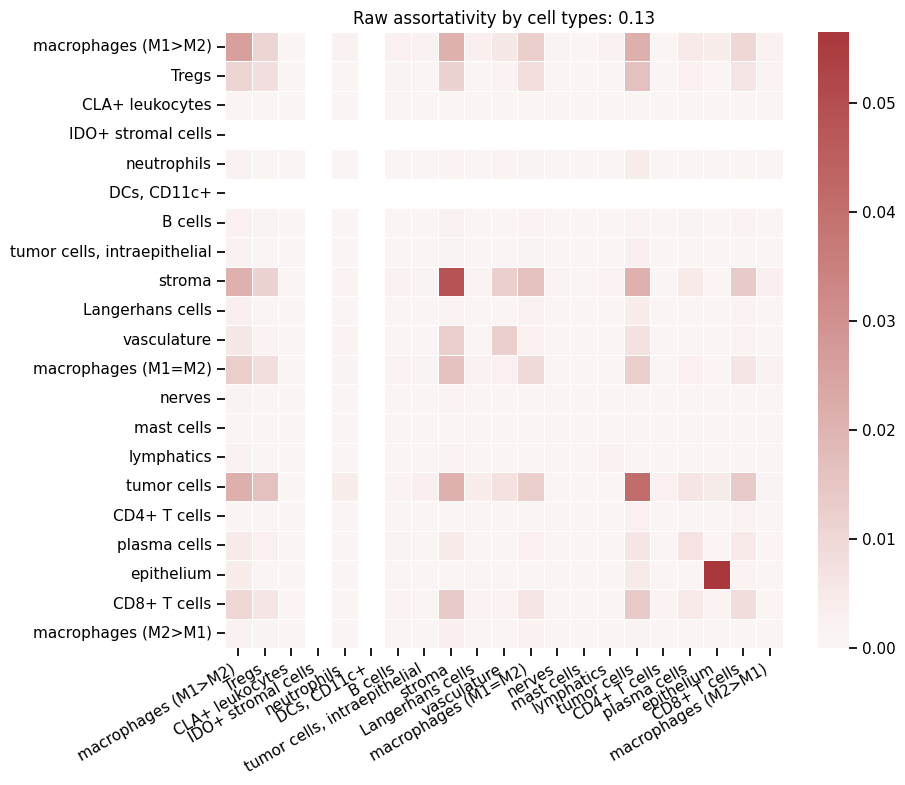

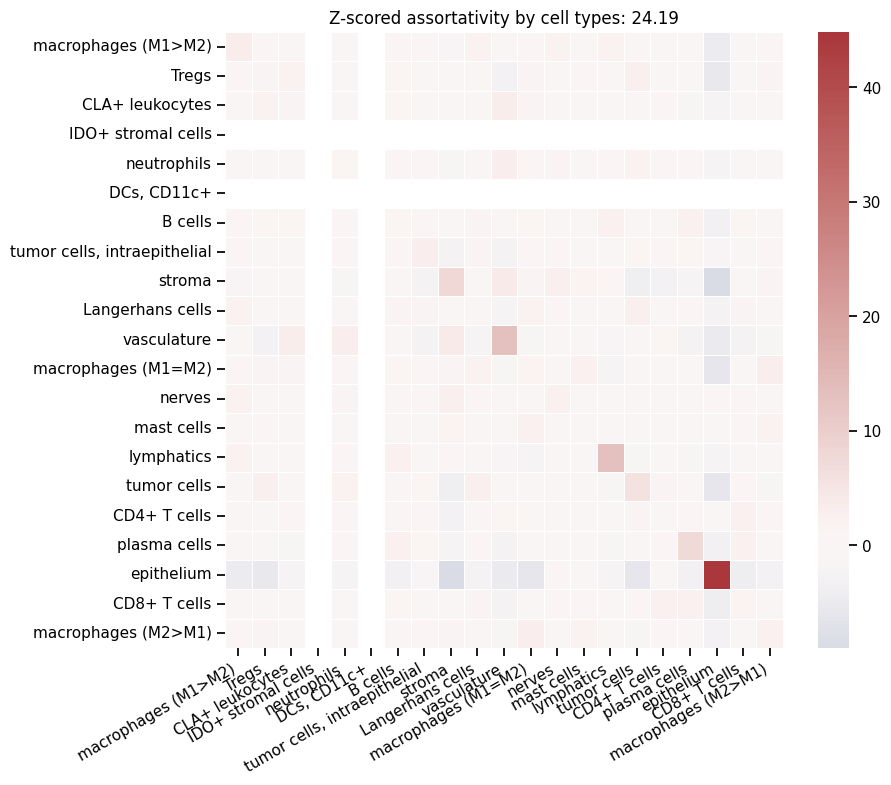

In [49]:
# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');
# plt.xticks(rotation=30, ha='right', fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}", bbox_inches='tight', facecolor='white')

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


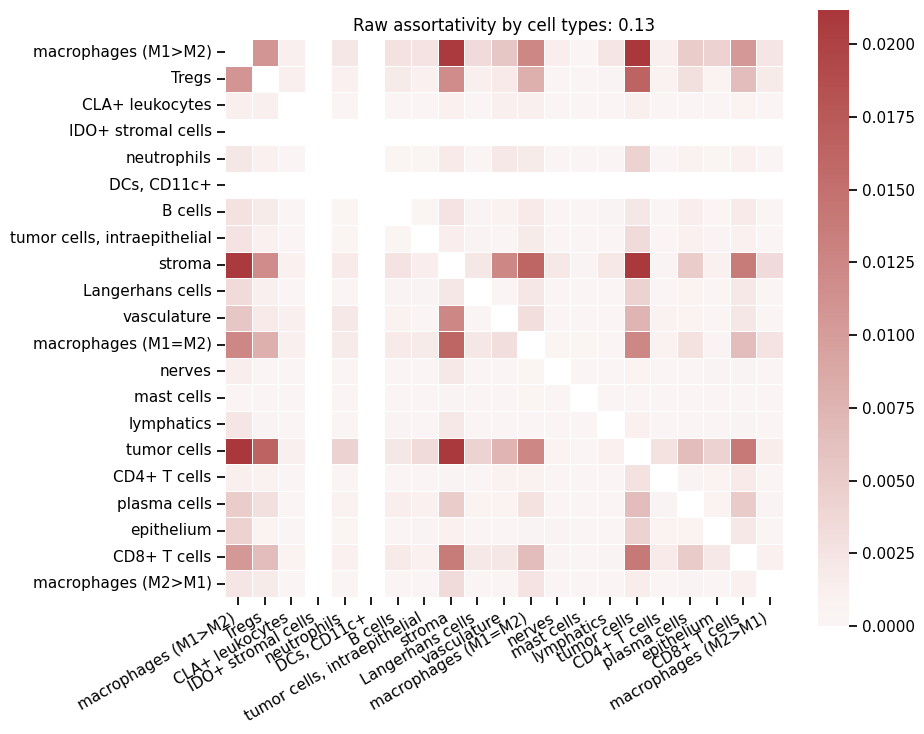

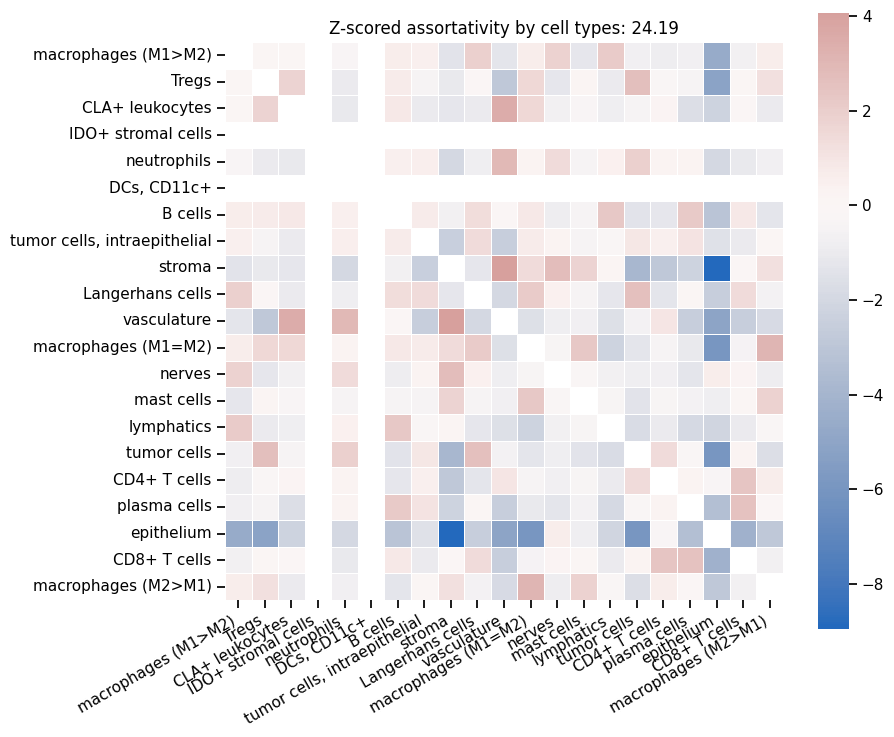

In [50]:
# Hide diagonal
# # Generate a mask for the upper triangle
# mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
# Generate a mask for the diagonal
mask = np.eye(mixmat_raw.shape[0], dtype=bool)

# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');#, fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

In [82]:
if RUN_LONG:
    for sample_id in net_stats.index:

        raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
        z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

        mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
        mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
        assort_raw = net_stats.loc[sample_id, "assort"]
        assort_z = net_stats.loc[sample_id, "assort Z"]

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');
        # plt.xticks(rotation=30, ha='right', fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}", bbox_inches='tight', facecolor='white')

        # Hide diagonal
        # # Generate a mask for the upper triangle
        # mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
        # Generate a mask for the diagonal
        mask = np.eye(mixmat_raw.shape[0], dtype=bool)

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');#, fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

After removing highly self-assortative cell-types, we can notice that ~~most cell types tend to avoid other cell types in this sample.~~

#### Assortativity and patients response

In [83]:
z_cols = [x for x in net_stats.columns if x.endswith('Z')]
z_net_stats = net_stats[z_cols]

In [84]:
z_net_stats

,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,macrophages (M1>M2) - lymphatics Z,macrophages (M1>M2) - macrophages (M1=M2) Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-7_sample-reg026,13.344075,NaN,4.358899,7.167053,-0.400116,-0.690587,0.802846,1.967370,0.597063,0.442729,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-1_sample-reg002,12.379904,0.808659,-0.617620,28.984539,-0.662931,-0.888859,0.452411,-1.363191,-0.789424,0.047497,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-6_sample-reg021,15.761557,2.541098,0.966339,27.967320,-1.237586,-0.548147,2.922795,2.410674,-1.540631,2.174551,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-5_sample-reg018,19.995641,-0.100504,NaN,NaN,-0.318615,NaN,8.362145,-0.336913,NaN,2.860488,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-2_sample-reg005,3.043484,NaN,NaN,NaN,NaN,NaN,-0.521421,NaN,NaN,0.379319,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-11_sample-reg042,8.247755,4.898979,-0.394086,4.453463,-0.063622,-0.020417,2.887114,-0.552247,-0.530589,0.608287,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg046,23.398796,5.569688,-0.861886,15.175724,-0.942157,-1.113342,1.626789,-1.952067,-1.328829,0.382677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-13_sample-reg051,45.689836,2.660568,NaN,NaN,4.175846,NaN,1.340313,2.463355,NaN,1.235106,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [85]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
Langerhans cells - Langerhans cells Z                 4
lymphatics - Langerhans cells Z                       7
lymphatics - lymphatics Z                             7
macrophages (M1=M2) - Langerhans cells Z              2
macrophages (M1=M2) - lymphatics Z                    7
macrophages (M1=M2) - macrophages (M1=M2) Z           1
macrophages (M1>M2) - Langerhans cells Z              2
macrophages (M1>M2) - lymphatics Z                    7
macrophages (M1>M2) - macrophages (M1=M2) Z           0
macrophages (M1>M2) - macrophages (M1>M2) Z           0
mast cells - Langerhans cells Z                       4
mast cells - lymphatics Z                             9
mast cells - macrophages (M1=M2) Z                    3
mast cells - macrophages (M1>M2) Z                    3
mast cells - mast cells Z                             7
nerves - Langerhans cells Z                           3
nerves - lymphatics Z                           

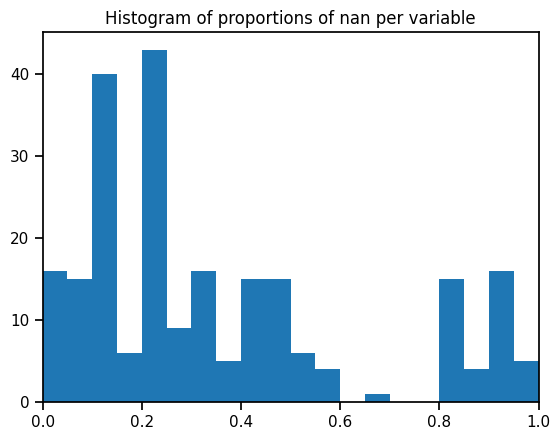

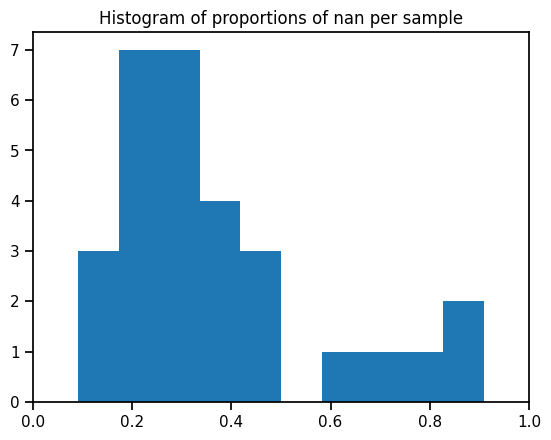

In [86]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

There are some nan values due to interactions between rare cell types that never happened.  
We can have a first look at the sample, but it would be more informative to have a look at samples before therapy, grouping them per patient.

Before dropping variables z_net_stats shape: (29, 231)
There are 2373 non finite values (35.4%)
Final z_net_stats shape: (29, 150)
There are 81 variables discarded


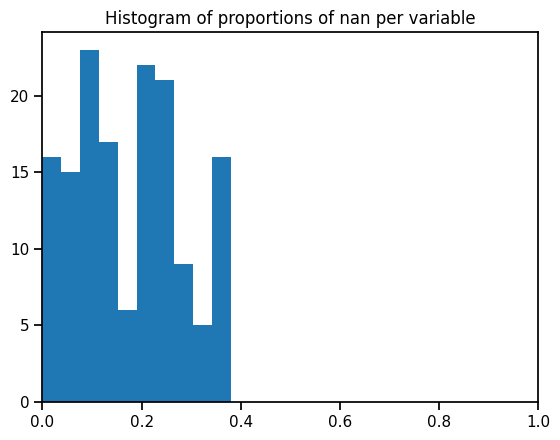

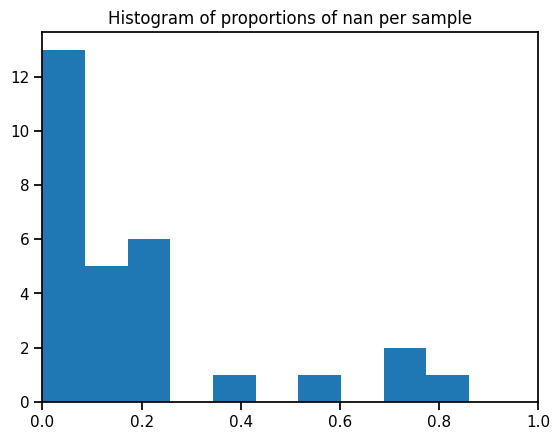

In [87]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (29, 150)
There are 760 non finite values (17.5%)
Final z_net_stats shape: (25, 150)
There are 4 observations discarded


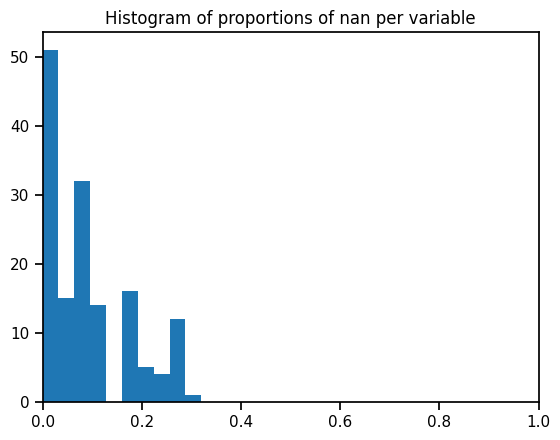

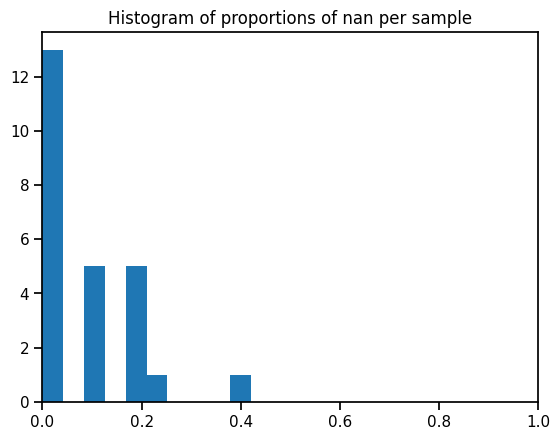

In [88]:
print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [89]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 326 non finite values (8.7%)
Imputing data
Final z_net_stats shape: (25, 150)


In [90]:
# Add back patient id to the network stats dataframe
def parse_patient(s):
    return s.split('_')[0][8:]

# if patient_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[patient_col] = [parse_patient(s) for s in z_net_stats_cleaned.index]

# Add back sample id to the network stats dataframe
def parse_sample(s):
    return s.split('_')[1][7:]

# if sample_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[sample_col] = [parse_sample(s) for s in z_net_stats_cleaned.index]
# z_net_stats_cleaned.index = z_net_stats_cleaned[sample_col]

z_net_stats_cleaned.index = [parse_sample(s) for s in z_net_stats_cleaned.index]
z_net_stats_cleaned.index.name = sample_col


In [91]:
z_net_stats_cleaned

,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,macrophages (M1>M2) - lymphatics Z,macrophages (M1>M2) - macrophages (M1=M2) Z,...,"tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - B cells Z,vasculature - CD4+ T cells Z,vasculature - CD8+ T cells Z,vasculature - Tregs Z,vasculature - epithelium Z,vasculature - macrophages (M2>M1) Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg002,12.379904,0.808659,-0.617620,28.984539,-0.662931,-0.888859,0.452411,-1.363191,-0.789424,0.047497,...,1.153567,0.314647,-1.620119,-1.479601,-1.859212,-3.962437,-1.193311,-3.223470,-0.805019,-1.460195
reg021,15.761557,2.541098,0.966339,27.967320,-1.237586,-0.548147,2.922795,2.410674,-1.540631,2.174551,...,3.213455,-0.370250,-2.860106,-3.928384,-5.886756,-4.185167,0.430392,-2.387798,-1.786568,-1.661358
reg039,39.367081,-0.238919,-0.749683,17.082528,0.778290,-1.624094,2.121213,1.777215,-1.534278,3.823251,...,-0.600441,3.076579,-1.568717,-0.271168,0.175507,-1.357383,-14.982135,-1.572547,0.636875,0.595943
reg058,47.697650,3.820886,1.441500,20.951475,0.001683,2.894857,3.380146,2.890365,0.279414,2.947306,...,1.187869,-0.238919,1.589135,3.437713,0.113627,-3.573969,-11.978520,-1.908044,-0.790011,-1.377108
reg035,53.465659,-0.325935,0.025787,11.424864,-0.806287,0.214490,2.138343,-1.323744,1.031071,2.719885,...,1.274220,-0.408593,-0.506053,0.210665,0.757829,0.241929,-18.899147,2.152032,0.029092,-1.755144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg042,8.247755,4.898979,-0.394086,4.453463,-0.063622,-0.020417,2.887114,-0.552247,-0.530589,0.608287,...,-0.924298,-0.100504,-1.193870,0.415666,0.225880,-0.632024,-1.179484,-1.939630,-1.124196,-1.824518
reg046,23.398796,5.569688,-0.861886,15.175724,-0.942157,-1.113342,1.626789,-1.952067,-1.328829,0.382677,...,-1.621342,-0.012179,2.308891,0.408548,0.686651,-1.841824,-7.172598,-1.480855,-0.300474,0.704778
reg051,45.689836,2.660568,-0.465422,14.364944,4.175846,-0.660600,1.340313,2.463355,0.743724,1.235106,...,-1.710073,12.930318,-0.948478,-0.853378,-0.068100,-1.427852,-16.480729,1.455278,1.007051,-2.000002


Let's add information about patients' group and time of biopsy

In [92]:
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'
if 'Count' in status.columns:
    status = status.drop(columns=['Count'])
# status.sort_values('Spots')
status

,Patients,Groups,Spots
id,,,
reg001,1,1,1
reg002,1,1,2
reg005,2,1,5
reg006,2,1,6
reg009,3,2,9
...,...,...,...
reg046,12,2,46
reg051,13,1,51
reg052,13,1,52


In [93]:
# pd.set_option('display.max_rows', 10)
# reg026 and reg044 not in biopsies
z_net_stats_cleaned = pd.concat([status, z_net_stats_cleaned], axis=1, join='inner')#.sort_values('Spots')
z_net_stats_cleaned.drop(columns=['Spots'], inplace=True)
z_net_stats_cleaned.index.name = sample_col
z_net_stats_cleaned

,Patients,Groups,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,...,"tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - B cells Z,vasculature - CD4+ T cells Z,vasculature - CD8+ T cells Z,vasculature - Tregs Z,vasculature - epithelium Z,vasculature - macrophages (M2>M1) Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,0.064685,-1.204341,13.084341,2.130628,-2.278864,1.724607,1.919980,...,0.956805,2.924093,-0.053861,0.978381,-2.572324,-2.928686,-5.059101,-1.866915,-2.501314,-2.493605
reg002,1,1,12.379904,0.808659,-0.617620,28.984539,-0.662931,-0.888859,0.452411,-1.363191,...,1.153567,0.314647,-1.620119,-1.479601,-1.859212,-3.962437,-1.193311,-3.223470,-0.805019,-1.460195
reg006,2,1,15.343623,-0.822662,-0.701849,13.168209,0.198415,-0.899198,1.762285,1.320380,...,0.291703,-0.044766,1.913030,1.523492,-1.503655,-0.614116,1.721969,-2.610209,-0.569737,-0.998532
reg009,3,2,51.712912,2.640220,1.667876,9.131471,1.312624,3.134758,7.702667,3.821567,...,-0.088305,1.044084,-0.363300,-0.194533,0.082381,2.364643,-8.688610,-1.223229,-0.526157,-2.004947
reg010,3,2,52.830785,0.175189,0.408794,29.602263,-1.031822,0.345961,1.832072,2.172986,...,0.419101,4.894248,-0.690999,2.731313,-0.582251,2.137763,-11.914736,-1.807364,0.622160,0.823554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,12,2,23.398796,5.569688,-0.861886,15.175724,-0.942157,-1.113342,1.626789,-1.952067,...,-1.621342,-0.012179,2.308891,0.408548,0.686651,-1.841824,-7.172598,-1.480855,-0.300474,0.704778
reg051,13,1,45.689836,2.660568,-0.465422,14.364944,4.175846,-0.660600,1.340313,2.463355,...,-1.710073,12.930318,-0.948478,-0.853378,-0.068100,-1.427852,-16.480729,1.455278,1.007051,-2.000002
reg052,13,1,47.704148,5.307921,0.972203,7.842194,3.787816,-0.722978,3.343262,3.795563,...,-0.711130,-0.368761,1.489903,3.136896,1.028965,0.761823,-12.058906,2.079811,-0.383893,0.352221


In [94]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.drop(columns=[patient_col]), group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [95]:
pd.set_option('display.max_rows', None)
pvals.loc[pvals['pval'] < 0.05, :]

,pval,pval_corr
vasculature - vasculature Z,0.000999,0.149872
lymphatics - B cells Z,0.008338,0.625378
nerves - CD4+ T cells Z,0.023989,0.897791
"tumor cells, intraepithelial - B cells Z",0.047107,0.897791
macrophages (M1=M2) - lymphatics Z,0.047107,0.897791


In [96]:
pd.set_option('display.max_rows', 10)

There are 5 significant variables in `pval`


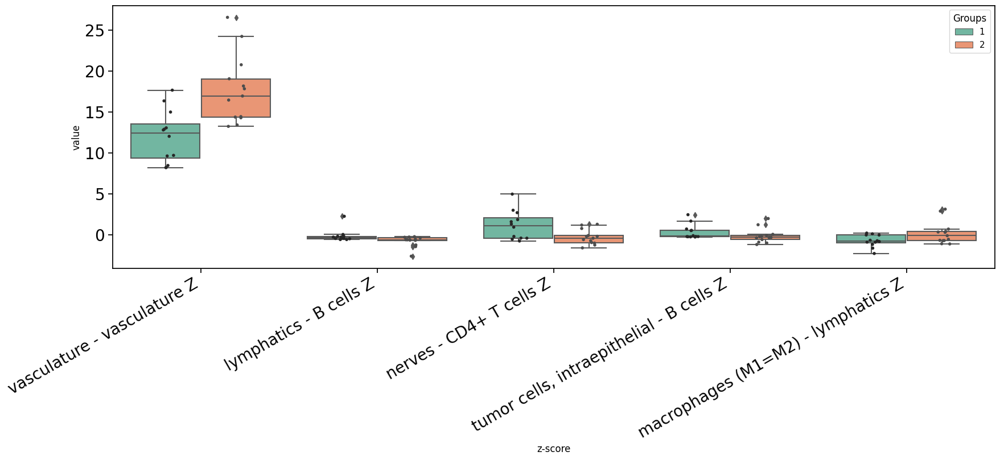

In [97]:
reload(mosna)
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 5 significant variables in `pval`


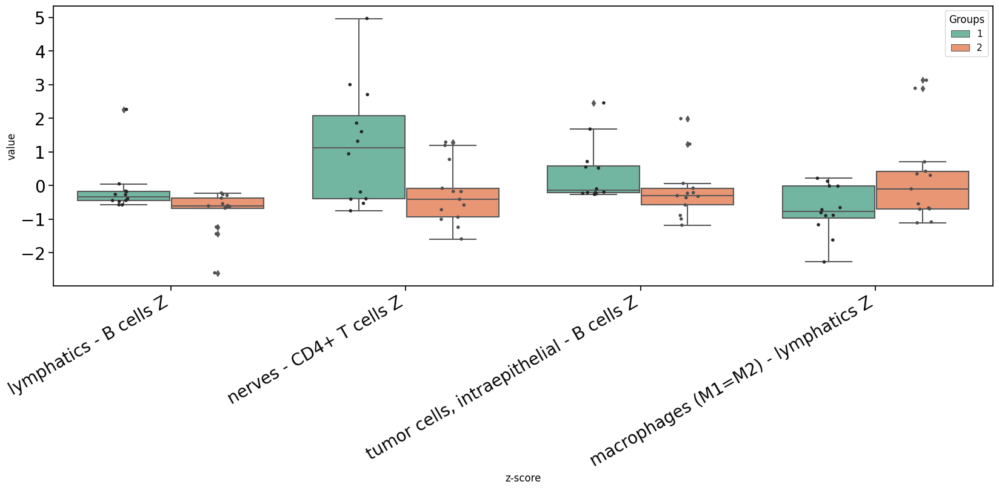

In [98]:
exclude_vars = [
    # 'assort Z',
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'tumor cells - tumor cells Z',
]
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    exclude_vars=exclude_vars,
    )

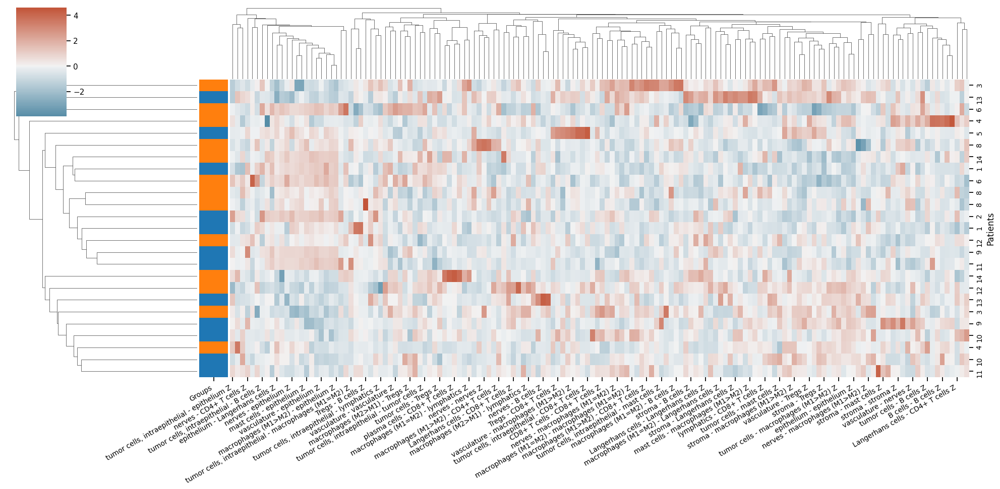

In [99]:
mosna.plot_heatmap(
    z_net_stats_cleaned, 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=1,
    )

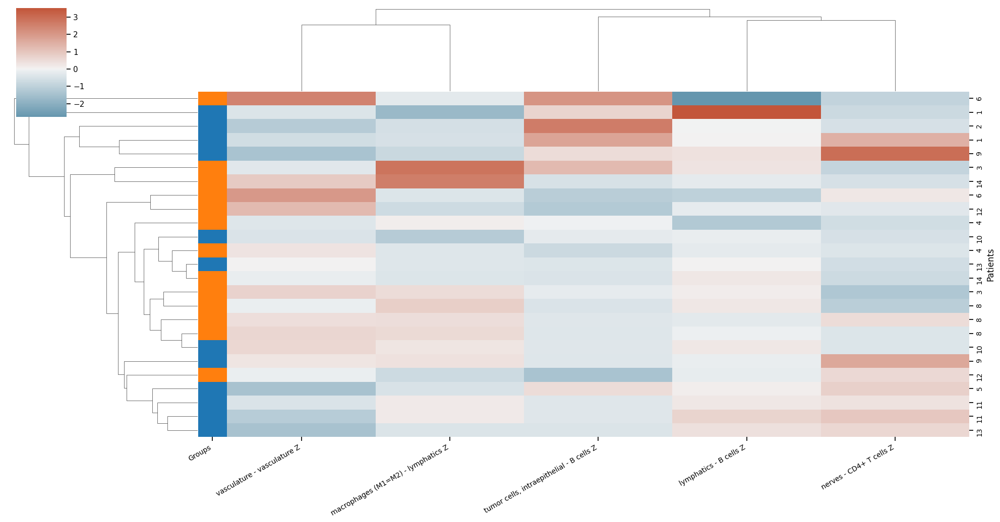

In [100]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names+[patient_col, group_col]], 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=1,
    )

Samples are a bit clustered into consistent response groups, but it's not incredible.  
We also need to aggregate samples per patient and time of biopsy, that may help us correcting nan values and have more variables, and hopefully better clusters.

Add  vasculature - vasculature Z    with p-value 0.000936515
Add  plasma cells - macrophages (M2>M1) Z with p-value 0.00738462
Add  nerves - lymphatics Z          with p-value 0.0134141
Add  CD4+ T cells - B cells Z       with p-value 0.0381359
Add  nerves - nerves Z              with p-value 0.0294015
Add  nerves - mast cells Z          with p-value 0.0444677
Add  tumor cells, intraepithelial - nerves Z with p-value 0.0328883
Add  macrophages (M1>M2) - Langerhans cells Z with p-value 0.00242144
Add  macrophages (M1=M2) - lymphatics Z with p-value 0.0174235
Add  plasma cells - Tregs Z         with p-value 0.00151102
Add  plasma cells - macrophages (M1>M2) Z with p-value 0.00203987
Add  stroma - stroma Z              with p-value 0.00588139
Add  vasculature - lymphatics Z     with p-value 0.0200843
Add  tumor cells, intraepithelial - mast cells Z with p-value 0.0310926
Add  Tregs - Langerhans cells Z     with p-value 0.0303868
Add  B cells - B cells Z            with p-value 0.00883024


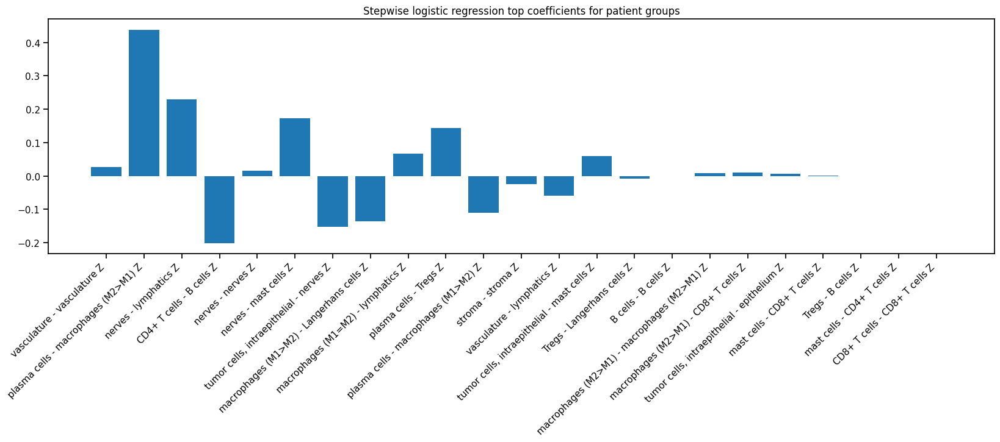

In [103]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=z_net_stats_cleaned, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no interaction statistically related to response group")

In [104]:
z_net_stats_cleaned

,Patients,Groups,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,...,"tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - B cells Z,vasculature - CD4+ T cells Z,vasculature - CD8+ T cells Z,vasculature - Tregs Z,vasculature - epithelium Z,vasculature - macrophages (M2>M1) Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,0.064685,-1.204341,13.084341,2.130628,-2.278864,1.724607,1.919980,...,0.956805,2.924093,-0.053861,0.978381,-2.572324,-2.928686,-5.059101,-1.866915,-2.501314,-2.493605
reg002,1,1,12.379904,0.808659,-0.617620,28.984539,-0.662931,-0.888859,0.452411,-1.363191,...,1.153567,0.314647,-1.620119,-1.479601,-1.859212,-3.962437,-1.193311,-3.223470,-0.805019,-1.460195
reg006,2,1,15.343623,-0.822662,-0.701849,13.168209,0.198415,-0.899198,1.762285,1.320380,...,0.291703,-0.044766,1.913030,1.523492,-1.503655,-0.614116,1.721969,-2.610209,-0.569737,-0.998532
reg009,3,2,51.712912,2.640220,1.667876,9.131471,1.312624,3.134758,7.702667,3.821567,...,-0.088305,1.044084,-0.363300,-0.194533,0.082381,2.364643,-8.688610,-1.223229,-0.526157,-2.004947
reg010,3,2,52.830785,0.175189,0.408794,29.602263,-1.031822,0.345961,1.832072,2.172986,...,0.419101,4.894248,-0.690999,2.731313,-0.582251,2.137763,-11.914736,-1.807364,0.622160,0.823554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,12,2,23.398796,5.569688,-0.861886,15.175724,-0.942157,-1.113342,1.626789,-1.952067,...,-1.621342,-0.012179,2.308891,0.408548,0.686651,-1.841824,-7.172598,-1.480855,-0.300474,0.704778
reg051,13,1,45.689836,2.660568,-0.465422,14.364944,4.175846,-0.660600,1.340313,2.463355,...,-1.710073,12.930318,-0.948478,-0.853378,-0.068100,-1.427852,-16.480729,1.455278,1.007051,-2.000002
reg052,13,1,47.704148,5.307921,0.972203,7.842194,3.787816,-0.722978,3.343262,3.795563,...,-0.711130,-0.368761,1.489903,3.136896,1.028965,0.761823,-12.058906,2.079811,-0.383893,0.352221


        training failed
        training failed with cv <= 5
Training took 3.435s


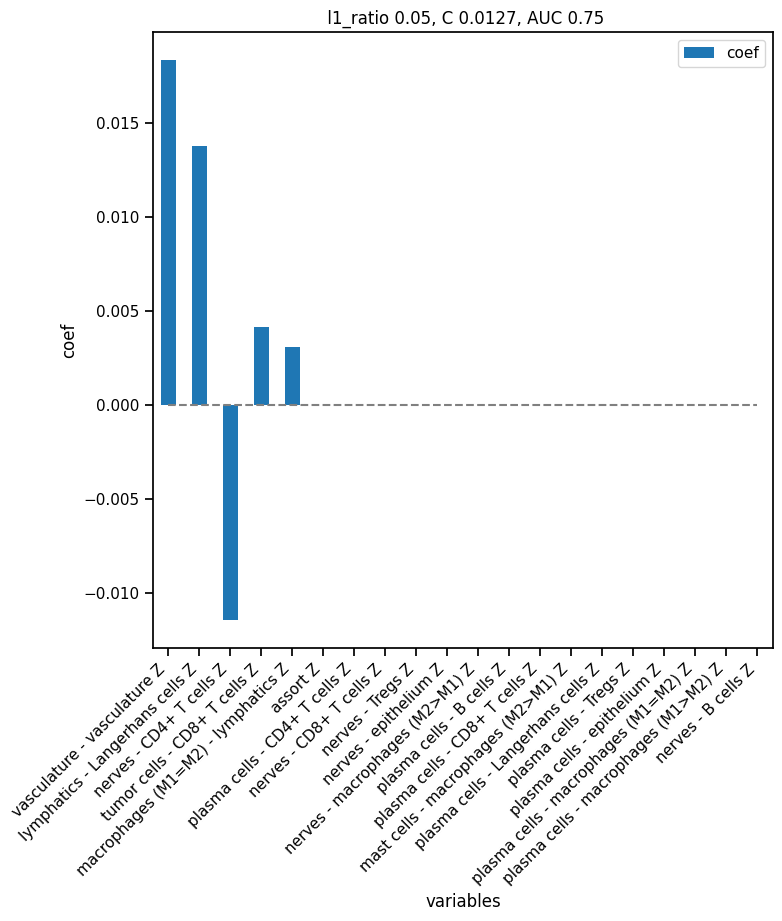

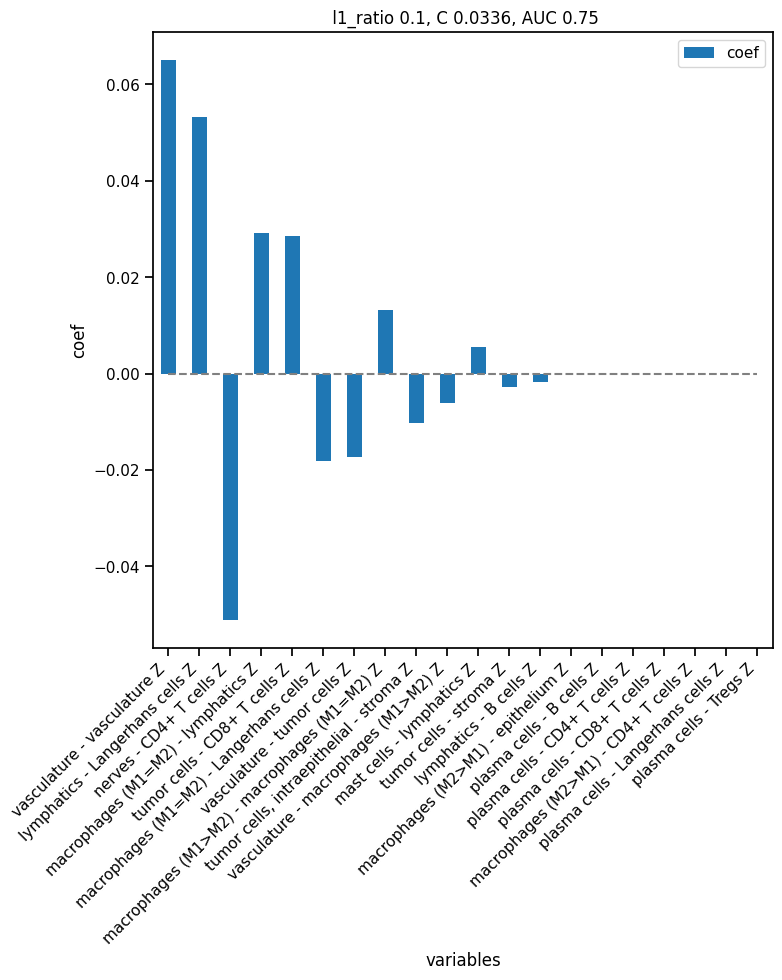

In [106]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[sample_col, patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [107]:
best_pval_names

['vasculature - vasculature Z',
 'lymphatics - B cells Z',
 'nerves - CD4+ T cells Z',
 'tumor cells, intraepithelial - B cells Z',
 'macrophages (M1=M2) - lymphatics Z']

Training took 2.393s


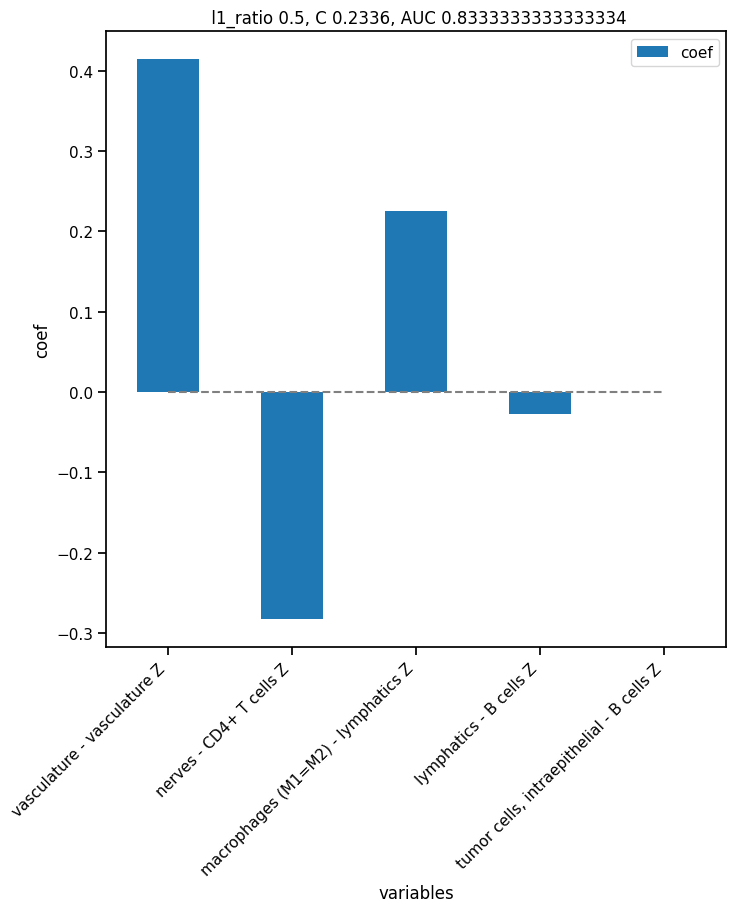

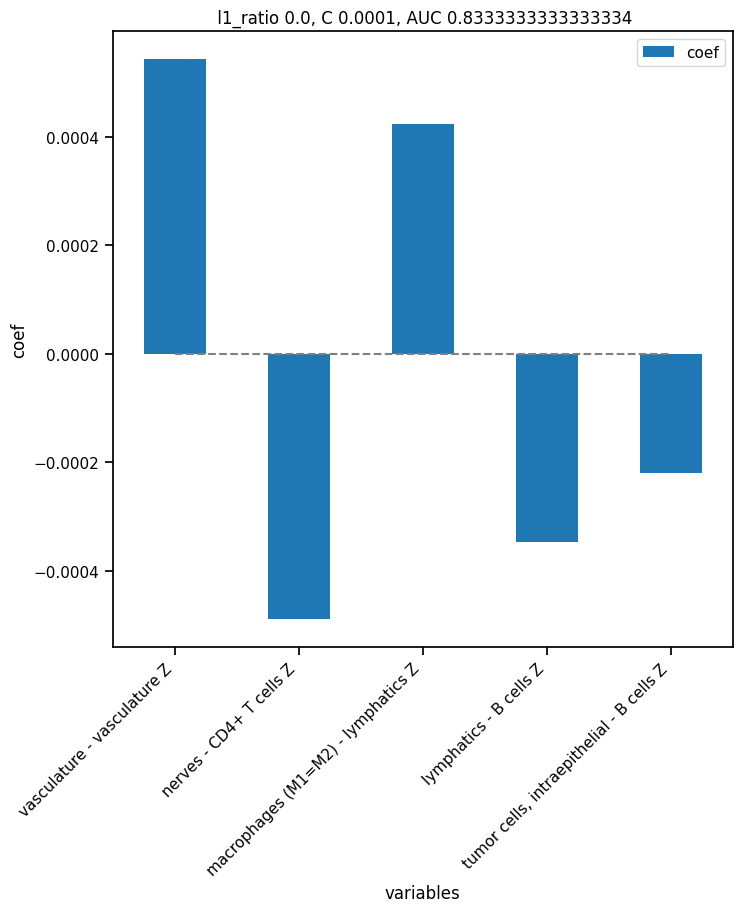

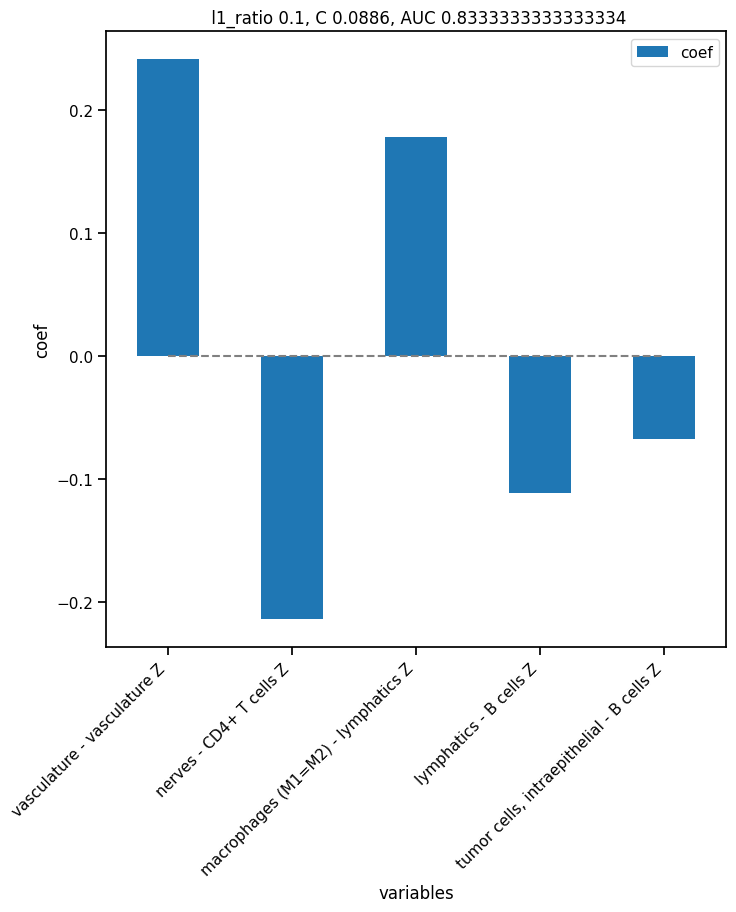

In [108]:
# columns = [
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'neutrophils - neutrophils Z', 
# ]

models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names + [group_col]],
    y_name=group_col,
    col_drop=[sample_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

#### Samples aggregation per patient and time point.

In [109]:
z_net_stats = net_stats[z_cols]
z_net_stats.index = [parse_sample(s) for s in z_net_stats.index]
z_net_stats.index.name = sample_col

z_net_stats = pd.concat([status, z_net_stats], axis=1, join='inner')#.sort_values('Spots')
z_net_stats.drop(columns=['Spots'], inplace=True)

In [110]:
# the mean of aggregated data already ignores nans
z_net_stats = z_net_stats.groupby([patient_col, group_col]).mean()
z_net_stats

,,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,macrophages (M1>M2) - lymphatics Z,macrophages (M1>M2) - macrophages (M1=M2) Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.436672,-0.910980,21.034440,0.733848,-1.583862,1.088509,0.278395,0.664266,0.333471,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,9.193553,-0.822662,-0.701849,13.168209,0.198415,-0.899198,0.620432,1.320380,-1.793802,1.006699,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2,52.271849,1.407704,1.038335,19.366867,0.140401,1.740360,4.767369,2.997277,1.595461,5.320606,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2,52.205555,-0.312825,-0.370097,6.435996,0.151055,-0.102629,1.617661,-0.309804,1.835647,2.588402,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1,20.961282,-0.128658,NaN,NaN,-0.247239,NaN,8.362145,-0.446663,NaN,2.810645,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,-0.386834,-0.661402,13.709393,0.702678,-0.749711,3.876020,2.343727,-1.102510,3.818033,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,1,20.803035,2.549321,-0.486520,8.969147,0.003807,-0.017965,2.488631,1.405974,1.116037,2.183699,...,2.372255,-0.362245,-0.229416,-0.119159,NaN,NaN,0.480766,-0.855591,-0.258904,4.171794
12,2,36.877393,4.104843,-1.087633,18.963265,0.936473,-1.101015,2.906149,-0.555962,0.467525,1.345566,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [111]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
Langerhans cells - Langerhans cells Z                 1
lymphatics - Langerhans cells Z                       1
lymphatics - lymphatics Z                             1
macrophages (M1=M2) - Langerhans cells Z              0
macrophages (M1=M2) - lymphatics Z                    1
macrophages (M1=M2) - macrophages (M1=M2) Z           0
macrophages (M1>M2) - Langerhans cells Z              0
macrophages (M1>M2) - lymphatics Z                    1
macrophages (M1>M2) - macrophages (M1=M2) Z           0
macrophages (M1>M2) - macrophages (M1>M2) Z           0
mast cells - Langerhans cells Z                       0
mast cells - lymphatics Z                             1
mast cells - macrophages (M1=M2) Z                    0
mast cells - macrophages (M1>M2) Z                    0
mast cells - mast cells Z                             2
nerves - Langerhans cells Z                           0
nerves - lymphatics Z                           

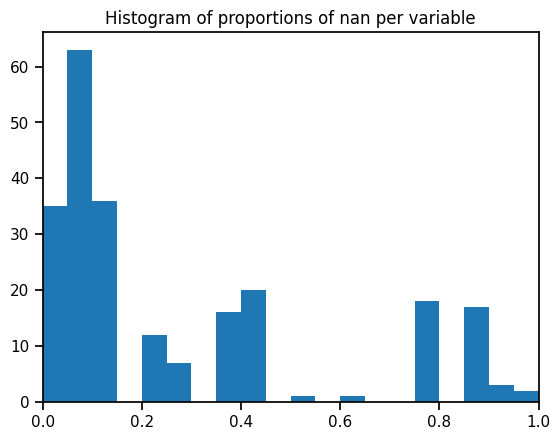

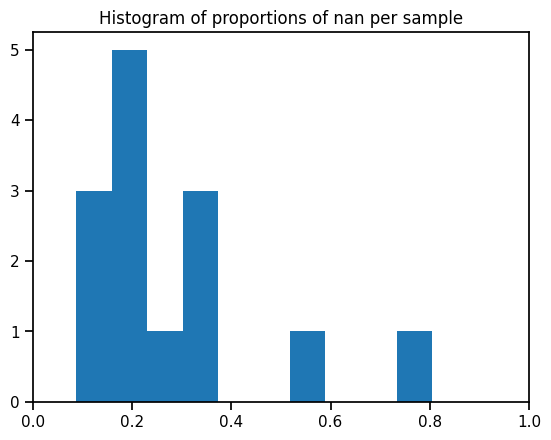

In [112]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping variables z_net_stats shape: (14, 231)
There are 884 non finite values (27.3%)
Final z_net_stats shape: (14, 169)
There are 62 variables discarded


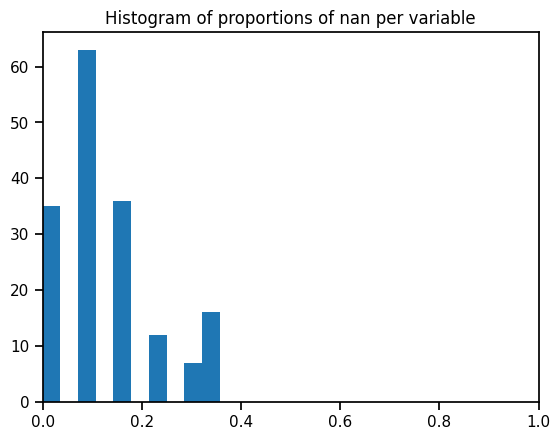

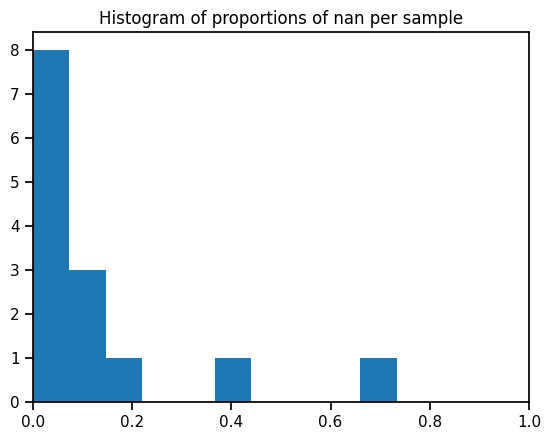

In [113]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (14, 169)
There are 279 non finite values (11.8%)
Final z_net_stats shape: (13, 169)
There are 1 observations discarded


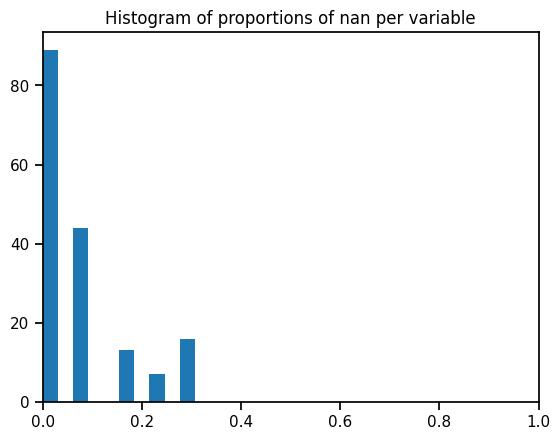

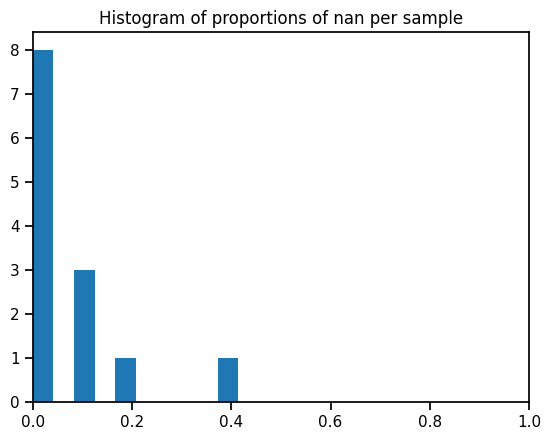

In [114]:
# Here we notice there are no patient with more than80% of nan values.
# We will still drop high-nan patients.

print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [115]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 155 non finite values (7.1%)
Imputing data
Final z_net_stats shape: (13, 169)


In [116]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.iloc[:, 1:], group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [117]:
pvals.head(10)

,pval,pval_corr
vasculature - vasculature Z,0.002331,0.391608
macrophages (M2>M1) - lymphatics Z,0.022145,0.998725
lymphatics - B cells Z,0.022145,0.998725
Tregs - CLA+ leukocytes Z,0.034965,0.998725
nerves - CD4+ T cells Z,0.051282,0.998725
macrophages (M1=M2) - lymphatics Z,0.073427,0.998725
B cells - B cells Z,0.073427,0.998725
"tumor cells, intraepithelial - macrophages (M2>M1) Z",0.101399,0.998725
"tumor cells, intraepithelial - B cells Z",0.137529,0.998725
tumor cells - CD8+ T cells Z,0.137529,0.998725


There are 4 significant variables in `pval`


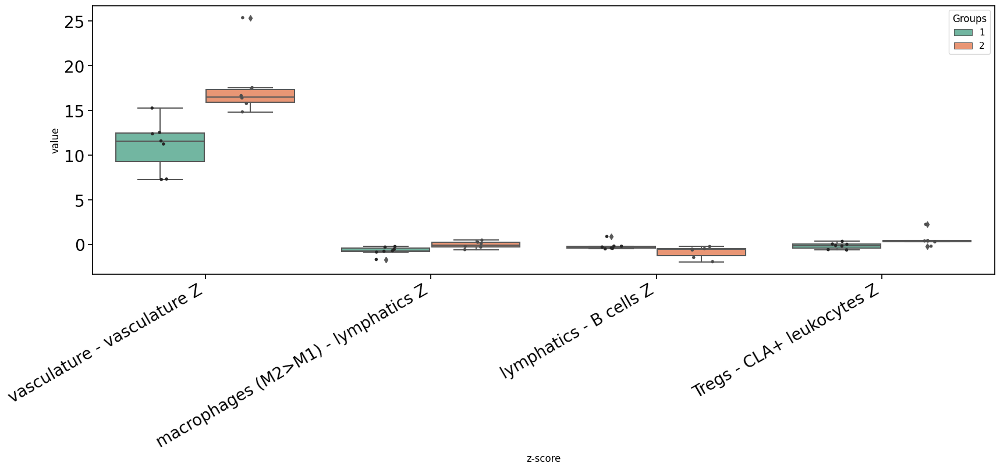

In [118]:
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

There are 4 significant variables in `pval`


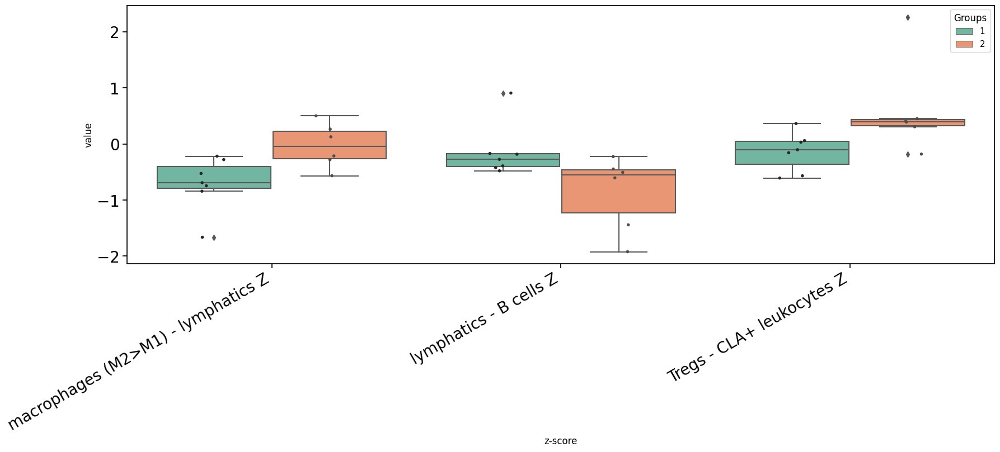

In [119]:
exclude_vars = [
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'Langerhans cells - Langerhans cells Z',
    #  'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
]

fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    exclude_vars=exclude_vars,
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

Distributions of Z scored interactions between -2 and 2 are not significative.

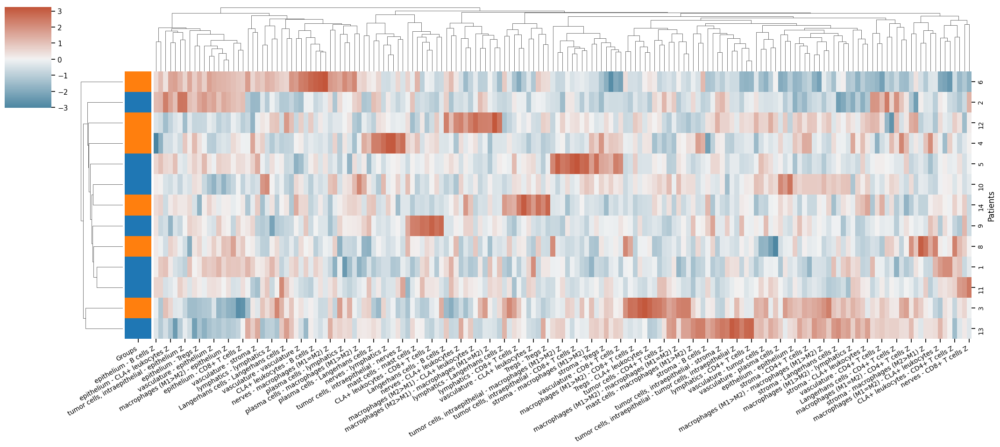

In [120]:
mosna.plot_heatmap(
    z_net_stats_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )
plt.savefig(save_dir / "assortativity_z-scored_clustering-patients", bbox_inches='tight', facecolor='white')

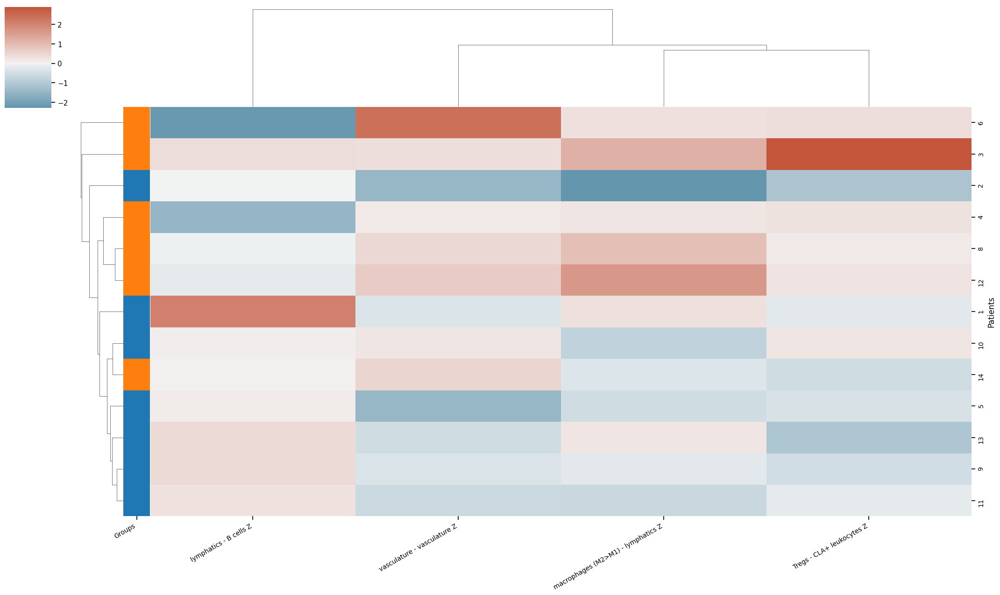

In [121]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )
plt.savefig(save_dir / "assortativity_z-scored_clustering-patients", bbox_inches='tight', facecolor='white')

#### Logistic regression on interaction coefficients

Add  vasculature - vasculature Z    with p-value 0.00433855
Add  macrophages (M1=M2) - lymphatics Z with p-value 0.0249937
Add  Tregs - CD4+ T cells Z         with p-value 0.0309824
Add  Langerhans cells - B cells Z   with p-value 0.0127671
Add  tumor cells, intraepithelial - nerves Z with p-value 0.0187272
Add  nerves - nerves Z              with p-value 0.00705618
Add  tumor cells, intraepithelial - lymphatics Z with p-value 0.0148705
Add  vasculature - tumor cells, intraepithelial Z with p-value 0.00135075
Add  vasculature - mast cells Z     with p-value 0.0390574
Add  nerves - CD8+ T cells Z        with p-value 0.00431177
Add  vasculature - CD4+ T cells Z   with p-value 0.00863992


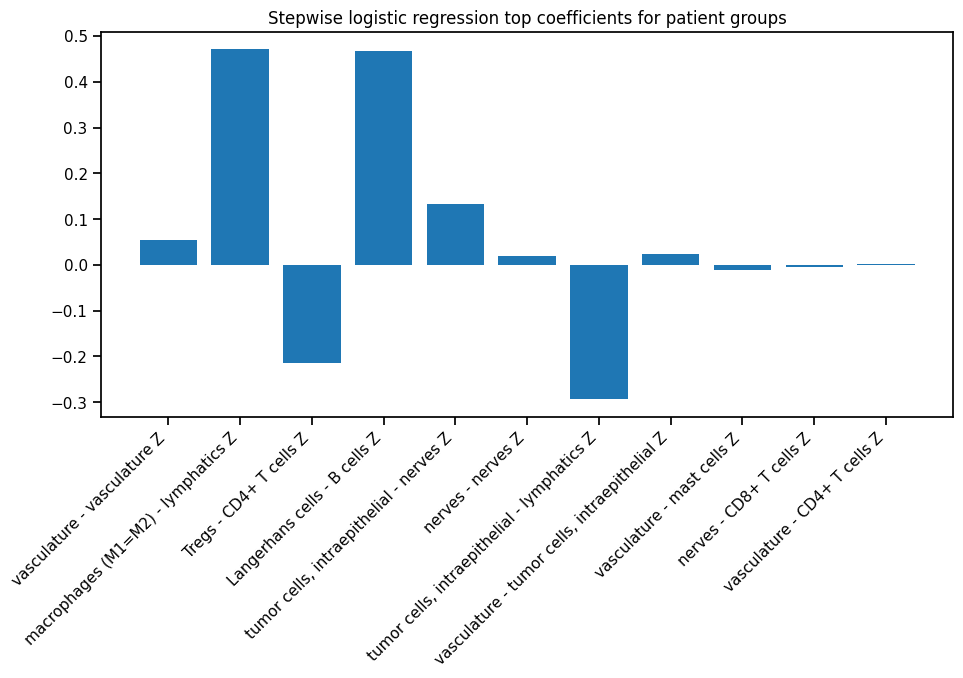

In [123]:
# Stepwise logistic regression
if len(best_pval_names) > 0:
    # model, included = mosna.stepwise_regression(X=z_net_stats_cleaned.drop(columns=['Spots']), y_name=group_col, y_values=[1, 2], verbose=True)
    model, included = mosna.stepwise_regression(X=z_net_stats_cleaned, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no interaction statistically related to response group")

TODO: Compute performance metrics for SWLR models

        training failed
        training failed with cv <= 5
        training failed
        training failed with cv <= 5
Training took 2.320s


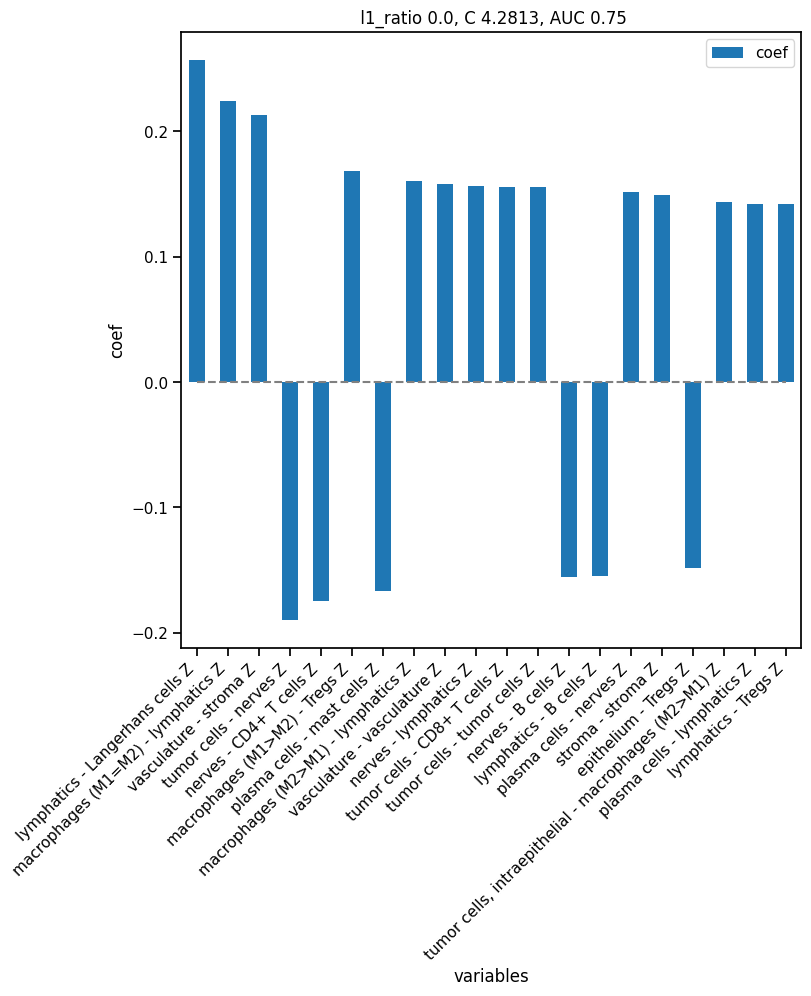

In [126]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [99]:
# columns = [
#     'neutrophils - neutrophils Z', 
#     'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
#     'vasculature -vascilature Z',
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'vasculature - vasculature Z',
#     'neutrophils - neutrophils Z',
#     'Langerhans cells - Langerhans cells Z',
# ]

Training took 2.040s


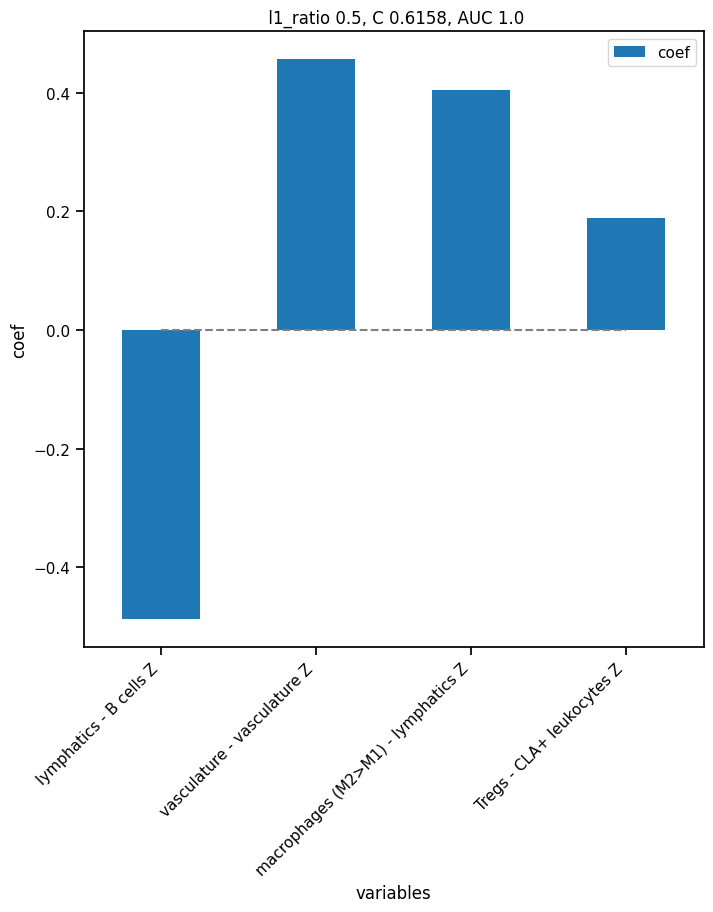

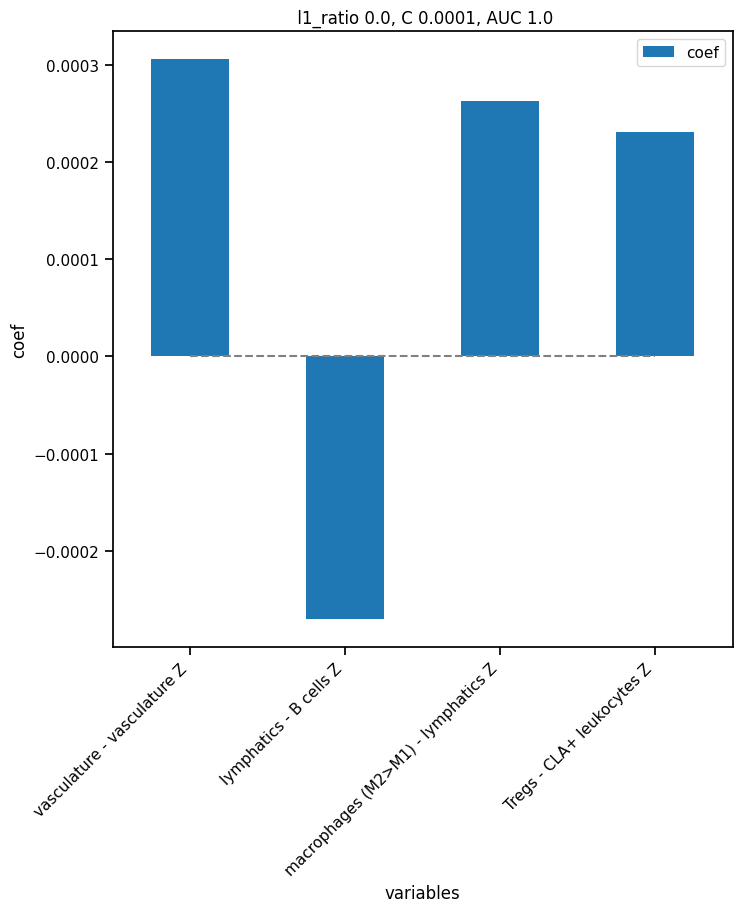

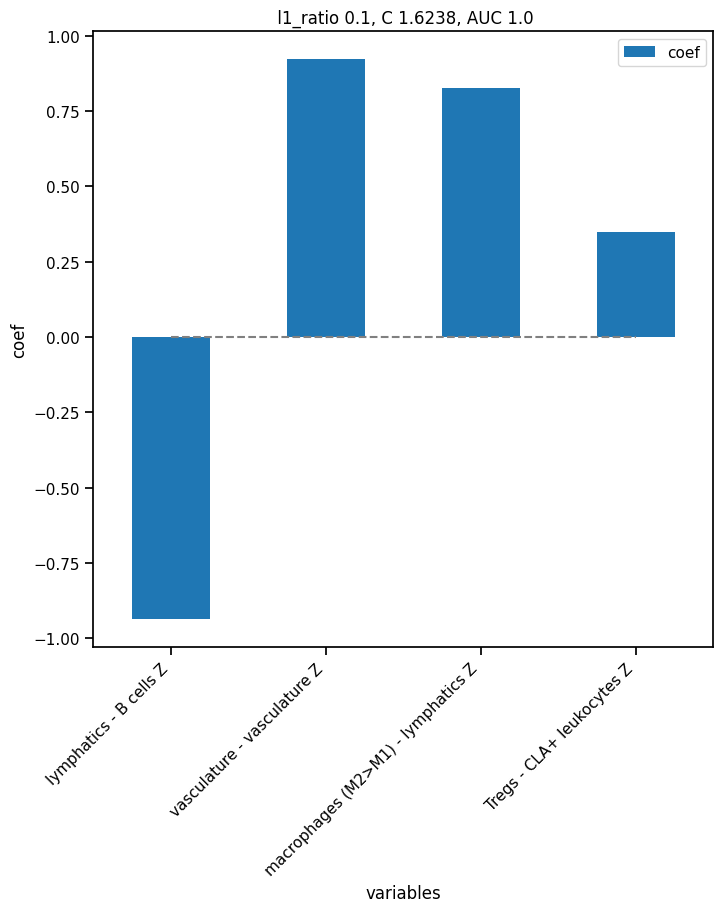

In [129]:
models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

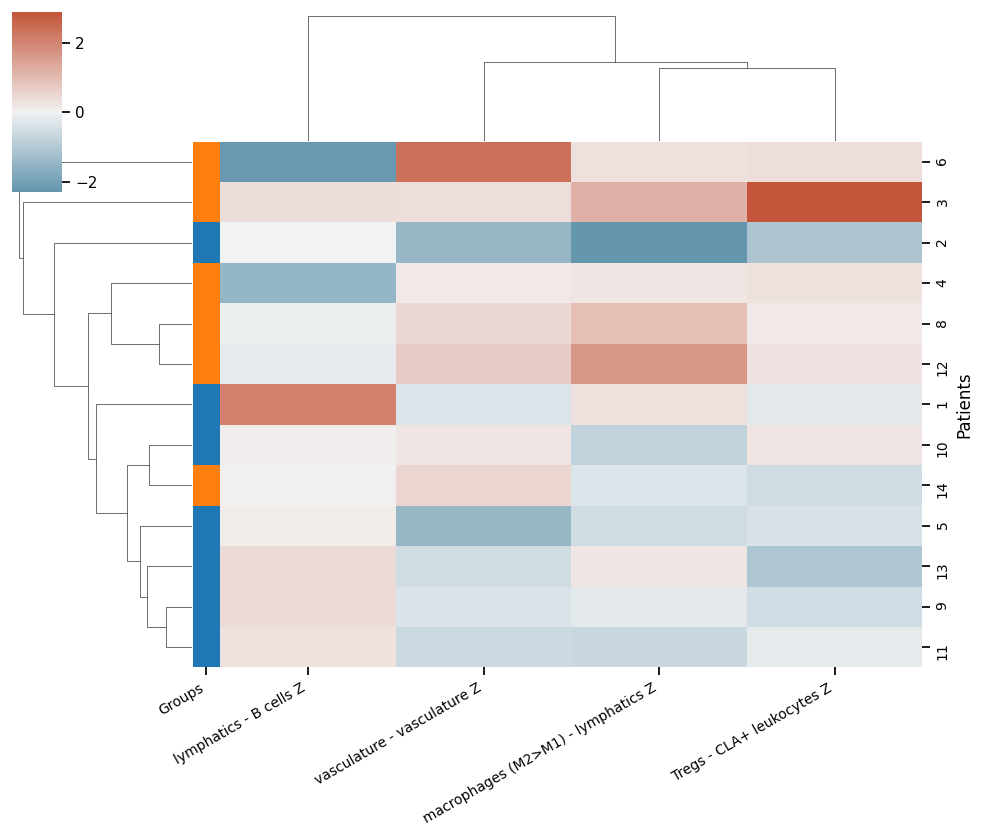

In [133]:
# use the most statistically relevant variable separating groups
# Note: that's to have a clue, do not use this method for real,
# it's a tautology!

nb_vars = np.sum(pvals['pval'] <= 0.05)
# nb_vars = min(nb_vars, 20)
marker_vars = pvals.sort_values(by='pval', ascending=True).head(nb_vars).index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[marker_vars].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    )

### Ratio of MM elements

In [134]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.copy(), group_ref=1, group_tgt=2, group_var=group_col, composed_vars=False)
pvals = pvals.sort_values(by='pval', ascending=True)
pvals

,pval,pval_corr
vasculature - vasculature Z,0.002331,0.393939
macrophages (M2>M1) - lymphatics Z,0.022145,0.998390
lymphatics - B cells Z,0.022145,0.998390
Tregs - CLA+ leukocytes Z,0.034965,0.998390
nerves - CD4+ T cells Z,0.051282,0.998390
...,...,...
vasculature - mast cells Z,1.000000,1.000000
stroma - macrophages (M2>M1) Z,1.000000,1.000000
macrophages (M2>M1) - macrophages (M1=M2) Z,1.000000,1.000000
vasculature - macrophages (M1=M2) Z,1.000000,1.000000


In [135]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(z_net_stats_cleaned.copy(), order=1)
z_agg_ratios = pd.concat([z_net_stats_cleaned.copy(), composed_variables], axis=1)

pvals = mosna.find_DE_markers(z_agg_ratios, group_ref=1, group_tgt=2, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [136]:
pvals.head(20)

,pval,pval_corr
tumor cells - lymphatics Z / ( tumor cells - lymphatics Z + vasculature - CLA+ leukocytes Z ),0.001166,1.0
nerves - macrophages (M1>M2) Z / ( nerves - macrophages (M1>M2) Z + macrophages (M2>M1) - Tregs Z ),0.001166,1.0
macrophages (M2>M1) - CD4+ T cells Z / ( macrophages (M2>M1) - CD4+ T cells Z + plasma cells - CD4+ T cells Z ),0.001166,1.0
"nerves - macrophages (M1>M2) Z / ( nerves - macrophages (M1>M2) Z + tumor cells, intraepithelial - CD4+ T cells Z )",0.001166,1.0
mast cells - Langerhans cells Z / ( mast cells - Langerhans cells Z + mast cells - CLA+ leukocytes Z ),0.001166,1.0
...,...,...
Tregs - B cells Z / ( Tregs - B cells Z + plasma cells - lymphatics Z ),0.002331,1.0
tumor cells - lymphatics Z / ( tumor cells - lymphatics Z + vasculature - CD4+ T cells Z ),0.002331,1.0
"Tregs - B cells Z / ( Tregs - B cells Z + vasculature - tumor cells, intraepithelial Z )",0.002331,1.0
tumor cells - mast cells Z / ( tumor cells - mast cells Z + plasma cells - macrophages (M1>M2) Z ),0.002331,1.0


In [137]:
(pvals['pval'] < 0.05).sum()

411

In [138]:
z_agg_ratios

,,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,macrophages (M1>M2) - lymphatics Z,macrophages (M1>M2) - macrophages (M1=M2) Z,...,vasculature - Tregs Z / ( vasculature - Tregs Z + vasculature - epithelium Z ),vasculature - Tregs Z / ( vasculature - Tregs Z + vasculature - macrophages (M2>M1) Z ),vasculature - Tregs Z / ( vasculature - Tregs Z + vasculature - plasma cells Z ),"vasculature - Tregs Z / ( vasculature - Tregs Z + vasculature - tumor cells, intraepithelial Z )",vasculature - epithelium Z / ( vasculature - epithelium Z + vasculature - macrophages (M2>M1) Z ),vasculature - epithelium Z / ( vasculature - epithelium Z + vasculature - plasma cells Z ),"vasculature - epithelium Z / ( vasculature - epithelium Z + vasculature - tumor cells, intraepithelial Z )",vasculature - macrophages (M2>M1) Z / ( vasculature - macrophages (M2>M1) Z + vasculature - plasma cells Z ),"vasculature - macrophages (M2>M1) Z / ( vasculature - macrophages (M2>M1) Z + vasculature - tumor cells, intraepithelial Z )","vasculature - plasma cells Z / ( vasculature - plasma cells Z + vasculature - tumor cells, intraepithelial Z )"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.436672,-0.910980,21.034440,0.733848,-1.583862,1.088509,0.278395,0.664266,0.333471,...,0.524297,0.575147,0.675769,0.635424,0.551223,0.654104,0.612609,0.606235,0.562835,0.455409
2,1,9.193553,-0.822662,-0.701849,13.168209,0.198415,-0.899198,0.620432,1.320380,-1.793802,1.006699,...,-1.551551,0.184867,0.518743,0.380812,-0.594810,2.294308,88.648770,0.826170,0.730589,0.363291
3,2,52.271849,1.407704,1.038335,19.366867,0.140401,1.740360,4.767369,2.997277,1.595461,5.320606,...,-0.279636,3.059090,1.305010,1.355732,0.871769,0.951407,0.945770,0.742264,0.719517,0.471107
4,2,52.205555,-0.312825,-0.370097,6.435996,0.151055,-0.102629,1.617661,-0.309804,1.835647,2.588402,...,-0.088402,0.444768,0.843734,6.376885,1.112835,1.015273,0.935905,0.870806,3.081020,-0.281481
5,1,20.961282,-0.128658,-0.061990,15.910060,-0.247239,-0.433946,8.362145,-0.446663,-0.172172,2.810645,...,-0.046803,0.048668,6.378333,0.104999,7.934343,0.963669,1.615780,1.045082,0.696348,-0.109785
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,-0.386834,-0.661402,13.709393,0.702678,-0.749711,3.876020,2.343727,-1.102510,3.818033,...,0.122496,0.848277,4.314395,1.344821,0.975640,1.120121,1.037122,-0.303483,-2.306486,0.749755
11,1,20.803035,2.549321,-0.486520,8.969147,0.003807,-0.017965,2.488631,1.405974,1.116037,2.183699,...,0.166722,0.757195,0.743824,0.508561,0.939710,0.935534,0.837982,0.482151,0.249156,0.262756
12,2,36.877393,4.104843,-1.087633,18.963265,0.936473,-1.101015,2.906149,-0.555962,0.467525,1.345566,...,0.062265,0.295523,0.440685,1.011246,0.863346,0.922277,1.000739,0.652564,1.004687,1.008840


There are 411 significant variables in `pval`


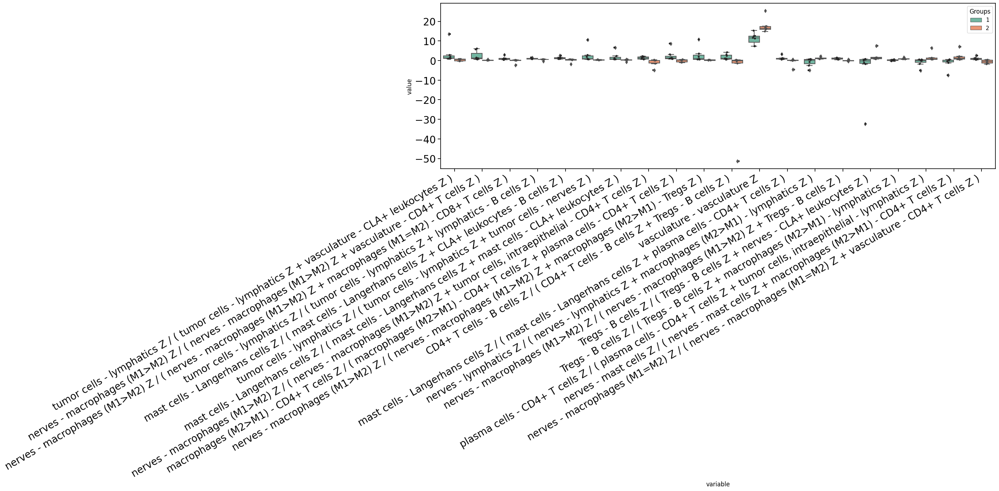

In [139]:
fig, ax = mosna.plot_distrib_groups(
    z_agg_ratios, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

In [140]:
# exclude_vars = [
#     'Langerhans cells - Langerhans cells Z / plasma cells - Langerhans cells Z',
#     'neutrophils - neutrophils Z / stroma - IDO+ stromal cells Z',
#     'Langerhans cells - Langerhans cells Z / plasma cells - macrophages (M1>M2) Z',
#     'neutrophils - neutrophils Z',
#     'Langerhans cells - Langerhans cells Z / Tregs - nerves Z',
# ]


# fig, ax = mosna.plot_distrib_groups(
#     z_agg_ratios, 
#     group_var=group_col,
#     groups=[1, 2], 
#     pval_data=pvals, 
#     pval_col='pval', 
#     max_cols=20, 
#     multi_ind_to_col=True,
#     exclude_vars=exclude_vars,
#     )

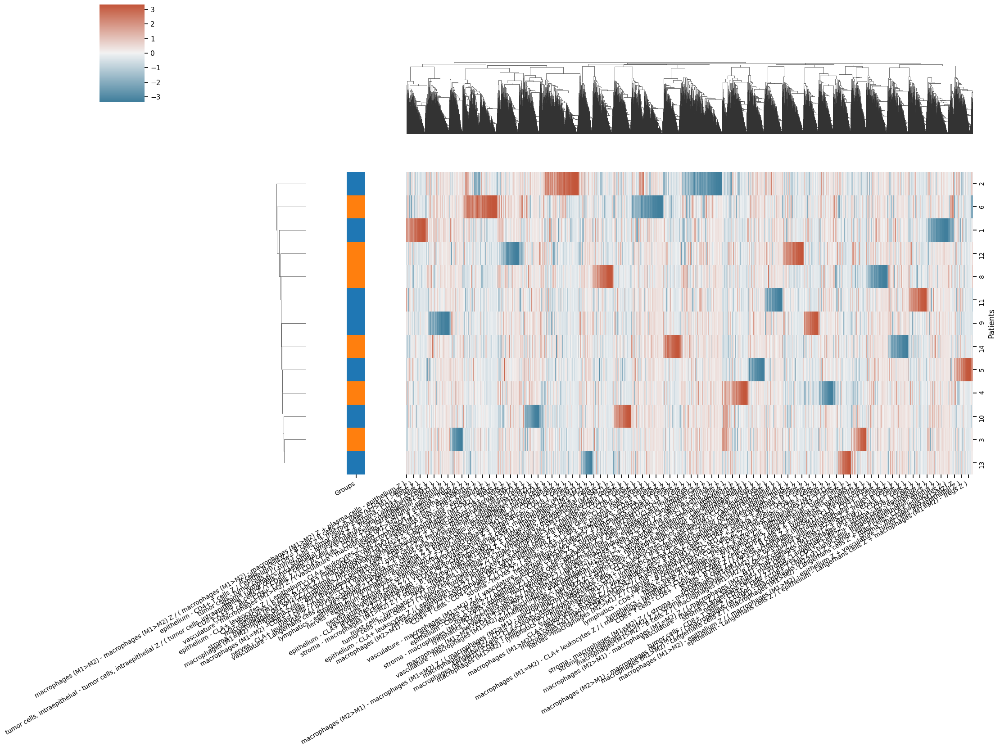

In [141]:
mosna.plot_heatmap(
    z_agg_ratios.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )
# plt.savefig(save_dir / "assortativity_z-scored_ratios_clustering-patients", bbox_inches='tight', facecolor='white')

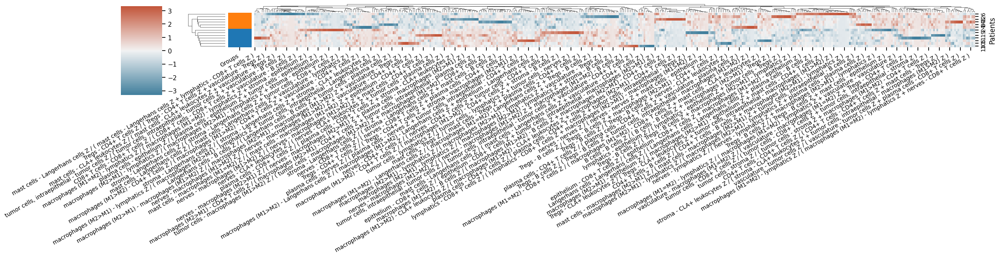

In [145]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_agg_ratios[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )

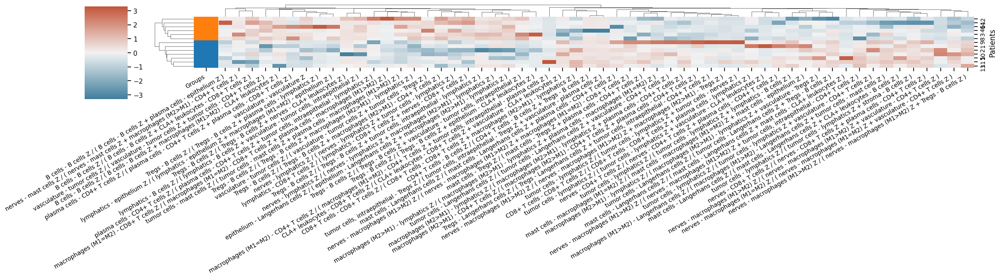

In [144]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index.tolist()

mosna.plot_heatmap(
    z_agg_ratios[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )

In [148]:
models = mosna.logistic_regression(
    z_agg_ratios,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

        training failed
        training failed with cv <= 5
        training failed
        training failed with cv <= 5
        training failed
        training failed with cv <= 5
Training took 73.841s


Training took 2.068s


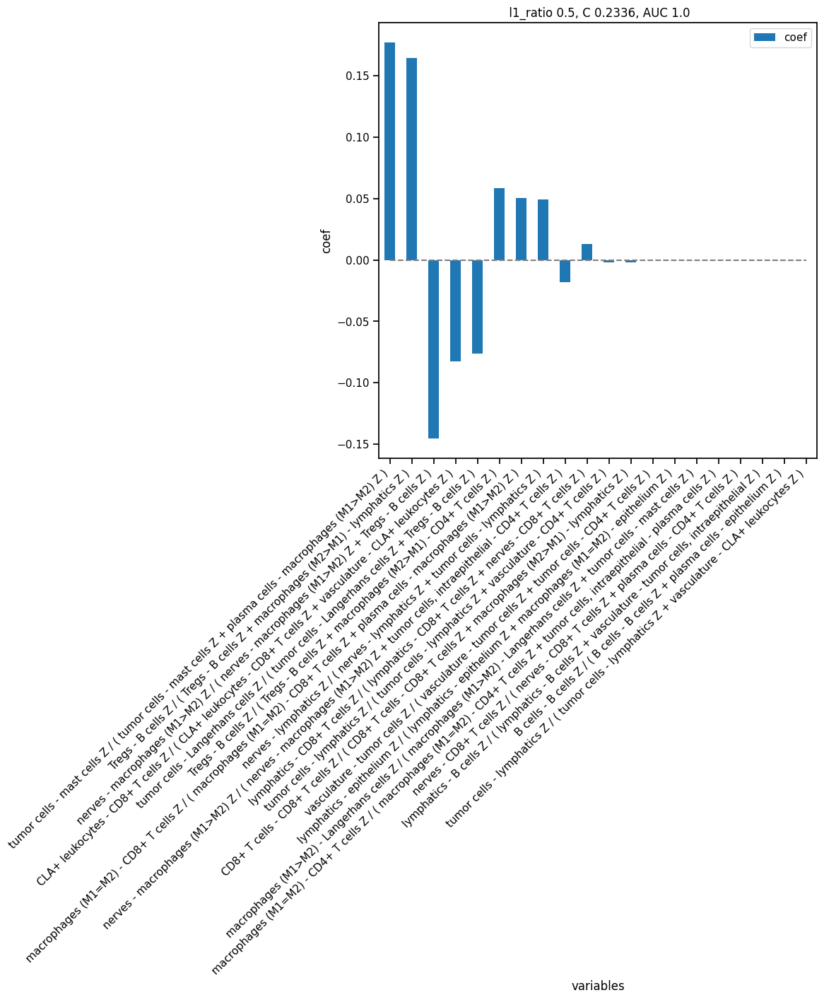

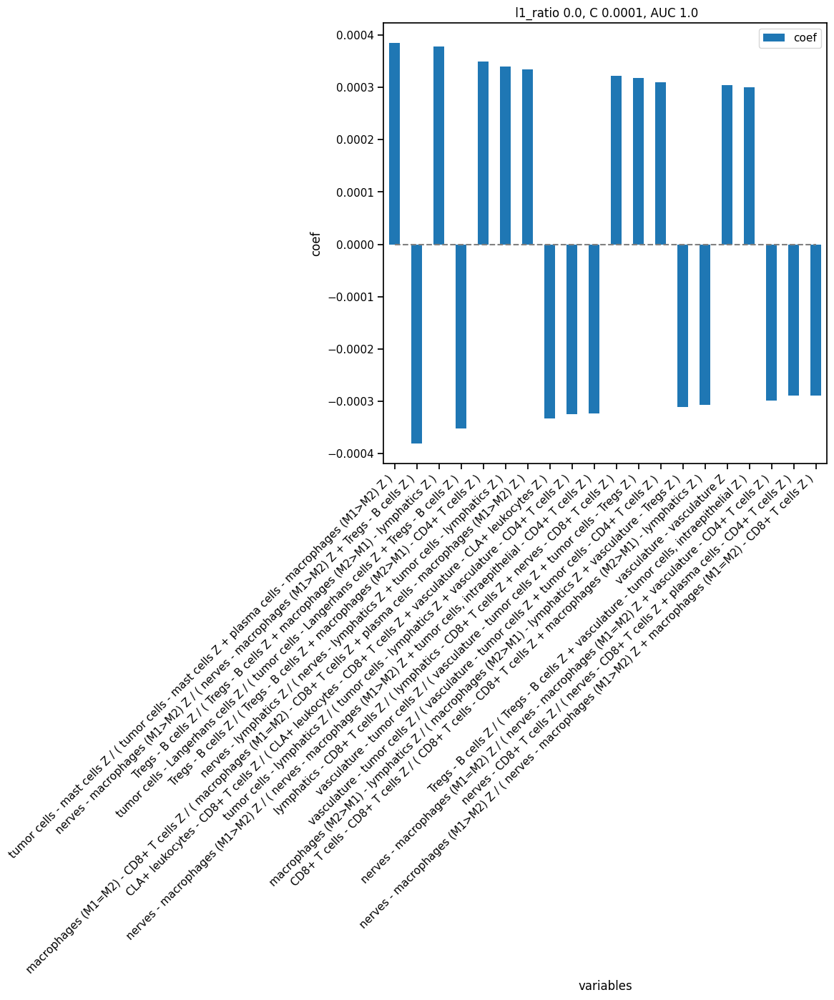

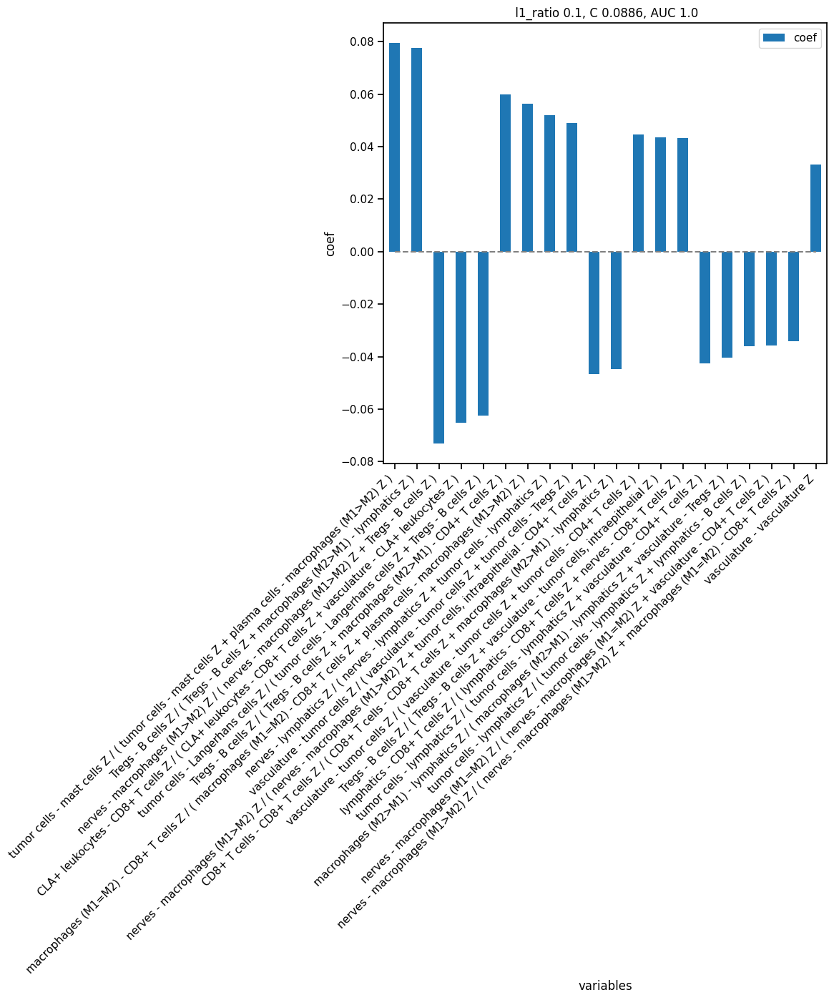

In [149]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index.tolist()

models = mosna.logistic_regression(
    z_agg_ratios[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Marker-positive cells interactions

We can also compute the mixing matrix and assortativity between marker-positive cells.

## Cellular neighborhoods

The mixing matrix and assortativity give us information about the global network organization.  
Here we will see how to use the *Neighbors Aggregation Statistics* method to find local "cellular communities", or "neighborhoods", or "niches", that can be relevant to understand disease progression or response to therapies.  

### On cell types

First order neighbors, mean and std

In [95]:
order = 1
var_type = 'cell-types'
stat_names = 'mean-std'
aggreg_vars = cell_type_cols

# For UMAP visualization
marker = '.'
size_points = 10

In [51]:
sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

In [52]:
# attrib_all = obj[cell_type_cols]
X = obj[aggreg_vars].values
edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.values

In [53]:
filename = sof_dir / f'aggregation_statistics.csv'

if filename.exists():
    var_aggreg = pd.read_csv(filename)
else:
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
    )
    var_aggreg.to_csv(filename, index=False)

In [54]:
n_neighbors = 70
metric = 'euclidean'
min_dist = 0.0

reducer = umap.UMAP(
    random_state=0,
    n_neighbors=n_neighbors,
    metric=metric,
    min_dist=min_dist,
    # we don't modify the other parameters
    # spread=1.0,
    # set_op_mix_ratio=1.0,
    # local_connectivity=1.0,
    # repulsion_strength=1.0,
    # negative_sample_rate=5,
    # transform_queue_size=4.0,
    )
embedding = reducer.fit_transform(var_aggreg)
reducer_name = f"reducer-umap_nneigh-{n_neighbors}_metric-{metric}_min_dist-{min_dist}"
# save reduced coordinates
np.save(sof_dir / (reducer_name + '.npy'), embedding, allow_pickle=False, fix_imports=False)
# save the reducer object
joblib.dump(reducer, sof_dir / (reducer_name + '.pkl'))
embedding.shape

/home/alexis/.pyenv/versions/3.8.10/envs/spatial-networks/lib/python3.8/site-packages/scipy/sparse/_index.py:125: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


(117170, 2)

In [47]:
joblib.dump(reducer, str(sof_dir / (reducer_name + '.pkl')))

['../data/processed/CODEX_CTCL/all_samples_networks_xy_trim_dist-percentile_size_solitary-0/nas_on-cell-types_stats-mean-std_order-1/reducer-umap_nneigh-70_metric-euclidean_min_dist-0.0.pkl']

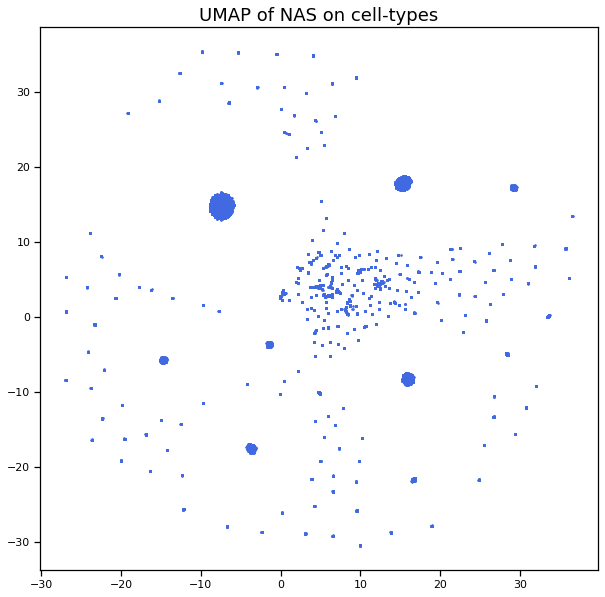

In [48]:
plt.figure(figsize=[10,10])
plt.scatter(embedding[:, 0], embedding[:, 1], c='royalblue', marker=marker, s=size_points)
title = f"UMAP of NAS on {var_type}"
plt.title(title, fontsize=18);

#### Screen NAS parameters

In [ ]:
from importlib import reload
reload(mosna)

orders = [1]
dim_clusts = [2, 3, 4, 5, 6, 7, 8, 9]
min_cluster_sizes = [100, 250, 500, 750, 1000]
parallel_dim = 'max'
parallel_clustering = 4
processed_dir = Path('../data/processed/CODEX_CTCL')
opt_str = '_samples-all_stat-mean-std'
save_dir = 'test-parallel'

mosna.screen_nas_parameters(X, pairs, markers, orders, dim_clusts, min_cluster_sizes, processed_dir, save_dir=save_dir, soft_clustering=True, 
                            opt_str=opt_str, parallel_dim=parallel_dim, parallel_clustering=parallel_clustering, memory_limit='800GB')


#### Clusters visualization

dim_clust: 2
    min_cluster_size: 100


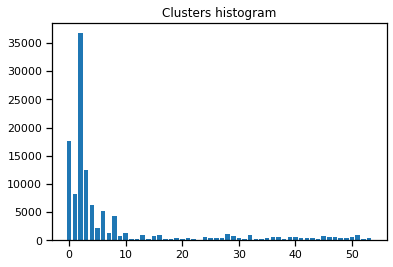

No handles with labels found to put in legend.


        sample: 1


In [188]:
reload(mosna)

orders = [1]
dim_clusts = [2, 3, 4, 5, 6, 7, 8, 9]
min_cluster_sizes = [100, 250, 500, 750, 1000]
processed_dir = Path('../data/processed/CODEX_CTCL')
opt_str = '_samples-all_stat-mean-std'

mosna.plot_screened_parameters(obj, pos_cols, cell_type_cols, orders, dim_clusts, processed_dir,
                               min_cluster_sizes, all_edges='all_samples_networks', sampling=False, var_type=None, 
                               downsample=False, aggreg_dir=None, load_dir=None, save_dir=None, opt_str=opt_str)

### On markers

In [101]:
method = 'NAS'
# method = 'SCAN-IT'

order = 1
var_type = 'markers'
stat_names = 'mean-std'
stat_funcs='default'
stat_names='default'
# stat_funcs = np.mean
# stat_names = 'mean'
# aggreg_vars = pheno_cols

if method == 'NAS':
    # directory of spatial omic features
    sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
    sof_dir.mkdir(parents=True, exist_ok=True)
elif method == 'SCAN-IT':
    # directory of spatial omic features
    sof_dir = nodes_dir / f"scanit_on-{var_type}"    
    sof_dir.mkdir(parents=True, exist_ok=True)

# For UMAP visualization
marker = '.'
size_points = 10

In [102]:
node_file = list(reconst_dir.glob('nodes_*.parquet'))[0]
attributes_col = pd.read_parquet(node_file).columns[:-2]

In [103]:
attributes_col

Index(['x', 'y', 'cell type', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'CLA+ leukocytes', 'DCs, CD11c+', 'IDO+ stromal cells',
       'Langerhans cells', 'Tregs', 'epithelium', 'lymphatics',
       'macrophages (M1=M2)', 'macrophages (M1>M2)', 'macrophages (M2>M1)',
       'mast cells', 'nerves', 'neutrophils', 'plasma cells', 'stroma',
       'tumor cells', 'tumor cells, intraepithelial', 'vasculature', 'FOXP3',
       'GATA3', 'MUC-1', 'Vimentin', 'T-bet', 'CD62L', 'Cytokeratin', 'PD-L1',
       'Ki-67', 'CD15', 'CD30', 'CD2', 'GranzymeB', 'CD5', 'CD39', 'MMP9',
       'CD4', 'LAG3', 'CD25', 'CD56', 'CD20', 'PD-1', 'CD11c', 'CLA-CD162',
       'IDO-1', 'VISTA', 'HLA-DR', 'ICOS', 'BCL-2', 'CD3', 'CD69', 'CD8',
       'CD7', 'CD45RA', 'CD45', 'CD1a', 'CD57', 'B-catenin', 'CD45RO', 'CD71',
       'CD34', 'CD68', 'CD38', 'CollagenIV', 'CD31', 'Podoplanin', 'CD138',
       'CD163', 'Mastcell-tryptase', 'MMP12', 'CD164', 'p53', 'CCR6', 'CD16',
       'CD11b'],
      dtype='object'

In [104]:
reload(mosna)

<module 'mosna.mosna' from '/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py'>

In [106]:
edges_dir

PosixPath('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3')

In [107]:
filename = sof_dir / f'aggregation_statistics.parquet'

if filename.exists():
    print('Load aggregation statistics')
    var_aggreg = pd.read_parquet(filename)
else:
    var_aggreg = mosna.compute_spatial_omic_features_all_networks(
        method=method,
        nodes_dir=nodes_dir,
        edges_dir=edges_dir, 
        attributes_col=attributes_col, 
        use_attributes=marker_cols, # use all attributes 
        make_onehot=False, 
        stat_funcs=stat_funcs,
        stat_names=stat_names,
        id_level_1='patient',
        id_level_2='sample', 
        extension='parquet',
        data_index=None,
        parallel_groups=False, #'max', 
        memory_limit='max',
        save_intermediate_results=False, 
        dir_save_interm=None,
        verbose=1,
        )
    var_aggreg.to_parquet(filename, index=False)

data: 100%|██████████| 29/29 [00:02<00:00,  9.73it/s]


In [109]:
# retrieve network info and remove it from NAS table
var_aggreg_samples_info = var_aggreg[['patient', 'sample']]
var_aggreg.drop(columns=['patient', 'sample'], inplace=True)

In [110]:
var_aggreg

,FOXP3 mean,GATA3 mean,MUC-1 mean,Vimentin mean,T-bet mean,CD62L mean,Cytokeratin mean,PD-L1 mean,Ki-67 mean,CD15 mean,...,CD163 std,Mastcell-tryptase std,MMP12 std,CD164 std,p53 std,CCR6 std,CD16 std,CD11b std,CCR4 std,EGFR std
0,0.051929,0.020772,0.143854,0.114105,0.063696,-0.029824,-0.054979,-0.174515,0.102320,-0.051192,...,0.071924,0.053871,0.040228,0.017292,0.009788,0.035631,0.014495,0.023713,0.0,0.0
1,0.030949,0.020868,0.103542,0.109624,0.094377,-0.010374,-0.028705,-0.219838,0.124533,-0.039827,...,0.022474,0.053976,0.052094,0.036259,0.005400,0.023135,0.051291,0.013761,0.0,0.0
2,0.047038,0.018171,0.143875,0.098401,0.078787,-0.017430,0.025349,-0.216158,0.110923,-0.051625,...,0.083224,0.049045,0.066538,0.009928,0.003357,0.026004,0.112810,0.012135,0.0,0.0
3,0.075300,0.040729,0.129774,0.107679,0.068932,-0.023587,-0.016752,-0.220682,0.100538,-0.037418,...,0.085097,0.033951,0.074406,0.018837,0.008119,0.035856,0.011793,0.008725,0.0,0.0
4,0.080212,0.001324,0.135504,0.107500,0.073880,-0.040149,0.009726,-0.196033,0.105935,-0.034791,...,0.077400,0.050277,0.070841,0.053142,0.012311,0.035975,0.011338,0.017062,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1904,0.086637,-0.010136,0.138054,0.067018,0.083059,-0.067397,0.053803,-0.177677,0.110275,-0.040961,...,0.017854,0.015227,0.044064,0.012310,0.013274,0.028051,0.006623,0.012730,0.0,0.0
1905,0.020715,0.035064,0.150269,0.116261,0.072845,-0.012741,0.017578,-0.241258,0.110400,-0.027556,...,0.017980,0.053749,0.086857,0.053231,0.015831,0.025305,0.074165,0.008851,0.0,0.0
1906,0.056651,0.040472,0.142154,0.108011,0.079002,-0.009502,0.006976,-0.210690,0.109395,-0.037599,...,0.040363,0.071312,0.066242,0.011296,0.014940,0.027676,0.093624,0.020682,0.0,0.0
1907,-0.008281,0.055926,0.148055,0.114563,0.071210,-0.006853,-0.058583,-0.227113,0.109383,-0.020025,...,0.011276,0.032378,0.033625,0.033382,0.005845,0.011419,0.012520,0.015343,0.0,0.0


In [114]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'manhattan', # or 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading reducer object and reduced coordinates
Performing clustering
Found 10 clusters


Loading reducer object and reduced coordinates


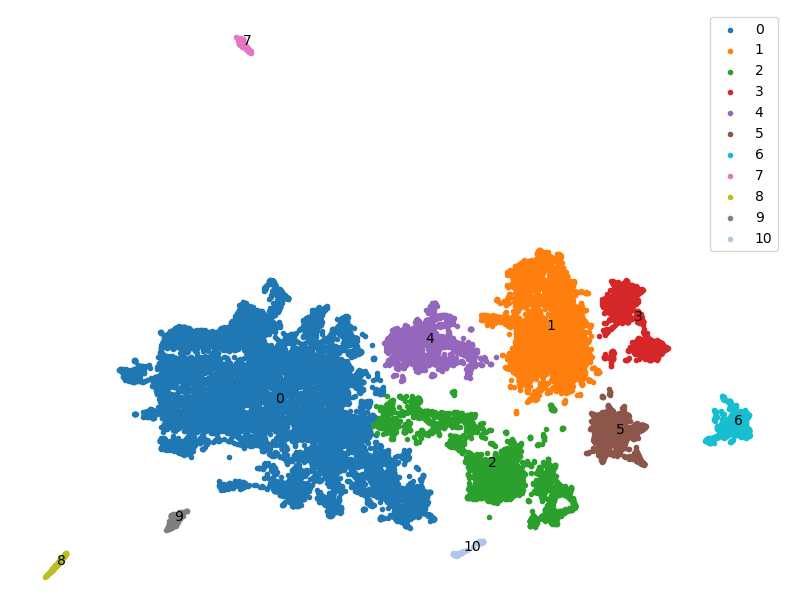

In [115]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type='umap', 
    n_neighbors=15, 
    metric='manhattan',
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    )

#### Leinden clustering

Test:
  - reducer-umap_dim-2_nneigh-75_metric-euclidean_min_dist-0.0/clusterer-leiden_n_neighbors-15/biclustering_resolution-0.05_normalized-clr
  - reducer-umap_dim-2_nneigh-75_metric-euclidean_min_dist-0.0/clusterer-leiden_n_neighbors-15/biclustering_resolution-0.05_normalized-obs

In [ ]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading reducer object and reduced coordinates


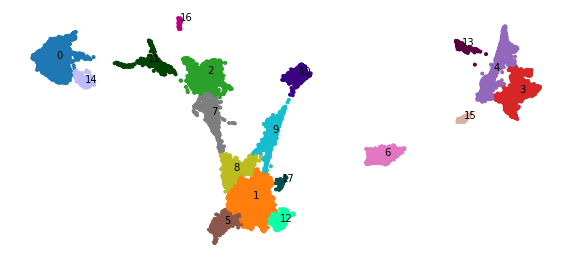

In [78]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

In [ ]:
save_dir = cluster_dir / 'spatial_networks_niches'
save_dir.mkdir(parents=True, exist_ok=True)

# colormap for cell-types
n_cell_types = obj[pheno_col].unique().size
# palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])

plots_marker = '.'
for sample in obj[sample_col].unique():
    print("filename: {}".format(sample))
    select = np.array(obj[sample_col] == sample)

    # load nodes and edges
    coords = obj.loc[select, pos_cols].values
    # TODO: find a way to reuse pairs compatible with aggregated nodes
    # pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values
    pairs = ty.build_delaunay(coords, trim_dist=trim_dist)
    if k_sol > 0:
        pairs = ty.link_solitaries(coords, pairs, method='knn', k=k_sol)

    # Big summary plot
    fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
    i = 0
    ty.plot_network(coords, 
                    pairs,
                    labels=obj.loc[select, pheno_col], 
                    color_mapper=celltypes_color_mapper, 
                    marker=plots_marker, 
                    size_nodes=size_points, 
                    ax=ax[0])
    ax[i].set_title('Spatial map of phenotypes', fontsize=14);

    i += 1
    ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points)
    ax[i].set_title('Spatial map of detected areas', fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=5);
    ax[i].set_title("Clustering on NAS", fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors);
    ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
    ax[i].set_aspect('equal')
    
    # make plot limits equal
    ax[i-1].set_xlim(ax[i].get_xlim())
    ax[i-1].set_ylim(ax[i].get_ylim())

    suptitle = f"Spatial omics data and detected areas - sample {sample}";
    fig.suptitle(suptitle, fontsize=18)

    fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)
    plt.show()

In [34]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading clusterer object and cluster labels
There are 15 clusters


Loading reducer object and reduced coordinates


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

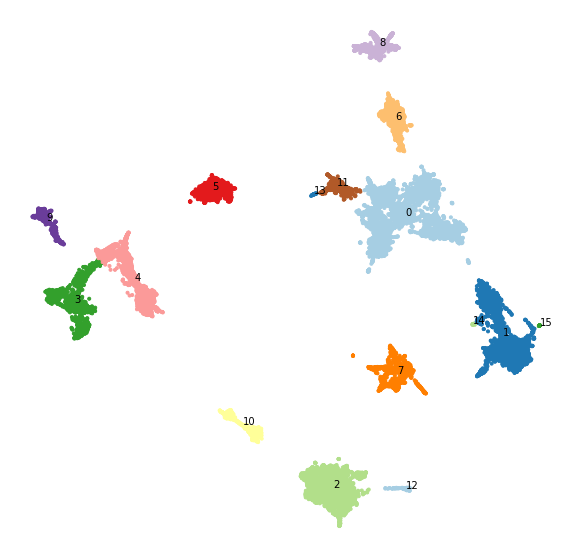

In [35]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)

#### Screen clustering parameters

In [202]:
# net_size_threshold = 0
if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

In [228]:
reload(mosna)

<module 'mosna.mosna' from '/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py'>

In [229]:
predict_key = 'patient'
# predict_key = 'sample'
group_col_cat = 'Response status'

if predict_key == 'patient':
    var_label = patient_col
    status = surv[[group_col_cat]]
    status[group_col] = status[group_col_cat].map({'Responder': 1, 'Non-responder':0})
elif predict_key == 'sample':
    var_label = sample_col

# screen NAS parameters
for dim_clust in tqdm([2, 3, 4, 5], leave=False):
# for dim_clust in tqdm([2], leave=False):
    for n_neighbors in tqdm([15, 45, 75, 100, 200], leave=False):
        for metric in tqdm(['manhattan', 'euclidean', 'cosine'], leave=False):
            # for n_clusters in tqdm(range(3, 20), leave=False):
            for k_cluster in tqdm([15, 50], leave=False):
                for resolution_parameter in tqdm([0.1, 0.03, 0.01, 0.003, 0.001], leave=False):
                    cluster_params = {
                        'reducer_type': 'umap', 
                        'n_neighbors': n_neighbors, 
                        'metric': metric,
                        'min_dist': 0.0,
                        'clusterer_type': 'leiden', 
                        'dim_clust': dim_clust, 
                        'k_cluster': k_cluster, 
                        'resolution_parameter': resolution_parameter,
                        # 'flavor': 'CellCharter',
                        # 'n_clusters': n_clusters,
                    }

                    cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
                    
                    # Survival analysis (just heatmap for now)
                    niches = cluster_labels
                    for normalize in ['total', 'obs', 'clr']:  # no 'niche
                        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                        str_params = str_params + f'_normalize-{normalize}'
                        print(str_params)
                        
                        var_aggreg_niches = var_aggreg_samples_info.copy()
                        var_aggreg_niches['niche'] = np.array(niches)

                        counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize)
                        counts.index = counts.index.astype(status.index.dtype)
                        exo_vars = counts.columns.tolist()
                        df_surv = counts.merge(status, how='inner', on=var_label)
                        # # for samples
                        # counts_clinic = pd.concat([status, counts], axis=1, join='inner').fillna(0)
                        # counts_clinic = counts_clinic.groupby([predict_key, group_col]).mean()

                        # to model data, not to predict from it, do:
                        split_train_test = False
                        models = mosna.logistic_regression(
                            df_surv[exo_vars + [group_col]],
                            y_name=group_col,
                            col_drop=[var_label],
                            cv_train=cv_train, 
                            cv_adapt=cv_adapt, 
                            cv_max=cv_max,
                            plot_coefs=False,
                            split_train_test=split_train_test,
                            )
                        
                        score_roc_auc = np.nanmax([models[model_type]['score']['ROC AUC'] for model_type in models.keys()])
                        print(f'score_roc_auc: {score_roc_auc:.3f}')
                        
                        if score_roc_auc >= 0.7:

                            g, d = mosna.plot_heatmap(
                                df_surv[exo_vars + [group_col]].reset_index(), 
                                obs_labels=var_label, 
                                group_var=group_col, 
                                groups=[0, 1],
                                figsize=(10, 10),
                                z_score=False,
                                cmap=sns.color_palette("Reds", as_cmap=True),
                                return_data=True,
                                )
                            figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}.jpg"
                            plt.savefig(cluster_dir / figname, dpi=150)

                            g, d = mosna.plot_heatmap(
                                df_surv[exo_vars + [group_col]].reset_index(), 
                                obs_labels=var_label, 
                                group_var=group_col, 
                                groups=[0, 1],
                                figsize=(10, 10),
                                z_score=1,
                                cmap=sns.color_palette("Reds", as_cmap=True),
                                return_data=True,
                                )
                            figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}_col_zscored.jpg"
                            plt.savefig(cluster_dir / figname, dpi=150)



Loading clusterer object and cluster labels
There are 23 clusters
Loading reducer object and reduced coordinates


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

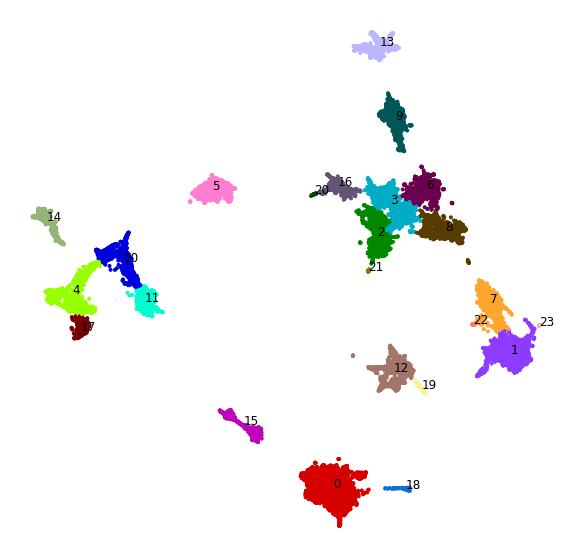

In [62]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type='umap', 
    n_neighbors=15, 
    metric='euclidean',
    )

mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)

Loading clusterer object and cluster labels
There are 18 clusters
Loading reducer object and reduced coordinates


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

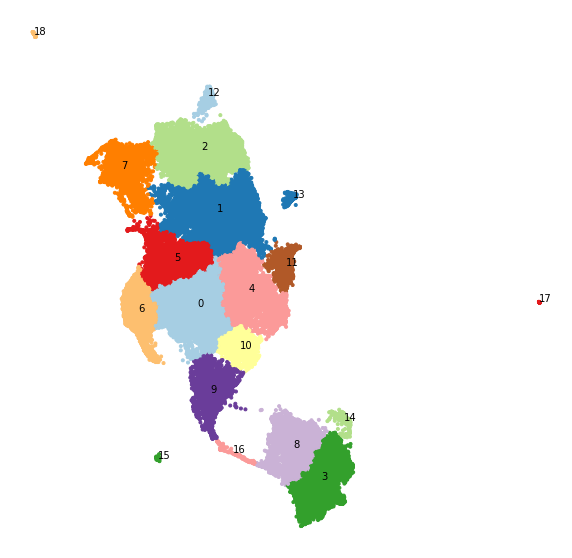

In [ ]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type='umap', 
    n_neighbors=15, 
    metric='euclidean',
    )

mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)

In [200]:
# Merge some small adjacent clusters
# merge_dict = {
#     19: 18,
#     21: 17,
#     24: 1,
#     # 23: 1,
#     # 25: 1,
# }
# merge_dict = {
#     20: 2,
#     18: 16,
#     19: 16,
#     # 23: 1,
#     # 25: 1,
# }
merge_dict = {
    13: 11,
    14: 1,
    15: 1,
    # 23: 1,
    # 25: 1,
}
for old, new in merge_dict.items():
    cluster_labels[cluster_labels == old] = new
    
# rename clusters ordered by size
class_id, class_count = np.unique(cluster_labels, return_counts=True)


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

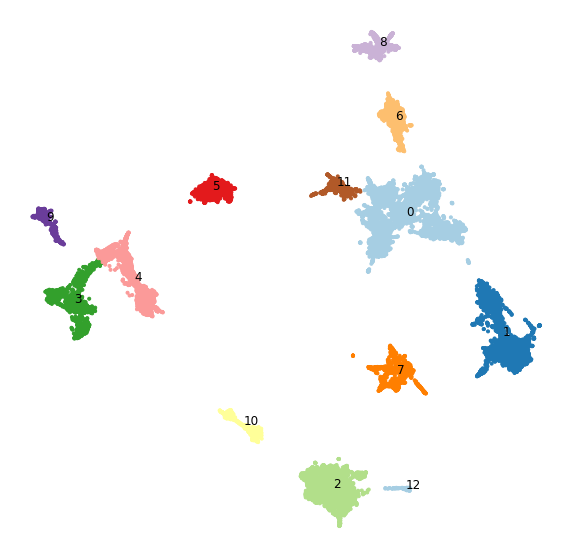

In [201]:
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)

In [30]:
# rename clusters ordered by size
class_id, class_count = np.unique(cluster_labels, return_counts=True)
decreasing_counts_ids = np.argsort(class_count)[::-1]
new_ids = np.arange(len(class_id))[decreasing_counts_ids]
for old, new in zip(class_id, new_ids):
    cluster_labels[cluster_labels == old] = new

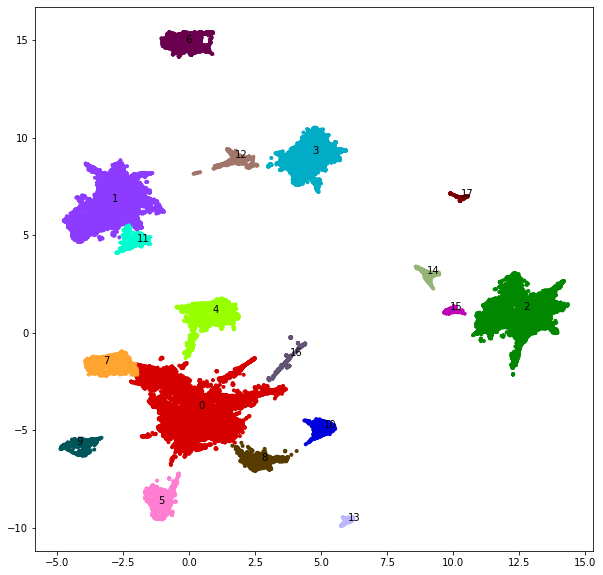

In [31]:
embed_viz = embedding

# choose colormap
if nb_clust < 20:
    clusters_cmap = sns.color_palette('Paired', 20)
    cluster_colors = [clusters_cmap[x] if x >= 0
                      else (0.5, 0.5, 0.5)
                      for x in cluster_labels]
else:
    clusters_cmap = cc.palette["glasbey"]
    # make color mapper
    # series to sort by decreasing order
    uniq = pd.Series(cluster_labels).value_counts().index.astype(int)
    n_colors = len(clusters_cmap)
    labels_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}
    labels_color_mapper[-1] = (0.5, 0.5, 0.5)
    cluster_colors = [labels_color_mapper[x] for x in cluster_labels]

plt.figure(figsize=(10,10))
plt.scatter(embed_viz[:, 0], embed_viz[:, 1], c=cluster_colors, marker='.');

for clust_id in np.unique(cluster_labels):
    clust_targ = cluster_labels == clust_id
    x_mean = embed_viz[clust_targ, 0].mean()
    y_mean = embed_viz[clust_targ, 1].mean()
    plt.text(x_mean, y_mean, str(clust_id))

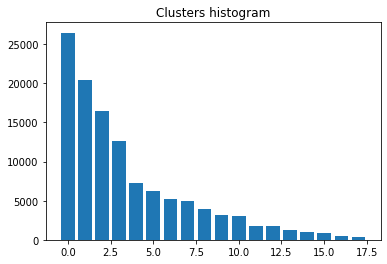

In [32]:
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');

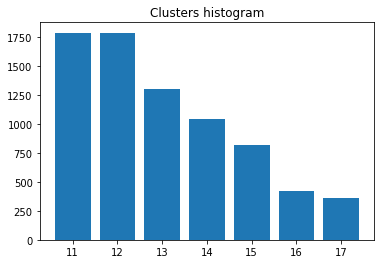

In [33]:
class_id, class_count = np.unique(cluster_labels[cluster_labels > 10], return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');

In [34]:
other_str = '_manual-cleaning'

clusterer_name = f"partition-{'RBConfigurationVertexPartition'}_resolution-{resolution_parameter}{other_str}"
file_path = cluster_dir / clusterer_name

# save cluster labels
np.save(str(file_path) + '.npy', cluster_labels, allow_pickle=False, fix_imports=False)

## Survival analysis

We use labels from the Leiden clustering.

In [202]:
cell_types = nodes_all['CellCluster']
niches = cluster_labels
other_str = ''

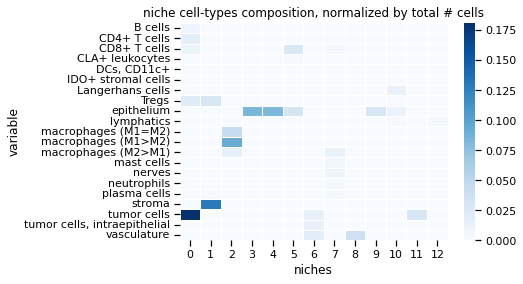

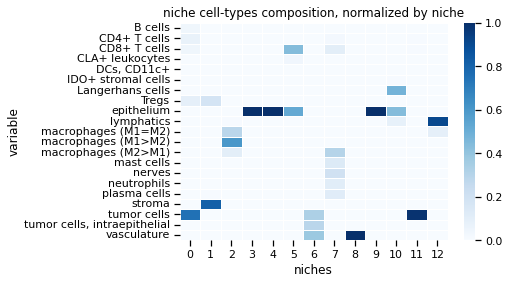

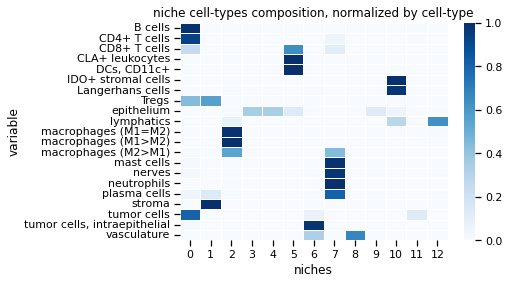

In [203]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

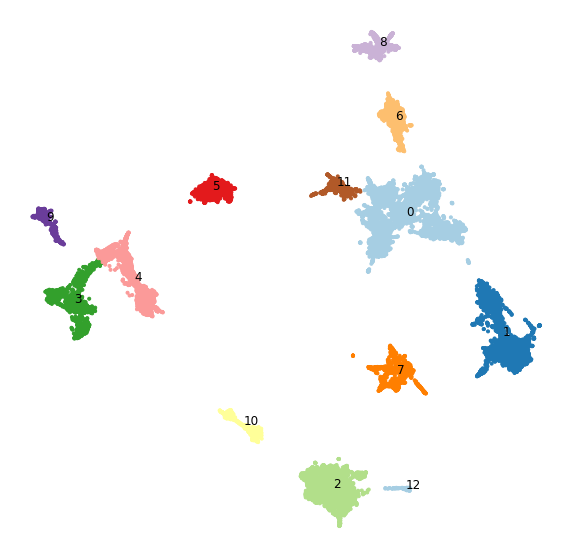

In [204]:
mosna.plot_clusters(embed_viz, cluster_labels, cluster_params=cluster_params)

In [205]:
# proportion of cells in niches per sample
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='obs')
counts

niches,0,1,2,3,4,5,6,7,8,9,10,11,12
variable,,,,,,,,,,,,,
reg001,0.276710,0.243659,0.235972,0.000000,0.000000,0.078401,0.064566,0.069946,0.002306,0.000000,0.026902,0.000000,0.001537
reg002,0.316265,0.260757,0.297762,0.000000,0.000000,0.012909,0.045611,0.052496,0.000430,0.000000,0.012048,0.000861,0.000861
reg005,0.035714,0.419643,0.125000,0.000000,0.000000,0.017857,0.383929,0.008929,0.008929,0.000000,0.000000,0.000000,0.000000
reg006,0.280265,0.281924,0.293532,0.000000,0.000000,0.011609,0.086235,0.016584,0.001658,0.000000,0.028192,0.000000,0.000000
reg009,0.172665,0.083976,0.149957,0.003428,0.413453,0.022708,0.071551,0.033419,0.011997,0.000000,0.035561,0.000857,0.000428
...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,0.311881,0.137376,0.193069,0.000000,0.000000,0.037129,0.043317,0.023515,0.061881,0.153465,0.025990,0.000000,0.012376
reg051,0.198706,0.143253,0.101664,0.393715,0.001848,0.001848,0.007394,0.037893,0.087800,0.000000,0.022181,0.003697,0.000000
reg052,0.149385,0.074985,0.074985,0.579965,0.050967,0.002929,0.005272,0.027534,0.014060,0.000000,0.019918,0.000000,0.000000


In [206]:
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()

In [207]:
counts_clinic

,,0,1,2,3,4,5,6,7,8,9,10,11,12
Patients,Groups,,,,,,,,,,,,,
1,1,0.296488,0.252208,0.266867,0.000000,0.000000,0.045655,0.055088,0.061221,0.001368,0.000000,0.019475,0.000430,0.001199
2,1,0.157990,0.350783,0.209266,0.000000,0.000000,0.014733,0.235082,0.012756,0.005293,0.000000,0.014096,0.000000,0.000000
3,2,0.175419,0.101379,0.137415,0.002221,0.405965,0.022268,0.062933,0.036760,0.020719,0.000000,0.033009,0.001697,0.000214
4,2,0.065573,0.118526,0.100569,0.000394,0.300294,0.013381,0.001748,0.009319,0.060862,0.002756,0.005243,0.319981,0.001354
5,1,0.009548,0.039837,0.024554,0.008147,0.002884,0.885215,0.017890,0.006159,0.000896,0.000000,0.004872,0.000000,0.000000
6,2,0.279430,0.215821,0.218409,0.000000,0.002325,0.140945,0.004567,0.023415,0.053511,0.000000,0.020473,0.020741,0.020364
7,2,0.009309,0.475384,0.064324,0.000000,0.000000,0.000000,0.000000,0.372892,0.068364,0.000000,0.001946,0.000000,0.007782
8,2,0.423863,0.199892,0.082082,0.000523,0.008525,0.007627,0.002172,0.138019,0.066297,0.056789,0.001697,0.000477,0.012038
9,1,0.301893,0.201832,0.110924,0.216314,0.000487,0.043595,0.086409,0.029395,0.001618,0.000000,0.007290,0.000244,0.000000


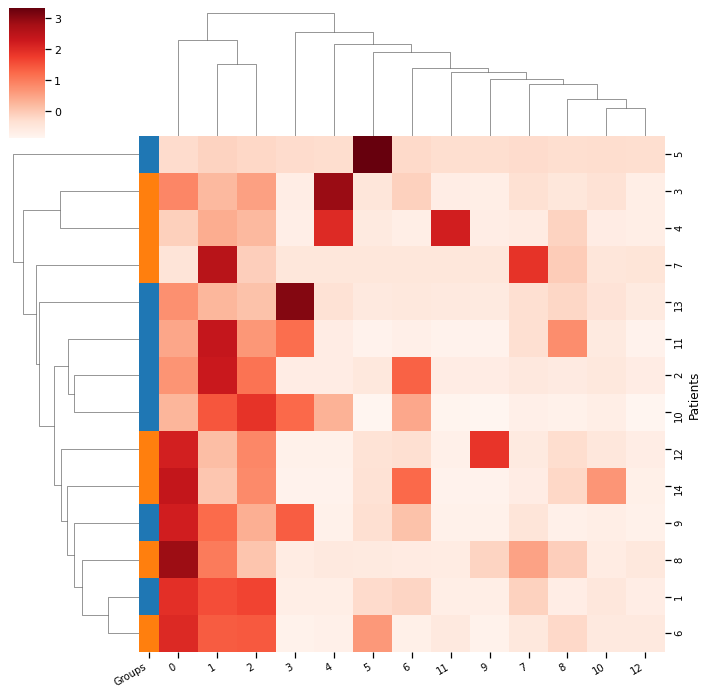

In [208]:
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-obs.png"
plt.savefig(cluster_dir / figname)

In [209]:
# proportion of cells in niches per sample, normalized per niche total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='niche')
counts

niches,0,1,2,3,4,5,6,7,8,9,10,11,12
variable,,,,,,,,,,,,,
reg001,0.039164,0.052302,0.052840,0.000000,0.000000,0.044561,0.045504,0.055966,0.002098,0.000000,0.032649,0.000000,0.009804
reg002,0.079961,0.099984,0.119105,0.000000,0.000000,0.013106,0.057421,0.075031,0.000699,0.000000,0.026119,0.001817,0.009804
reg005,0.000435,0.007754,0.002410,0.000000,0.000000,0.000874,0.023294,0.000615,0.000699,0.000000,0.000000,0.000000,0.000000
reg006,0.018386,0.028048,0.030465,0.000000,0.000000,0.003058,0.028169,0.006150,0.000699,0.000000,0.015858,0.000000,0.000000
reg009,0.043842,0.032338,0.060241,0.002507,0.311190,0.023154,0.090466,0.047970,0.019580,0.000000,0.077425,0.001817,0.004902
...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,0.027415,0.018314,0.026850,0.000000,0.000000,0.013106,0.018960,0.011685,0.034965,0.108581,0.019590,0.000000,0.049020
reg051,0.023390,0.025573,0.018933,0.133500,0.000645,0.000874,0.004334,0.025215,0.066434,0.000000,0.022388,0.003633,0.000000
reg052,0.027742,0.021119,0.022031,0.310248,0.028055,0.002184,0.004875,0.028905,0.016783,0.000000,0.031716,0.000000,0.000000


In [210]:
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()

In [211]:
counts_clinic

,,0,1,2,3,4,5,6,7,8,9,10,11,12
Patients,Groups,,,,,,,,,,,,,
1,1,0.059563,0.076143,0.085972,0.000000,0.000000,0.028834,0.051463,0.065498,0.001399,0.000000,0.029384,0.000908,0.009804
2,1,0.009410,0.017901,0.016437,0.000000,0.000000,0.001966,0.025731,0.003383,0.000699,0.000000,0.007929,0.000000,0.000000
3,2,0.041014,0.035473,0.051291,0.001567,0.282167,0.020970,0.074215,0.048278,0.030070,0.000000,0.066698,0.003179,0.002451
4,2,0.011913,0.030111,0.025990,0.000157,0.144147,0.008956,0.001354,0.008918,0.065035,0.003065,0.006996,0.439146,0.009804
5,1,0.000544,0.003217,0.002151,0.001254,0.000484,0.196811,0.004875,0.001845,0.000350,0.000000,0.002332,0.000000,0.000000
6,2,0.073053,0.085382,0.090534,0.000000,0.001774,0.148318,0.005959,0.034440,0.089161,0.000000,0.045709,0.046776,0.240196
7,2,0.000218,0.014849,0.002238,0.000000,0.000000,0.000000,0.000000,0.047355,0.011189,0.000000,0.000466,0.000000,0.009804
8,2,0.078982,0.049717,0.026104,0.000313,0.005267,0.006262,0.001986,0.129971,0.071329,0.083479,0.002799,0.000606,0.076797
9,1,0.044060,0.029863,0.017814,0.134441,0.000322,0.039100,0.047671,0.017835,0.000699,0.000000,0.007463,0.000454,0.000000


In [212]:
counts_clinic.sum(axis=0)

0     0.460509
1     0.475142
2     0.486948
3     0.499843
4     0.497366
5     0.496869
6     0.499007
7     0.435014
8     0.464336
9     0.458260
10    0.498601
11    0.499697
12    0.461601
dtype: float64

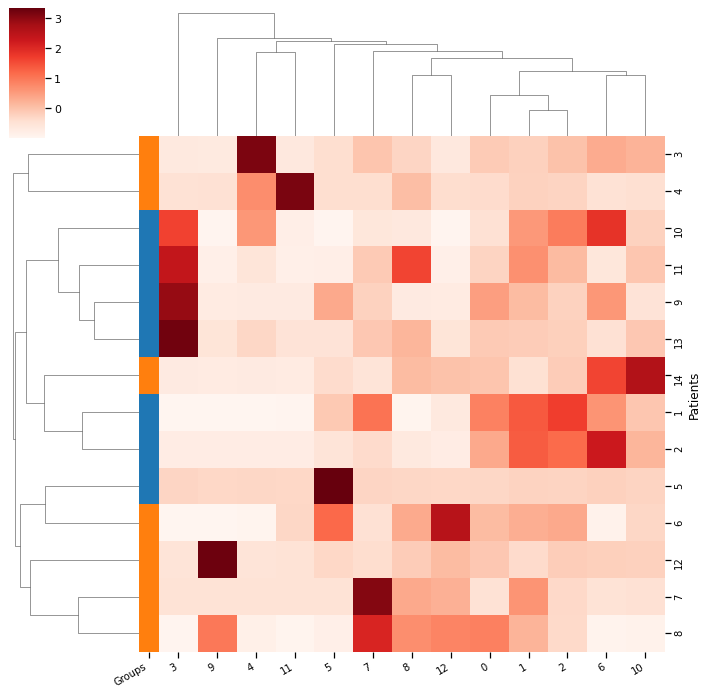

In [213]:
g, d = mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-niche.png"
plt.savefig(cluster_dir / figname)

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

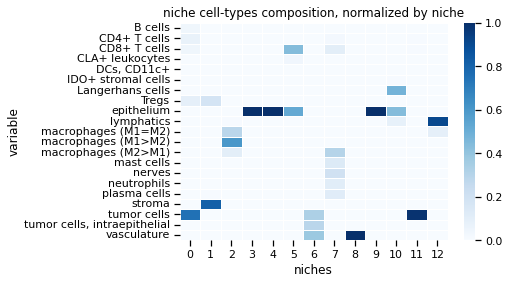

In [214]:
# mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
# plt.title("niche cell-types composition, normalized by total # cells")
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")
# mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
# plt.title("niche cell-types composition, normalized by cell-type")

That look just great, but even if the idea that we should also somehow take into account proportions per niche for normalization sounds correct, it doesn't seem right to ignore proportions per patient. For example if we normalize by the total number of cells we obtain again a very different result:

In [215]:
# proportion of cells in niches per sample, normalized per total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='total')
counts

niches,0,1,2,3,4,5,6,7,8,9,10,11,12
variable,,,,,,,,,,,,,
reg001,0.009458,0.008328,0.008065,0.000000,0.000000,0.002680,0.002207,0.002391,0.000079,0.000000,0.000919,0.000000,0.000053
reg002,0.019309,0.015920,0.018179,0.000000,0.000000,0.000788,0.002785,0.003205,0.000026,0.000000,0.000736,0.000053,0.000053
reg005,0.000105,0.001235,0.000368,0.000000,0.000000,0.000053,0.001130,0.000026,0.000026,0.000000,0.000000,0.000000,0.000000
reg006,0.004440,0.004466,0.004650,0.000000,0.000000,0.000184,0.001366,0.000263,0.000026,0.000000,0.000447,0.000000,0.000000
reg009,0.010587,0.005149,0.009195,0.000210,0.025351,0.001392,0.004387,0.002049,0.000736,0.000000,0.002180,0.000053,0.000026
...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,0.006620,0.002916,0.004098,0.000000,0.000000,0.000788,0.000919,0.000499,0.001314,0.003258,0.000552,0.000000,0.000263
reg051,0.005648,0.004072,0.002890,0.011191,0.000053,0.000053,0.000210,0.001077,0.002496,0.000000,0.000631,0.000105,0.000000
reg052,0.006699,0.003363,0.003363,0.026008,0.002286,0.000131,0.000236,0.001235,0.000631,0.000000,0.000893,0.000000,0.000000


In [216]:
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()

In [217]:
counts_clinic

,,0,1,2,3,4,5,6,7,8,9,10,11,12
Patients,Groups,,,,,,,,,,,,,
1,1,0.014383,0.012124,0.013122,0.000000,0.000000,0.001734,0.002496,0.002798,0.000053,0.000000,0.000828,0.000026,0.000053
2,1,0.002272,0.002850,0.002509,0.000000,0.000000,0.000118,0.001248,0.000144,0.000026,0.000000,0.000223,0.000000,0.000000
3,2,0.009904,0.005648,0.007829,0.000131,0.022987,0.001261,0.003599,0.002062,0.001130,0.000000,0.001878,0.000092,0.000013
4,2,0.002877,0.004794,0.003967,0.000013,0.011743,0.000539,0.000066,0.000381,0.002443,0.000092,0.000197,0.012702,0.000053
5,1,0.000131,0.000512,0.000328,0.000105,0.000039,0.011835,0.000236,0.000079,0.000013,0.000000,0.000066,0.000000,0.000000
6,2,0.017641,0.013595,0.013818,0.000000,0.000144,0.008919,0.000289,0.001471,0.003350,0.000000,0.001287,0.001353,0.001287
7,2,0.000053,0.002364,0.000342,0.000000,0.000000,0.000000,0.000000,0.002023,0.000420,0.000000,0.000013,0.000000,0.000053
8,2,0.019073,0.007916,0.003984,0.000026,0.000429,0.000377,0.000096,0.005552,0.002680,0.002504,0.000079,0.000018,0.000412
9,1,0.010640,0.004755,0.002719,0.011270,0.000026,0.002351,0.002312,0.000762,0.000026,0.000000,0.000210,0.000013,0.000000


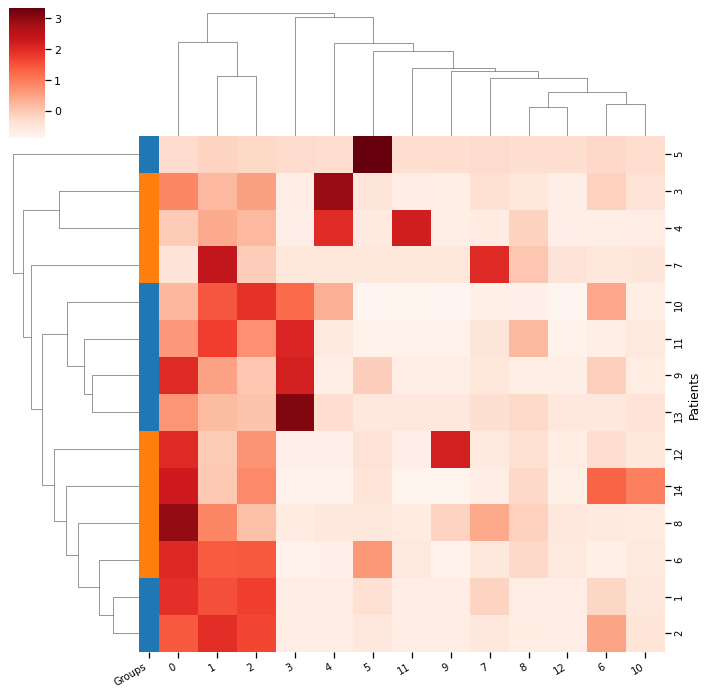

In [218]:
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-total.png"
plt.savefig(cluster_dir / figname)

A more statistically sound way to take jointly into account proportions per variable and per observation is the Central Log Ratio, that we already applied to protein composition:

In [219]:
# proportion of cells in niches per sample, normalized with Central Log Ratio
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='clr')
counts

niches,0,1,2,3,4,5,6,7,8,9,10,11,12
variable,,,,,,,,,,,,,
reg001,4.490486,4.363284,4.331230,-5.931262,-5.931262,3.229355,3.035199,3.115242,-0.297006,-5.931262,2.159730,-5.931262,-0.702471
reg002,4.790135,4.597145,4.729851,-6.345380,-6.345380,1.591462,2.853704,2.994286,-1.809735,-6.345380,1.522469,-1.116588,-1.116588
reg005,2.531219,4.995072,3.783982,-3.390720,-3.390720,1.838072,4.906125,1.144924,1.144924,-3.390720,-3.390720,-3.390720,-3.390720
reg006,4.837854,4.843754,4.884105,-4.827689,-4.827689,1.653866,3.659199,2.010541,-0.292045,-4.827689,2.541169,-4.827689,-4.827689
reg009,2.657391,1.936569,2.516387,-1.262104,3.530582,0.628746,1.776448,1.015163,-0.009341,-7.877190,1.077295,-2.648399,-3.341546
...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,3.555408,2.735509,3.075835,-6.509666,-6.509666,1.427176,1.581327,0.970417,1.938002,2.846260,1.070501,-6.509666,0.328564
reg051,3.186390,2.859177,2.516232,3.870191,-1.491101,-1.491101,-0.104807,1.529324,2.369629,-6.719892,0.993806,-0.797954,-6.719892
reg052,3.436400,2.747166,2.747166,4.792841,2.361044,-0.495426,0.092361,1.745284,1.073190,-6.640508,1.421497,-6.640508,-6.640508


In [220]:
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()

In [221]:
counts_clinic

,,0,1,2,3,4,5,6,7,8,9,10,11,12
Patients,Groups,,,,,,,,,,,,,
1,1,4.640311,4.480214,4.530540,-6.138321,-6.138321,2.410408,2.944451,3.054764,-1.053371,-6.138321,1.841100,-3.523925,-0.909530
2,1,3.684537,4.919413,4.334044,-4.109204,-4.109204,1.745969,4.282662,1.577733,0.426440,-4.109204,-0.424775,-4.109204,-4.109204
3,2,2.809985,2.246842,2.561756,-1.733582,3.649030,0.745870,1.775535,1.243202,0.576448,-7.655520,1.136716,-1.968584,-5.387698
4,2,1.505367,2.331608,2.169266,-5.110877,3.258399,0.152677,-1.947176,-0.219543,1.668227,-4.137922,-0.848563,3.328447,-2.149908
5,1,1.289039,2.695744,2.285254,1.120802,0.113351,5.870298,1.964002,0.806498,-2.501045,-4.768867,0.662657,-4.768867,-4.768867
6,2,3.708084,3.446781,3.460266,-7.336841,-1.212170,3.021954,-0.407451,1.216281,2.017456,-7.336841,1.085390,-2.751654,1.088746
7,2,1.846954,5.793491,3.812867,-3.237996,-3.237996,-3.237996,-3.237996,5.564968,3.656897,-3.237996,-0.970174,-3.237996,-0.277027
8,2,3.939494,3.151158,2.038240,-3.827018,-4.272675,-0.544890,-1.435451,2.632931,2.055703,1.929460,-1.621989,-4.058067,0.013102
9,1,4.649180,4.012481,3.459126,3.472269,-3.101122,-0.854003,3.289589,2.185038,-3.101122,-5.715518,0.867298,-3.447696,-5.715518


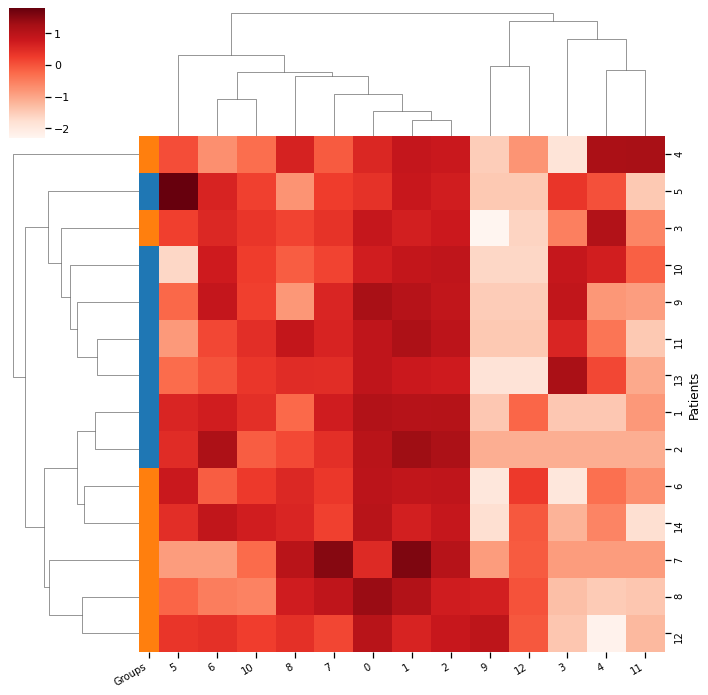

In [222]:
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-clr.png"
plt.savefig(cluster_dir / figname)

With this more statistically sound way of normalizing data we still obtain a good, although not perfect, blind clustering of patients into responders and non responders.

In [189]:
# the colorbar is just wrong
import seaborn as sns
cm = sns.light_palette("green", as_cmap=True)
s = d.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
Patients,,,,,,,,,,,,,,,,,,
1,4.709711,4.079832,4.234183,-6.017335,-3.378078,-1.085394,2.526618,3.553021,3.609602,3.066606,0.662860,3.155751,-3.031504,-6.017335,2.011808,-6.017335,-3.378078,-2.684931
2,4.786449,3.235278,5.329225,-3.709339,-3.709339,-1.416655,2.027321,-0.097126,3.710969,4.673722,1.771908,1.974641,-3.709339,-3.709339,-0.030361,-3.709339,-3.709339,-3.709339
3,3.060523,3.284595,2.458749,-1.278826,4.137485,-4.925535,1.177501,1.287895,-0.697251,2.281961,1.081018,0.800615,-1.390398,-7.218219,1.599045,-1.736972,-4.925535,1.003348
4,3.745875,3.309193,3.875648,-2.366848,4.825989,-3.565796,1.702209,0.336326,-5.858480,-0.377232,3.238170,1.086137,4.843574,-5.858480,0.721380,-5.858480,-0.926538,-2.872649
5,3.017820,1.317221,3.231542,2.290176,1.061808,-4.072865,6.608981,1.408382,1.408382,2.709727,-1.780182,1.552223,-4.072865,-4.072865,1.611114,-4.072865,-4.072865,-4.072865
6,3.428415,2.786507,3.003251,-7.422767,-1.248372,3.055464,2.955289,2.304196,-1.074219,-0.284427,1.981254,0.913970,-2.964717,-7.422767,0.891694,-1.189481,1.052543,-0.765832
7,4.324976,2.048038,6.222188,-2.883903,-2.883903,-0.591219,-2.883903,-2.883903,-2.883903,-0.591219,3.983638,5.913345,-2.883903,-2.883903,-0.591219,-2.883903,0.101928,2.250770
8,2.488410,2.296509,2.005034,0.615781,-4.175148,3.336321,-0.385828,2.993825,-0.119659,-3.266943,2.214765,2.510396,-3.915580,0.949725,-1.558822,-5.444036,0.172164,-0.716912
9,3.645428,4.771651,4.157127,3.599711,-0.208283,-3.305686,-0.723293,0.026719,1.269172,3.434813,-2.500967,2.007126,-3.305686,-5.598369,0.981490,-3.305686,-5.598369,0.653100


In [190]:
pvals = mosna.find_DE_markers(counts_clinic, group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [191]:
pvals.head(20)

,pval,pval_corr
16,0.008159,0.146853
8,0.053030,0.159091
1,0.053030,0.159091
2,0.053030,0.159091
3,0.053030,0.159091
11,0.053030,0.159091
5,0.212121,0.424242
14,0.212121,0.424242
9,0.212121,0.424242
15,0.575175,0.647072


In [261]:
counts_clinic

,,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
Patients,Groups,,,,,,,,,,,,,,,,
1,1,0.082975,0.083997,0.006266,0.070380,0.000304,0.000154,0.028370,0.083745,0.007651,0.064757,0.093058,0.000000,0.050091,0.000000,0.016279,0.005155
2,1,0.013497,0.015936,0.000989,0.023654,0.000000,0.000000,0.001589,0.004119,0.002661,0.031005,0.005030,0.000000,0.013661,0.000000,0.002326,0.000000
3,2,0.067025,0.050963,0.003408,0.040084,0.265359,0.002304,0.020881,0.028281,0.029607,0.082025,0.029175,0.000000,0.109290,0.007447,0.002326,0.005155
4,2,0.016334,0.025315,0.107960,0.041715,0.135189,0.002151,0.009079,0.002471,0.061876,0.000785,0.010060,0.000000,0.012750,0.000000,0.002326,0.005155
5,1,0.001150,0.002075,0.000000,0.003962,0.000912,0.002765,0.200409,0.000824,0.000333,0.007064,0.002515,0.000000,0.005464,0.002128,0.000000,0.000000
6,2,0.026074,0.088479,0.129068,0.082382,0.001673,0.000000,0.146618,0.089237,0.084830,0.006672,0.042757,0.000000,0.068306,0.011702,0.000000,0.247423
7,2,0.000383,0.002407,0.000330,0.021906,0.000000,0.000000,0.000000,0.000549,0.008649,0.000000,0.070926,0.000000,0.000911,0.000000,0.004651,0.010309
8,2,0.015491,0.032703,0.140721,0.023693,0.004968,0.020276,0.006204,0.114406,0.067642,0.002093,0.079142,0.033115,0.004857,0.000709,0.308527,0.080756
9,1,0.062347,0.017513,0.001429,0.041715,0.001369,0.131951,0.038130,0.002197,0.002329,0.065934,0.020121,0.000000,0.010929,0.004255,0.002326,0.000000


From this plot we would like to add niches 4 and 17 to those that seggregate patients into groups 1 and 2.

Add                              16 with p-value 0.000363948
Add                               4 with p-value 0.0406529
Add                              17 with p-value 0.0424053
Add                               2 with p-value 0.0361688


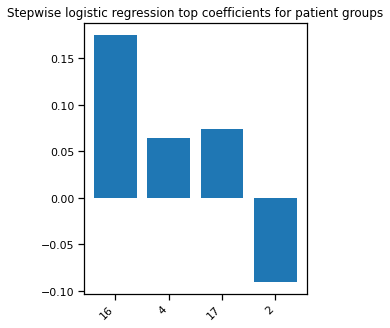

In [196]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=counts_clinic, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no niche statistically related to response group")

##### Elasticnet logistic regression







-------------------------------------------
------------------- END -------------------
-------------------------------------------
Training took {duration}s


<Figure size 432x288 with 0 Axes>

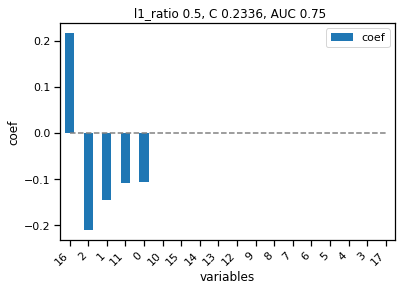

<Figure size 432x288 with 0 Axes>

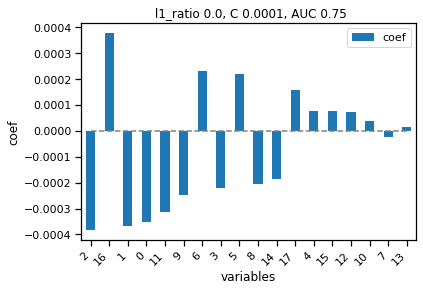

<Figure size 432x288 with 0 Axes>

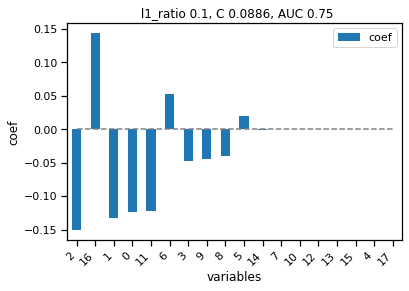

In [200]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [ ]:
# save_dir = cluster_dir / (clusterer_name + "_spatial_networks_figures")
# save_dir.mkdir(parents=True, exist_ok=True)

# sample_ids = [
#     "reg001",
#     "reg003",
#     "reg005",
#     "reg006",
#     "reg037",
#     "reg040",
#     "reg042",
#     "reg051",
#     "reg054",
#     "reg055",
#     "reg016",
#     "reg058",
#     "reg060",
#     "reg019",
# ]

# # choose colormap
# if nb_clust <= 20:
#     clusters_cmap = sns.color_palette('Paired', 20)
#     cluster_colors = [clusters_cmap[x] if x >= 0
#                       else (0.5, 0.5, 0.5)
#                       for x in cluster_labels]
# else:
#     clusters_cmap = cc.palette["glasbey"]
#     # make color mapper
#     # series to sort by decreasing order
#     uniq = pd.Series(cluster_labels).value_counts().index.astype(int)
#     n_colors = len(clusters_cmap)
#     labels_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}
#     labels_color_mapper[-1] = (0.5, 0.5, 0.5)
#     cluster_colors = np.array([labels_color_mapper[x] for x in cluster_labels])

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]

# plots_marker = '.'
# for sample in sample_ids:
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values

#     # Big summary plot
#     fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
#     i = 0
#     ty.plot_network(coords, pairs, labels=obj.loc[select, pheno_col], cmap_nodes=palette, marker=plots_marker, size_nodes=size_points, ax=ax[0])
#     ax[i].set_title('Spatial map of phenotypes', fontsize=14);

#     i += 1
#     ax[i].scatter(coords[:, 0], coords[:, 1], c=cluster_colors[select], marker=plots_marker, s=size_points)
#     ax[i].set_title('Spatial map of detected areas', fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=cluster_colors[select], s=5);
#     ax[i].set_title("HDBSCAN clustering on NAS", fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=cluster_colors);
#     ax[i].set_title("HDBSCAN clustering on NAS of all samples", fontsize=14);
#     ax[i].set_aspect('equal')
    
#     # make plot limits equal
#     ax[i-1].set_xlim(ax[i].get_xlim())
#     ax[i-1].set_ylim(ax[i].get_ylim())

#     suptitle = f"Spatial omics data and detected areas - sample {sample}";
#     fig.suptitle(suptitle, fontsize=18)

#     fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)

#### Explore different clustering wrt survival

In [ ]:
# for dim_clust in tqdm([2, 3, 4, 5], leave=False):
# aaaaaaaaaaa
for dim_clust in tqdm([2], leave=False):
    for n_neighbors in tqdm([15, 45, 75, 100, 200], leave=False):
        for metric in tqdm(['euclidean', 'cosine'], leave=False):
            for k_cluster in tqdm([15, 50], leave=False):
                for resolution_parameter in [0.005, 0.01, 0.05, 0.1, 0.5]:
                    cluster_params = {
                        'reducer_type': 'umap', 
                        'n_neighbors': n_neighbors, 
                        'metric': metric,
                        'min_dist': 0.0,
                        'clusterer_type': 'leiden', 
                        'dim_clust': dim_clust, 
                        'k_cluster': 15, 
                        'resolution_parameter': resolution_parameter,
                    }

                    cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

                    # Survival analysis (just heatmap for now)
                    niches = cluster_labels
                    for normalize in ['total', 'niche', 'obs', 'clr']:
                        counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize=normalize)
                        # merge clinical data and proportion of cells in niches per sample
                        # counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
                        counts_clinic = pd.concat([status, counts], axis=1, join='inner').fillna(0)
                        # counts_clinic.drop(columns=['Spots'], inplace=True)
                        counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()

                        # plot heatmap
                        g, d = mosna.plot_heatmap(
                            counts_clinic.reset_index(), 
                            obs_labels=patient_col, 
                            group_var=group_col, 
                            groups=[1, 2],
                            figsize=(10, 10),
                            z_score=False,
                            cmap=sns.color_palette("Reds", as_cmap=True),
                            return_data=True,
                            )
                        # str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                        figname = f"biclustering_resolution-{resolution_parameter}_normalized-{normalize}.png"
                        plt.savefig(cluster_dir / figname, dpi=150)

### Final parameters

```
reducer-umap_dim-2_nneigh-200_metric-euclidean_min_dist-0.0/clusterer-leiden_n_neighbors-15/biclustering_resolution-0.05_normalized-niche  
reducer-umap_dim-2_nneigh-75_metric-euclidean_min_dist-0.0/clusterer-leiden_n_neighbors-15/biclustering_resolution-0.05_normalized-clr  
reducer-umap_dim-2_nneigh-75_metric-euclidean_min_dist-0.0/clusterer-leiden_n_neighbors-15/biclustering_resolution-0.05_normalized-obs
```

#### nneigh = 75

In [212]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading clusterer object and cluster labels
There are 17 clusters


In [213]:
sof_dir

PosixPath('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_trim_dist-200_solitary-0/nas_on-markers_stats-mean-std_order-1')

Loading reducer object and reduced coordinates


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

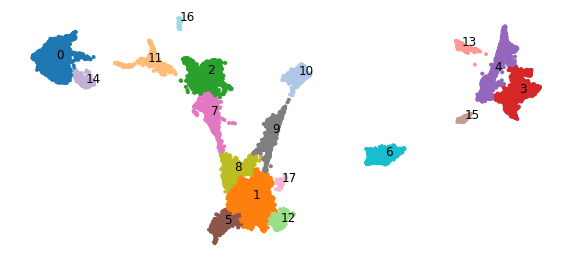

In [214]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)

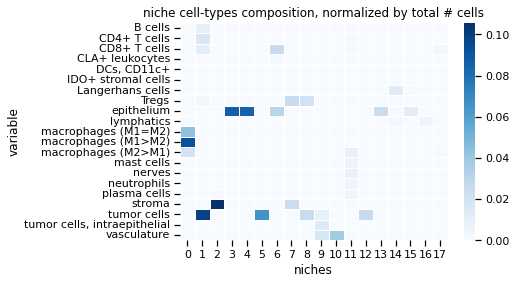

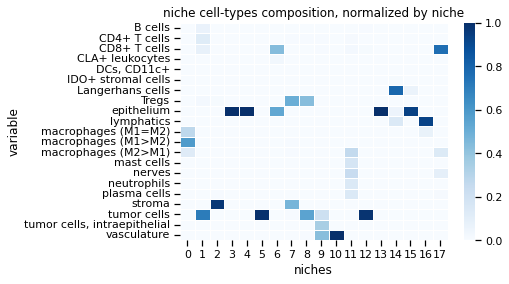

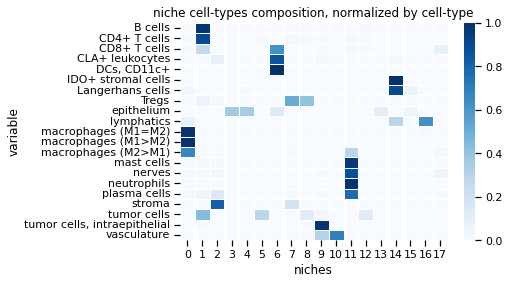

In [215]:
# Survival analysis

cell_types = nodes_all['CellCluster']
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

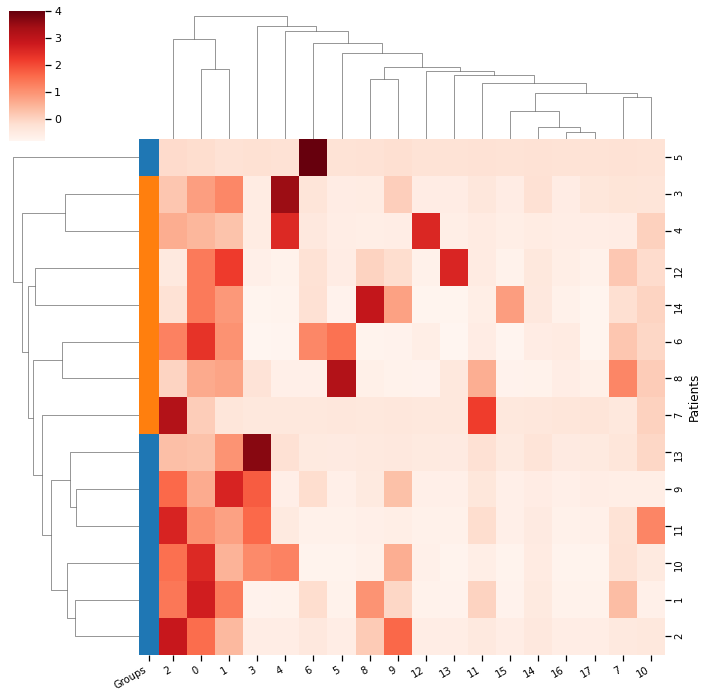

In [216]:
# proportion of cells in niches per sample
other_str = ''
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='obs')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-obs.png"
plt.savefig(cluster_dir / figname)

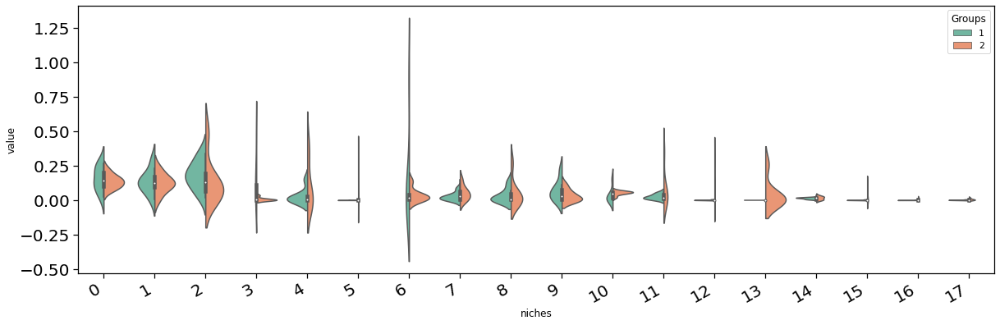

In [217]:
pvals = mosna.find_DE_markers(counts_clinic, group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

# DE analysis
fig, ax = mosna.plot_distrib_groups(
    counts_clinic, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=None,
    multi_ind_to_col=True,
    var_name='niches',
    )

Add                              16 with p-value 0.0100267
Add                               4 with p-value 0.00839606


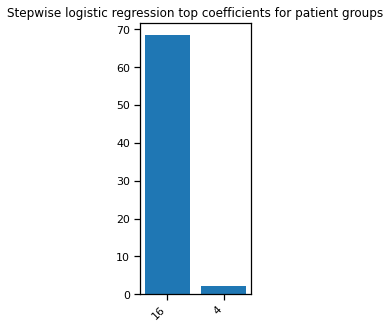

In [218]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=counts_clinic, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no niche statistically related to response group")

Training took {duration}s


<Figure size 432x288 with 0 Axes>

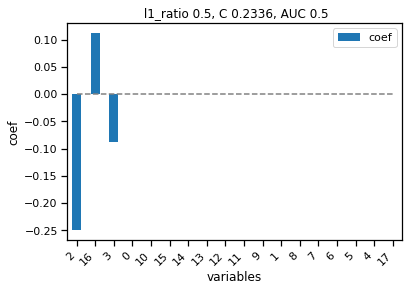

<Figure size 432x288 with 0 Axes>

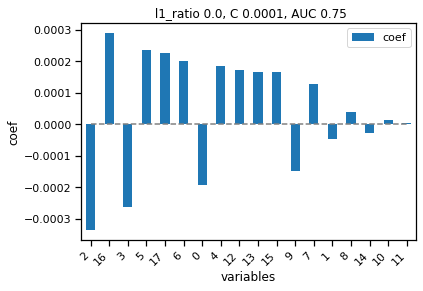

<Figure size 432x288 with 0 Axes>

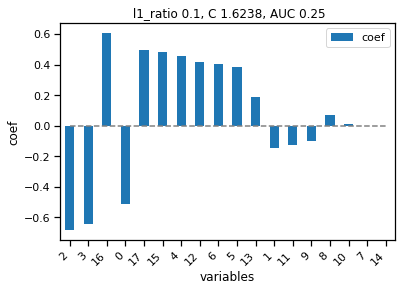

In [219]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

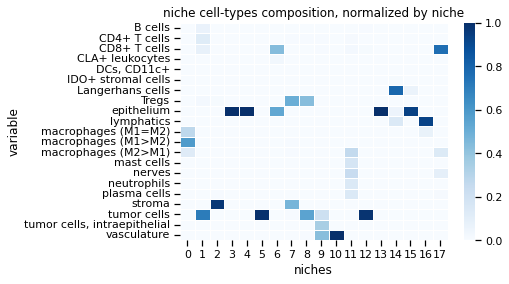

In [220]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

Ok not so interesting, and perfomances are not great

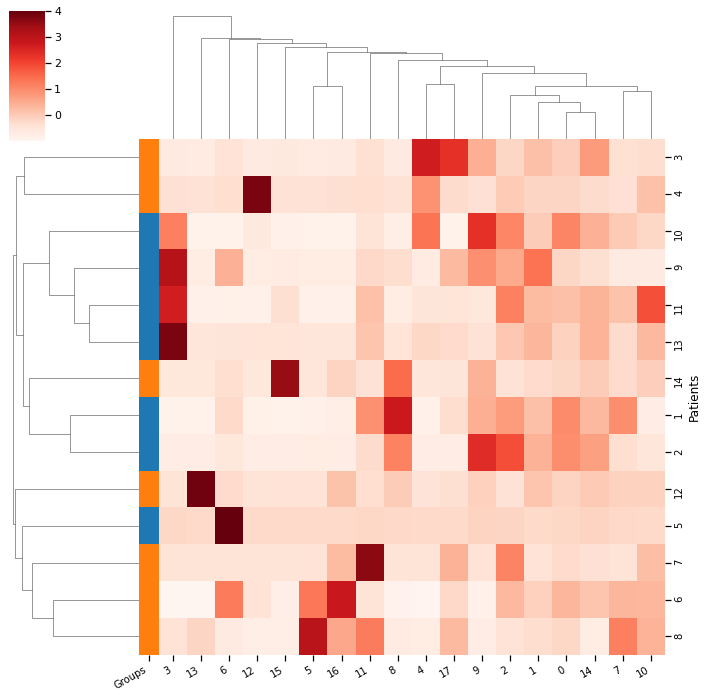

In [160]:
# proportion of cells in niches per sample, normalized per niche total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='niche')
# merge clinical data and proportion of cells
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d = mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-niche.png"
plt.savefig(cluster_dir / figname)

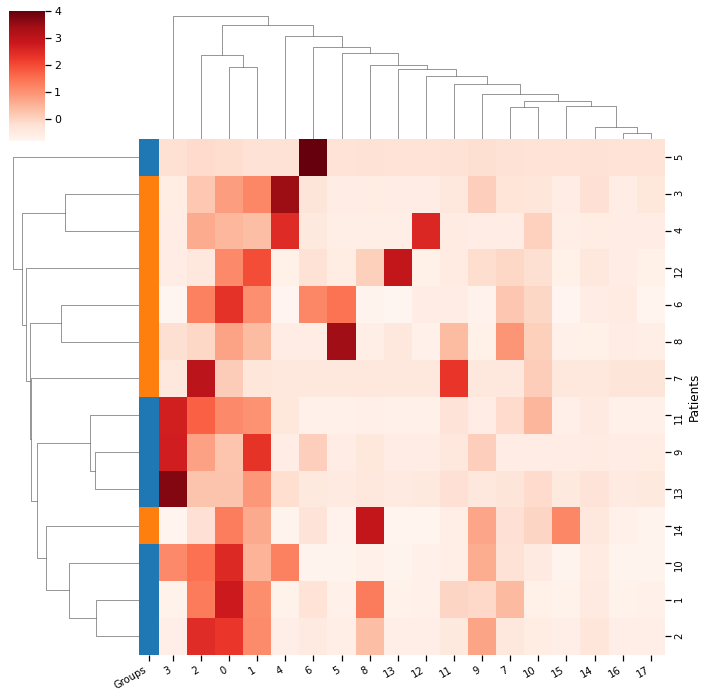

In [161]:
# proportion of cells in niches per sample, normalized per total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='total')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-total.png"
plt.savefig(cluster_dir / figname)


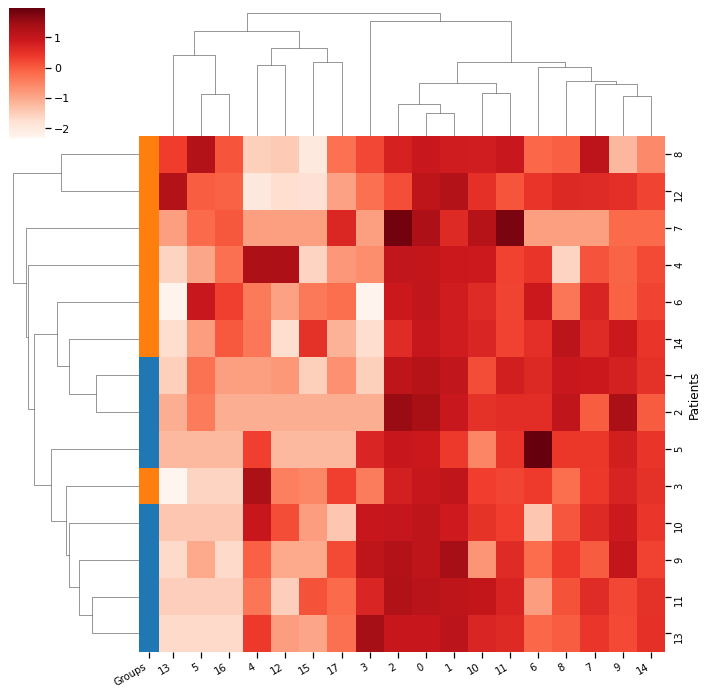

In [162]:
# proportion of cells in niches per sample, normalized with Central Log Ratio
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='clr')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-clr.png"
plt.savefig(cluster_dir / figname)

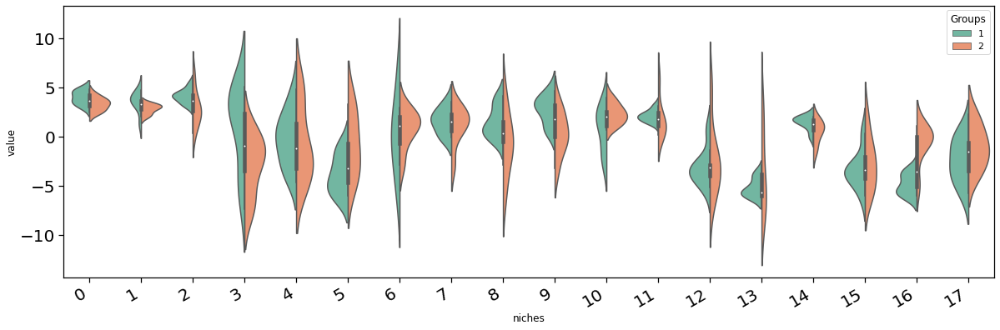

In [163]:
pvals = mosna.find_DE_markers(counts_clinic, group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

# DE analysis
fig, ax = mosna.plot_distrib_groups(
    counts_clinic, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=None,
    multi_ind_to_col=True,
    var_name='niches',
    )

Add                              16 with p-value 0.000363948
Add                               4 with p-value 0.0406529
Add                              17 with p-value 0.0424053
Add                               2 with p-value 0.0361688


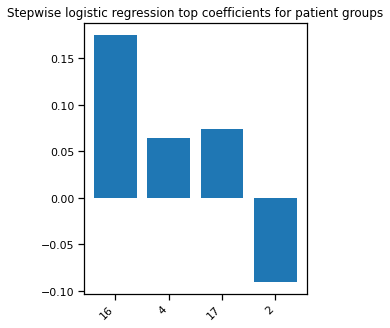

In [164]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=counts_clinic, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no niche statistically related to response group")

Training took {duration}s


<Figure size 432x288 with 0 Axes>

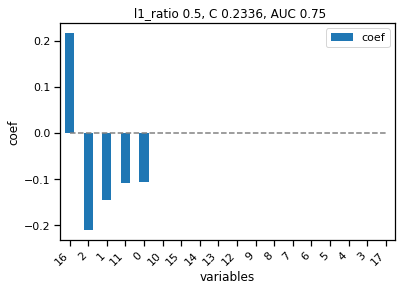

<Figure size 432x288 with 0 Axes>

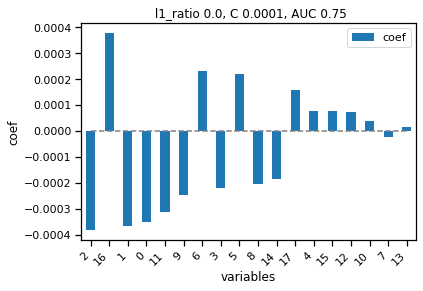

<Figure size 432x288 with 0 Axes>

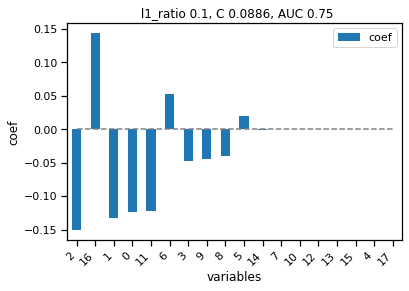

In [165]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

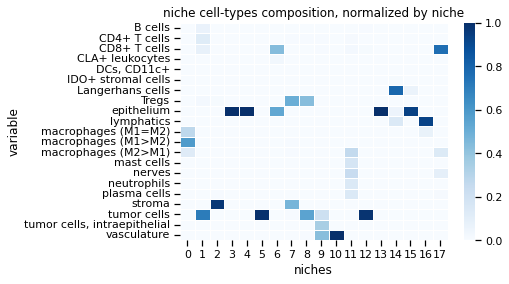

In [80]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

AUC 0.75

Niches that matter:
  - 16: lymphatics + macrophages (M1=M2)
  - 2: stroma only
  - 1: tumor cells + B cells + CD4+ T cells + CD8+ T cells
  - 0: macrophages, all 3 definitions
Interestingly, niches of pure epithelium or *even* pure cancer cells don't matter.

Also from step-wise LR:
  - 16: lymphatics + macrophages (M1=M2)
  - 4: epithelium
  - 17: CD8+ T cells + macrophages (M2 > M1)
  - 2: stroma

#### nneigh = 200

In [44]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading clusterer object and cluster labels
There are 15 clusters


In [46]:
sof_dir

PosixPath('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_trim_dist-200_solitary-0/nas_on-markers_stats-mean-std_order-1')

Loading reducer object and reduced coordinates


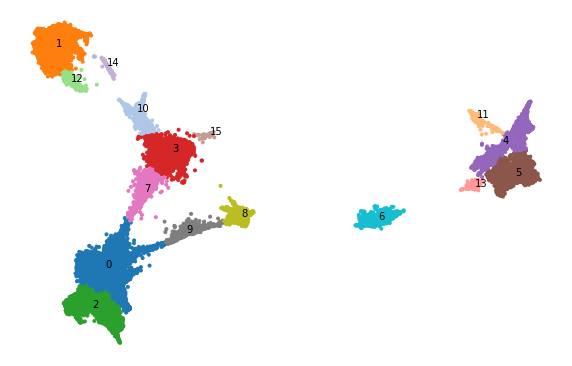

In [47]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

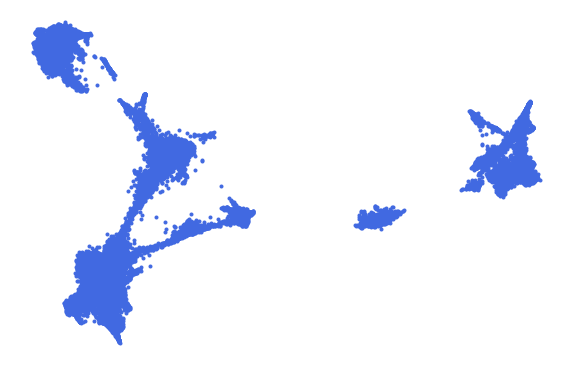

In [177]:
fig, ax = mosna.plot_clusters(embed_viz, save_dir=sof_dir, extra_str='_no_clustering', show_id=False, cluster_params=cluster_params, return_cmap=False)

Loading reducer object and reduced coordinates


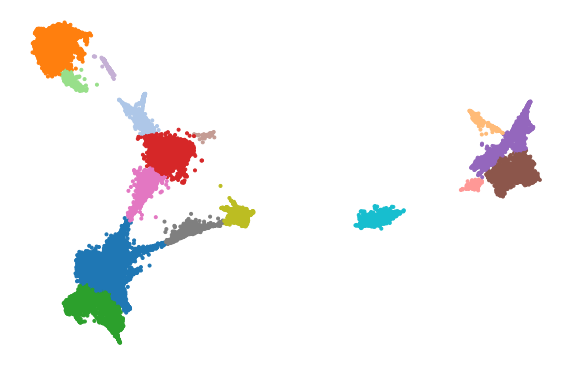

In [179]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, extra_str='_no_cluster_id', show_id=False, cluster_params=cluster_params, return_cmap=True)

In [ ]:
# save_dir = cluster_dir / 'spatial_networks_niches'
# save_dir.mkdir(parents=True, exist_ok=True)

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
# niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])

# plots_marker = '.'
# for sample in obj[sample_col].unique():
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     # TODO: find a way to reuse pairs compatible with aggregated nodes
#     # pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values
#     pairs = ty.build_delaunay(coords, trim_dist=trim_dist)
#     if k_sol > 0:
#         pairs = ty.link_solitaries(coords, pairs, method='knn', k=k_sol)

    # # Big summary plot
    # fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
    # i = 0
    # ty.plot_network(coords, 
    #                 pairs,
    #                 labels=obj.loc[select, pheno_col], 
    #                 color_mapper=celltypes_color_mapper, 
    #                 marker=plots_marker, 
    #                 size_nodes=size_points, 
    #                 ax=ax[0])
    # ax[i].set_title('Spatial map of phenotypes', fontsize=14);

    # i += 1
    # ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points)
    # ax[i].set_title('Spatial map of detected areas', fontsize=14);
    # ax[i].set_aspect('equal')

    # i += 1
    # ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=5);
    # ax[i].set_title("Clustering on NAS", fontsize=14);
    # ax[i].set_aspect('equal')

    # i += 1
    # ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors);
    # ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
    # ax[i].set_aspect('equal')
    
    # # make plot limits equal
    # ax[i-1].set_xlim(ax[i].get_xlim())
    # ax[i-1].set_ylim(ax[i].get_ylim())

    # suptitle = f"Spatial omics data and detected areas - sample {sample}";
    # fig.suptitle(suptitle, fontsize=18)

    # fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=600)
    # plt.show()


    # fig, ax = plt.subplots(figsize=(10, 10))
    # ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*4)
    # ax.set_title('Spatial map of detected areas', fontsize=14);
    # ax.set_aspect('equal')
    # fig.savefig(save_dir / f'spatial_niches_sample-{sample}_bignodes', bbox_inches='tight', facecolor='white', dpi=600)
    # plt.show()

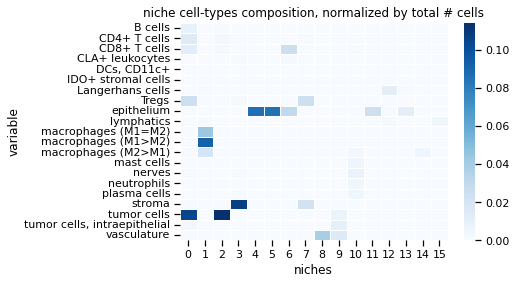

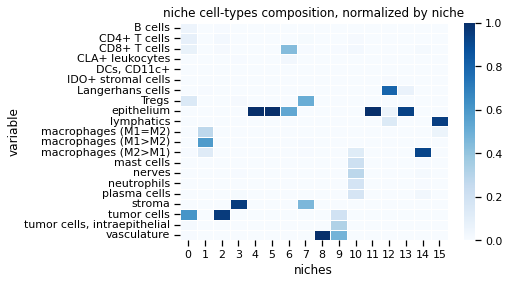

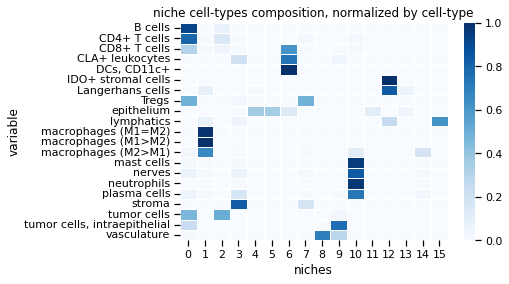

In [225]:
# Survival analysis

cell_types = nodes_all['CellCluster']
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

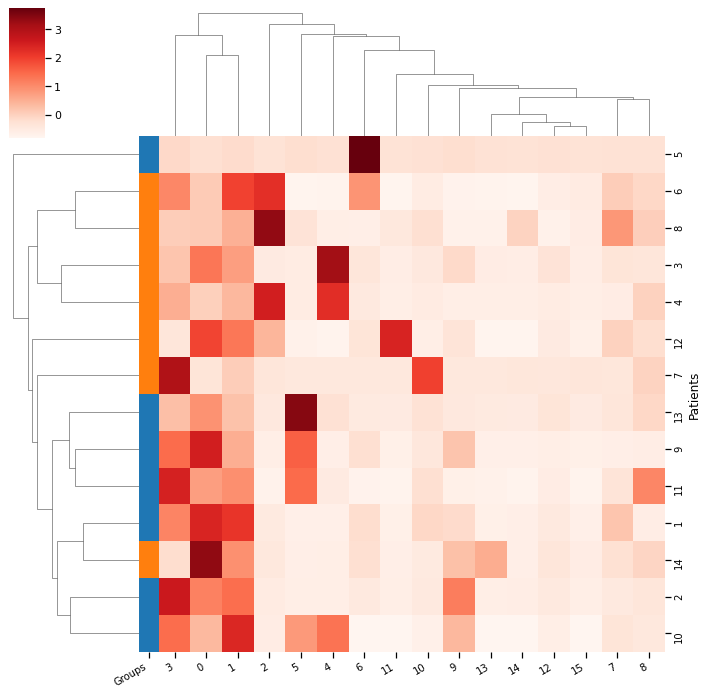

In [226]:
# proportion of cells in niches per sample
other_str = ''
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='obs')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-obs.png"
plt.savefig(cluster_dir / figname)

Training took {duration}s


<Figure size 432x288 with 0 Axes>

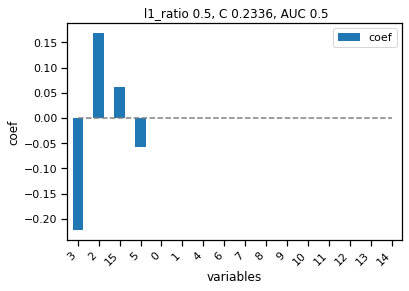

<Figure size 432x288 with 0 Axes>

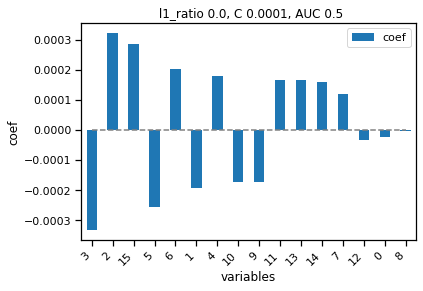

<Figure size 432x288 with 0 Axes>

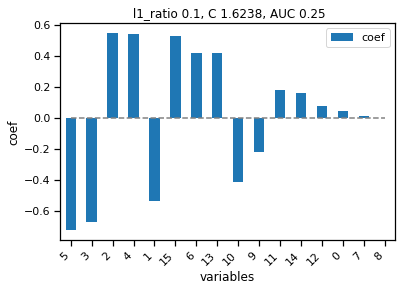

In [227]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

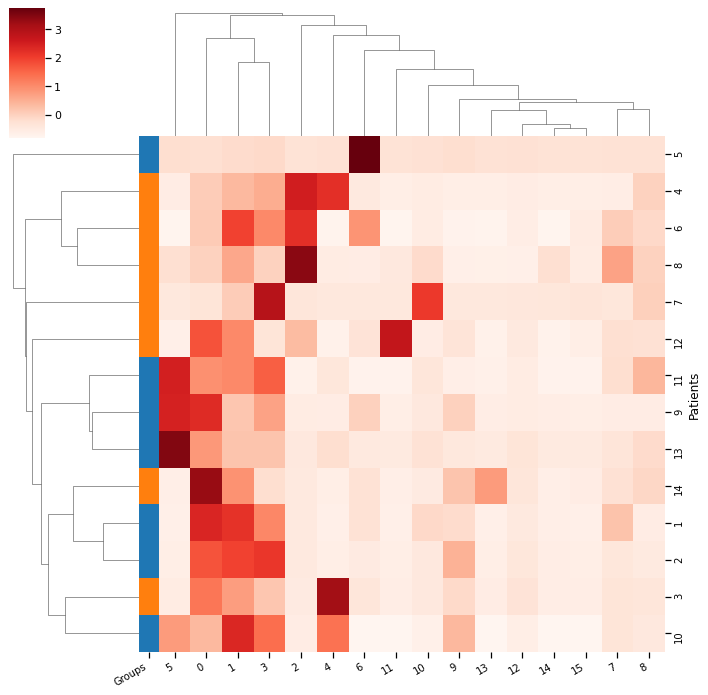

In [228]:
# proportion of cells in niches per sample, normalized per total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='total')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-total.png"
plt.savefig(cluster_dir / figname)


Training took {duration}s


<Figure size 432x288 with 0 Axes>

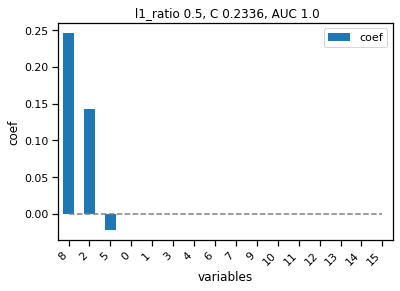

<Figure size 432x288 with 0 Axes>

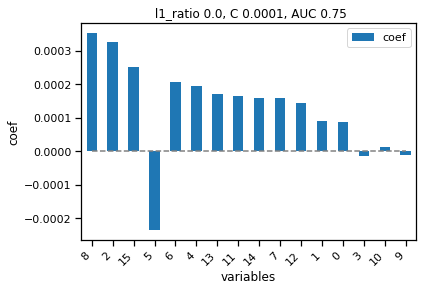

<Figure size 432x288 with 0 Axes>

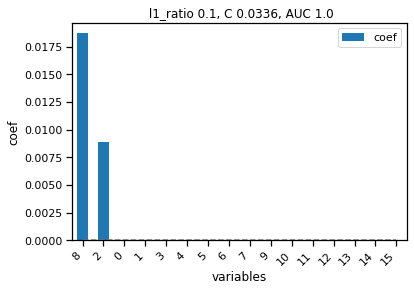

In [230]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

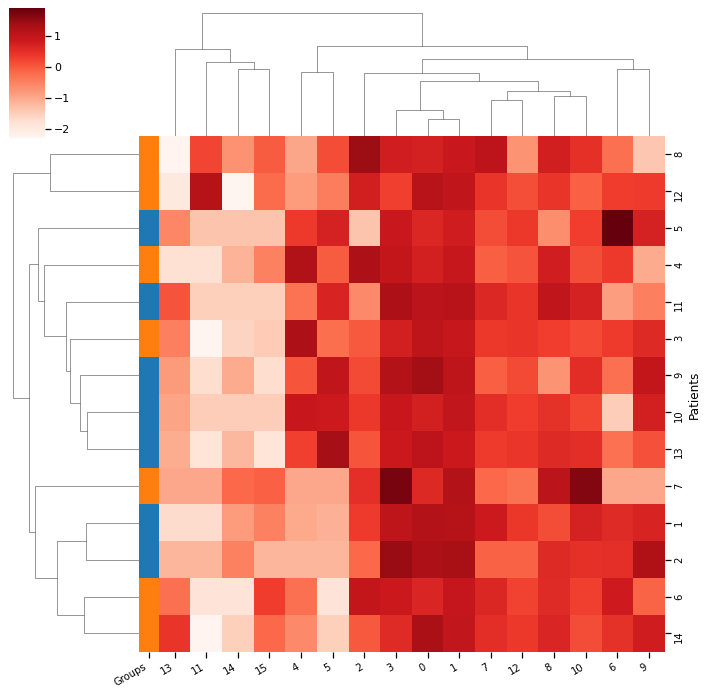

In [231]:
# proportion of cells in niches per sample, normalized with Central Log Ratio
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='clr')
# merge clinical data and proportion of cells in niches per sample
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d =mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-clr.png"
plt.savefig(cluster_dir / figname)

Training took {duration}s


<Figure size 432x288 with 0 Axes>

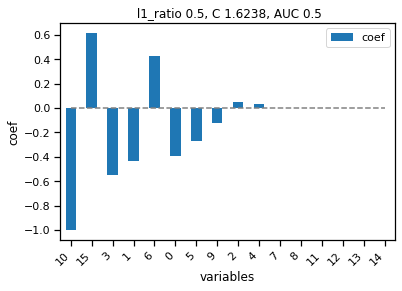

<Figure size 432x288 with 0 Axes>

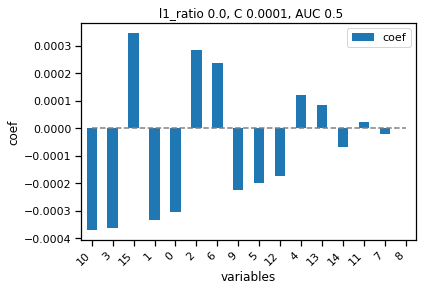

<Figure size 432x288 with 0 Axes>

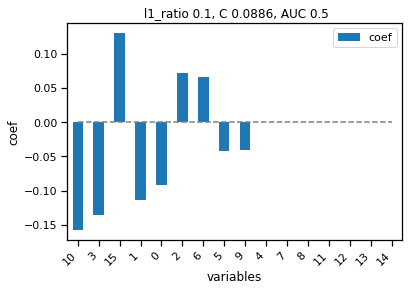

In [232]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

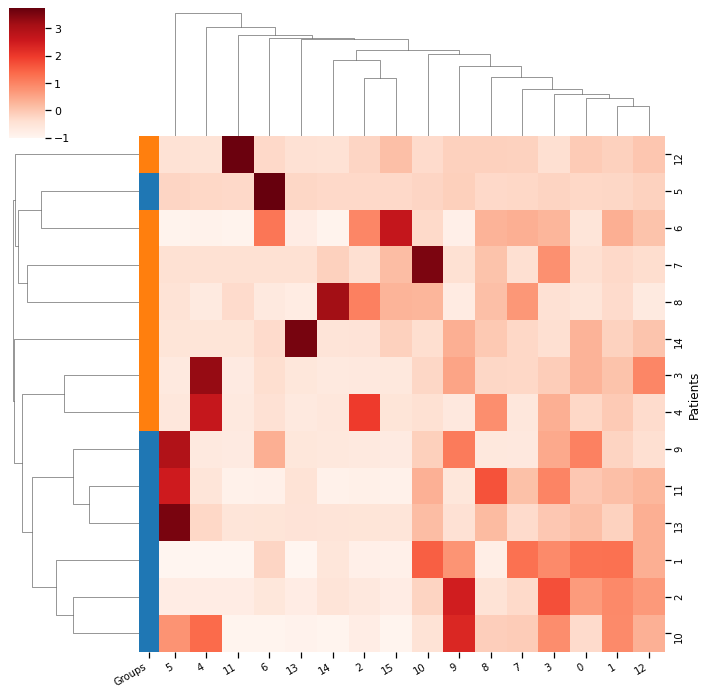

In [243]:
# proportion of cells in niches per sample, normalized per niche total count
counts = mosna.make_niches_composition(obj[sample_col], niches, var_label='variable', normalize='niche')
# merge clinical data and proportion of cells
counts_clinic = pd.concat([status, counts], axis=1, join='inner').sort_values('Spots').fillna(0)
counts_clinic.drop(columns=['Spots'], inplace=True)
counts_clinic = counts_clinic.groupby([patient_col, group_col]).mean()
# heatmap
g, d = mosna.plot_heatmap(
    counts_clinic.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )

figname = f"resolution-{cluster_params['resolution_parameter']}{other_str}_biclustering_normalized-niche.png"
plt.savefig(cluster_dir / figname)

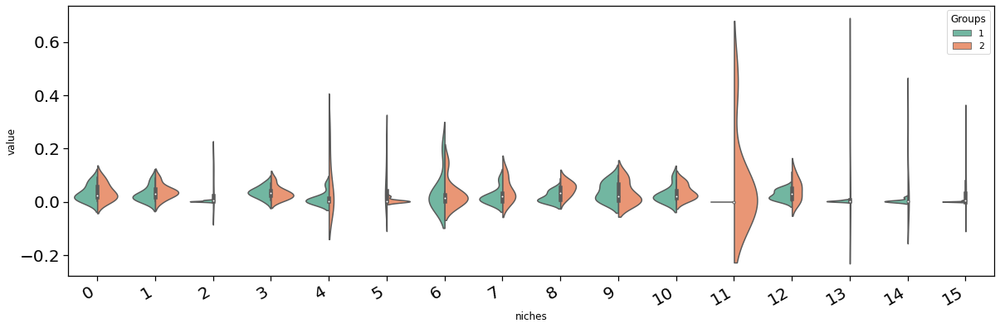

In [244]:
pvals = mosna.find_DE_markers(counts_clinic, group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

# DE analysis
fig, ax = mosna.plot_distrib_groups(
    counts_clinic, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=None,
    multi_ind_to_col=True,
    var_name='niches',
    )

In [245]:
pvals

,pval,pval_corr
15,0.002116,0.033850
8,0.026224,0.209790
2,0.072844,0.388500
5,0.139526,0.553456
11,0.172955,0.553456
7,0.259324,0.635198
14,0.300003,0.635198
1,0.317599,0.635198
10,0.442787,0.700685
13,0.476826,0.700685


Add                               8 with p-value 0.0250028
Add                               5 with p-value 0.0414848


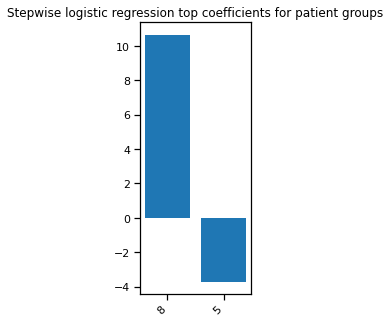

In [246]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=counts_clinic, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no niche statistically related to response group")

Training took {duration}s


<Figure size 432x288 with 0 Axes>

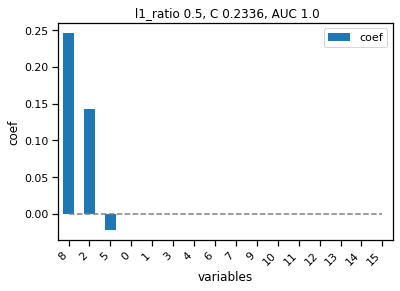

<Figure size 432x288 with 0 Axes>

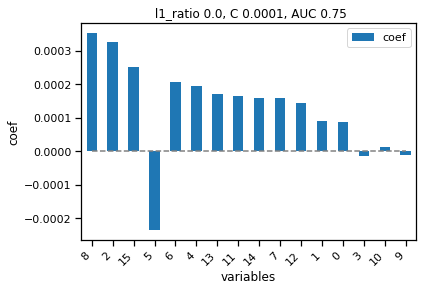

<Figure size 432x288 with 0 Axes>

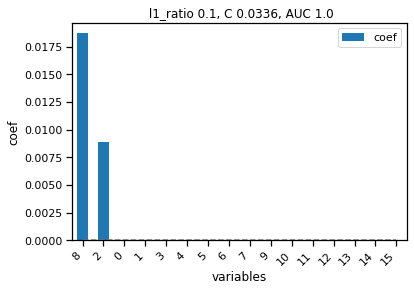

In [247]:
models = mosna.logistic_regression(
    counts_clinic,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

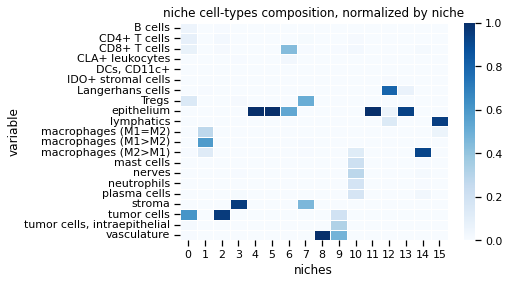

In [248]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

ROC AUC score perfect, only from pure niches.  
  - 8: vasculature
  - 2: tumor cells
  - 5: epithelium
  - 15: lymphatics + macrophages (M1=M2)  


Pure proportions of these cell types was not predictive of response, but proportion of ***pure niches*** are predictive.  
So mosna detects tumor exclusive areas predictive of response?!

## DGE wrt niches

Niches 4, 5 and 11 are apparently made of the same unique cell type: epithelial cells. What are the differences between these niches?  
The niche 13 has some langherans cells so that's explains more easily the separate clustering.

Loading reducer object and reduced coordinates


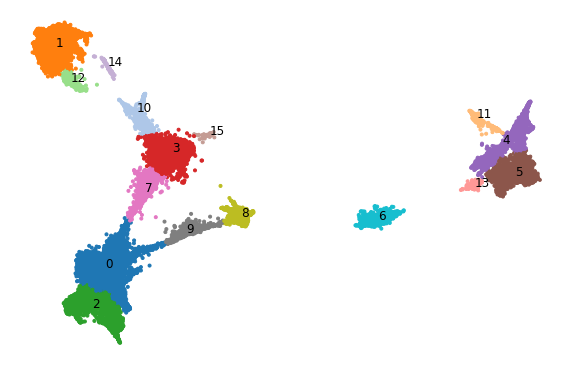

In [208]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

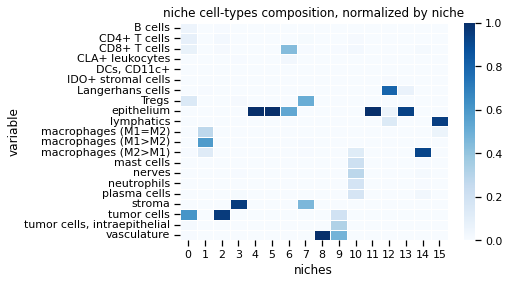

In [ ]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

### Differences in aggregation statistics

In [319]:
var_aggreg_niches = var_aggreg.copy()
var_aggreg_niches['niche'] = niches

In [311]:
pvals = mosna.find_DE_markers(var_aggreg_niches, group_ref=5, group_tgt=4, group_var='niche')
# pvals = pvals.sort_values(by='pval', ascending=True)
pvals

,pval,pval_corr
FOXP3 mean,0.000000,0.000000
CD68 mean,0.000000,0.000000
CD11b mean,0.000000,0.000000
BCL-2 mean,0.000000,0.000000
CD56 mean,0.000000,0.000000
...,...,...
CD163 mean,0.405477,0.420222
CollagenIV std,0.583114,0.598874
CCR4 std,0.741521,0.754763
CD68 std,0.777133,0.784011


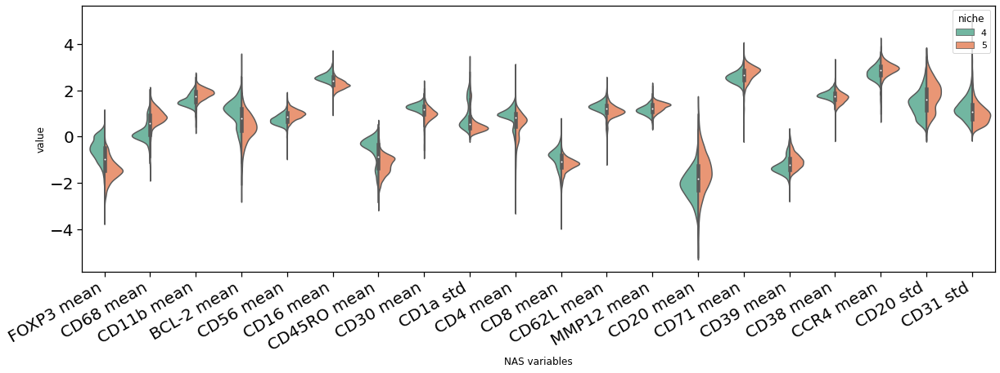

In [313]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    var_aggreg_niches, 
    group_var='niche',
    groups=[5, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [315]:
pvals = mosna.find_DE_markers(var_aggreg_niches, group_ref=11, group_tgt=4, group_var='niche')
# pvals = pvals.sort_values(by='pval', ascending=True)
pvals

,pval,pval_corr
FOXP3 mean,0.000000,0.000000
CD68 mean,0.000000,0.000000
CD34 mean,0.000000,0.000000
CD45RO mean,0.000000,0.000000
CD11c mean,0.000000,0.000000
...,...,...
VISTA std,0.427768,0.443324
CD16 std,0.706723,0.725823
CD3 std,0.912069,0.928356
CLA-CD162 mean,0.937080,0.945373


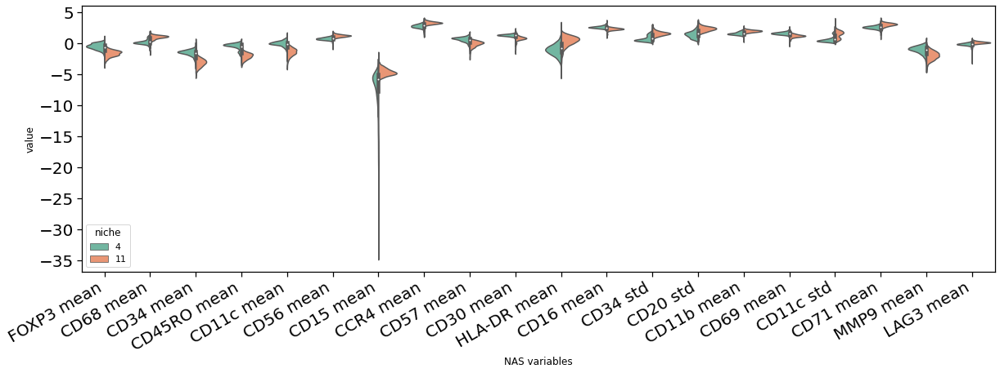

In [316]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    var_aggreg_niches, 
    group_var='niche',
    groups=[11, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [317]:
pvals = mosna.find_DE_markers(var_aggreg_niches, group_ref=11, group_tgt=5, group_var='niche')
# pvals = pvals.sort_values(by='pval', ascending=True)
pvals

,pval,pval_corr
HLA-DR mean,0.000000,0.000000
CD34 mean,0.000000,0.000000
CD15 mean,0.000000,0.000000
CD34 std,0.000000,0.000000
CD11c mean,0.000000,0.000000
...,...,...
CollagenIV std,0.463034,0.479872
BCL-2 mean,0.608129,0.624564
CD138 std,0.736108,0.749253
CD1a mean,0.793463,0.800485


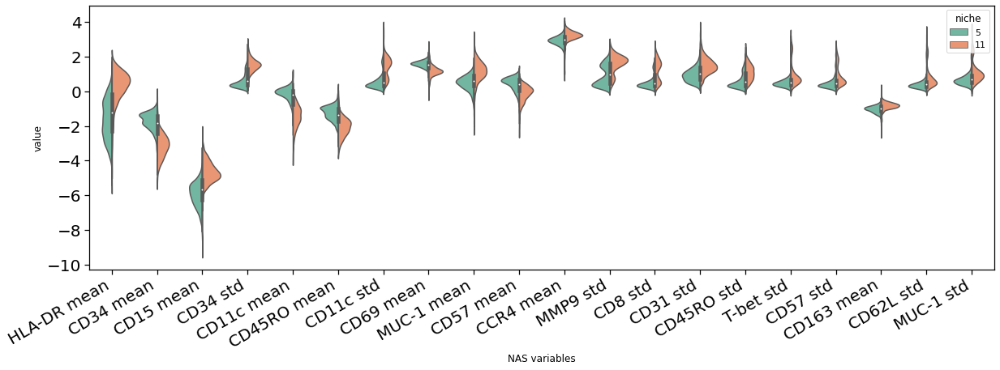

In [318]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    var_aggreg_niches, 
    group_var='niche',
    groups=[11, 5], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

### Differences in raw marker levels

In [341]:
markers_niches = obj[aggreg_vars].copy()
markers_niches['niche'] = niches

In [342]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=5, group_tgt=4, group_var='niche')
pvals

,pval,pval_corr
CD68,0.000000e+00,0.000000e+00
FOXP3,1.748839e-307,4.984190e-306
CD45RO,7.840747e-253,1.489742e-251
CD11b,7.934718e-240,1.130697e-238
CD56,5.212651e-158,5.942422e-157
...,...,...
PD-1,2.533940e-02,2.725181e-02
GranzymeB,3.705834e-02,3.911713e-02
CD2,1.022915e-01,1.060111e-01
CD45,3.734450e-01,3.801136e-01


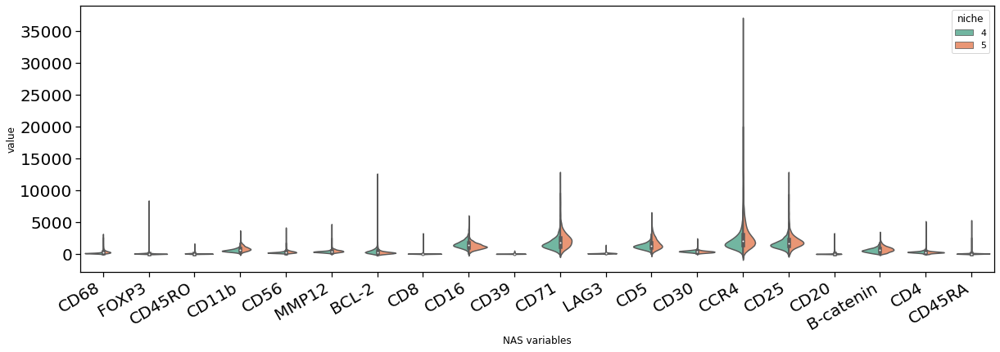

In [343]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[5, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [344]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=11, group_tgt=4, group_var='niche')
pvals

,pval,pval_corr
CD45RO,2.204420e-240,1.256519e-238
CD68,6.202233e-185,1.767636e-183
FOXP3,9.672129e-185,1.837704e-183
CD11c,2.625011e-170,3.740641e-169
CD57,1.995333e-150,2.274680e-149
...,...,...
GATA3,4.657516e-02,5.009027e-02
CLA-CD162,5.780164e-02,6.101284e-02
CD1a,6.057920e-02,6.278208e-02
CD45,1.018586e-01,1.036775e-01


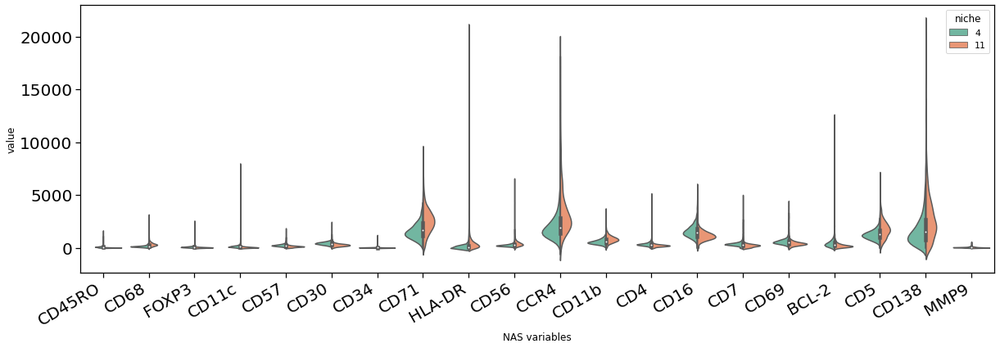

In [345]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[11, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [346]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=11, group_tgt=5, group_var='niche')
pvals

,pval,pval_corr
CD11c,5.669309e-182,3.231506e-180
HLA-DR,2.357210e-133,6.718048e-132
CD69,1.461109e-130,2.776108e-129
CD45RO,1.999114e-130,2.848738e-129
CD57,8.419553e-125,9.598291e-124
...,...,...
Ki-67,4.785722e-01,5.146908e-01
VISTA,5.542282e-01,5.850187e-01
ICOS,5.835005e-01,6.047187e-01
CCR6,7.863952e-01,8.004379e-01


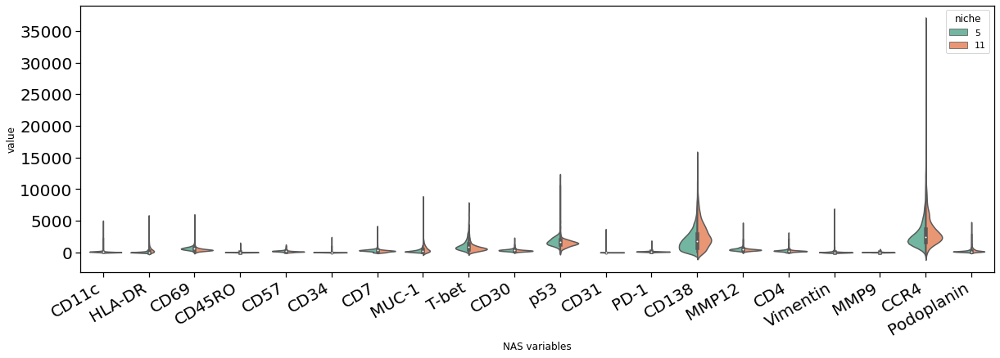

In [347]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[11, 5], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

### Differences in CLR normalized marker levels

In [ ]:
markers_niches = obj[aggreg_vars].copy()
markers_niches.loc[:, :] = X_clr
markers_niches['niche'] = niches

In [ ]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=5, group_tgt=4, group_var='niche')
pvals

,pval,pval_corr
FOXP3,0.000000e+00,0.000000e+00
CD68,0.000000e+00,0.000000e+00
CD45RO,0.000000e+00,0.000000e+00
CD16,3.420926e-236,4.874819e-235
CD8,1.498481e-188,1.708268e-187
...,...,...
CD138,1.155671e-01,1.242891e-01
Vimentin,4.468846e-01,4.717115e-01
CD69,4.903091e-01,5.081385e-01
GATA3,8.667592e-01,8.822370e-01


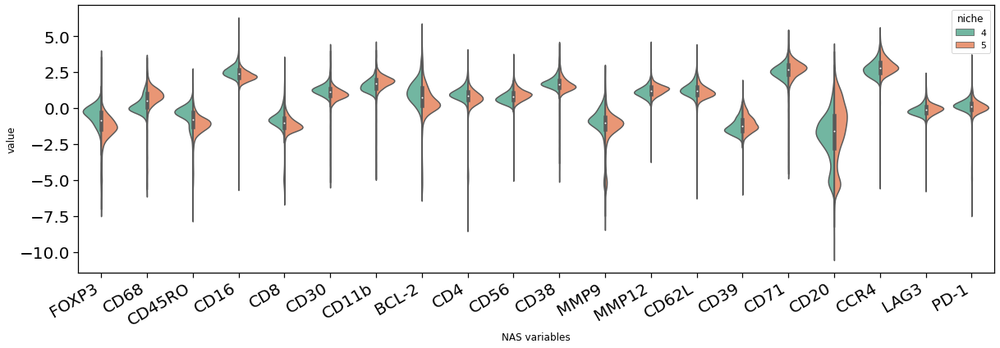

In [ ]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[5, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [ ]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=11, group_tgt=4, group_var='niche')
pvals

,pval,pval_corr
CD45RO,4.274864e-253,2.436673e-251
CD11c,1.329977e-203,3.790433e-202
CD68,3.289607e-198,6.250254e-197
FOXP3,9.788444e-180,1.394853e-178
CD34,6.921818e-150,7.890872e-149
...,...,...
CLA-CD162,1.514024e-02,1.628290e-02
CCR6,3.370205e-01,3.557439e-01
GATA3,5.210727e-01,5.400208e-01
CD164,6.103476e-01,6.212467e-01


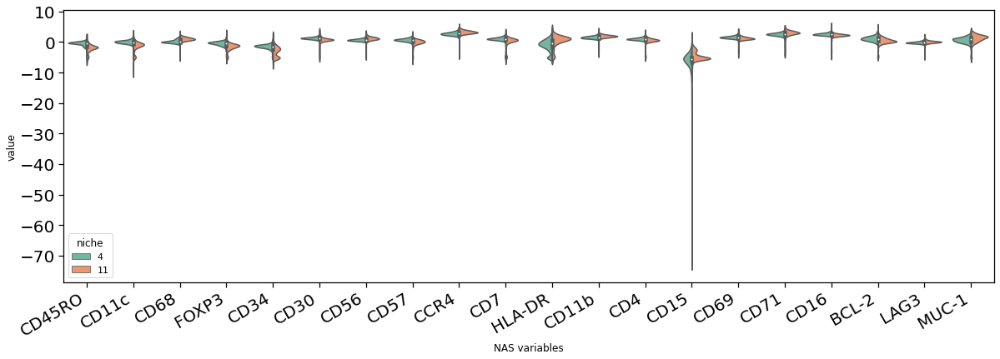

In [ ]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[11, 4], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

In [ ]:
pvals = mosna.find_DE_markers(markers_niches, group_ref=11, group_tgt=5, group_var='niche')
pvals

,pval,pval_corr
CD11c,1.033324e-192,5.889947e-191
HLA-DR,1.646575e-155,4.692739e-154
CD34,2.664865e-129,5.063244e-128
CD45RO,1.861688e-116,2.652906e-115
CD69,2.722480e-101,3.103628e-100
...,...,...
CD39,7.003074e-01,7.531608e-01
CD1a,7.424387e-01,7.816091e-01
Mastcell-tryptase,7.541842e-01,7.816091e-01
CD62L,7.797024e-01,7.936257e-01


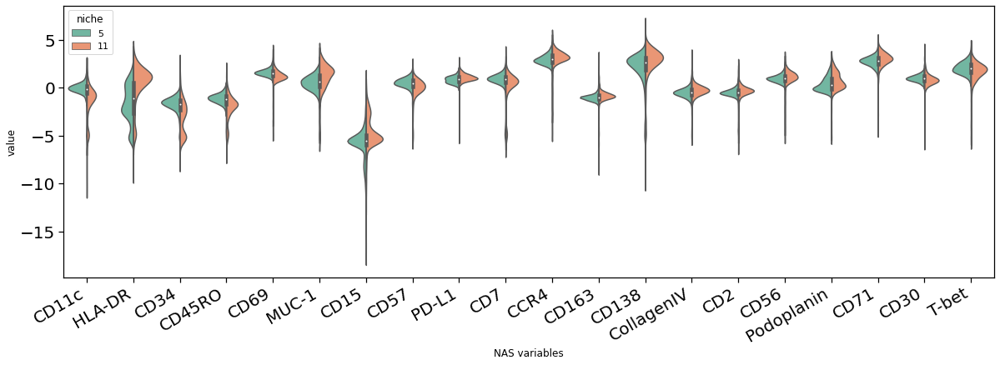

In [ ]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[11, 5], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    )

### Isolate cell type between niches

In [337]:
select_cell_type = cell_types == 'epithelium'
select_niches = niches == 4
for i in [5, 11]:
    select_niches = np.logical_or(select_niches, niches == i)

In [340]:
cell_types[select_niches].value_counts()

epithelium          7452
Langerhans cells       4
lymphatics             1
stroma                 1
tumor cells            1
Name: CellCluster, dtype: int64

There are so few other cells of another type that their contribution is negligible for the observed differences in distributions of markers or aggregation statistics between niches.

## On markers, order 2

In [348]:
order = 2
sof_dir = reconst_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.iloc[:, :2].values

file_path = sof_dir / f'aggregation_statistics.csv'
if file_path.is_file():
    print("Loading Neighbors Aggregation Statistics file")
    var_aggreg = pd.read_csv(file_path)
else:
    print("Computing Neighbors Aggregation Statistics")
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X_clr,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
    )
    var_aggreg.to_csv(file_path, index=False)

Loading Neighbors Aggregation Statistics file


In [351]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Performing clustering
Computing dimensionality reduction
Found 17 clusters


Loading reducer object and reduced coordinates


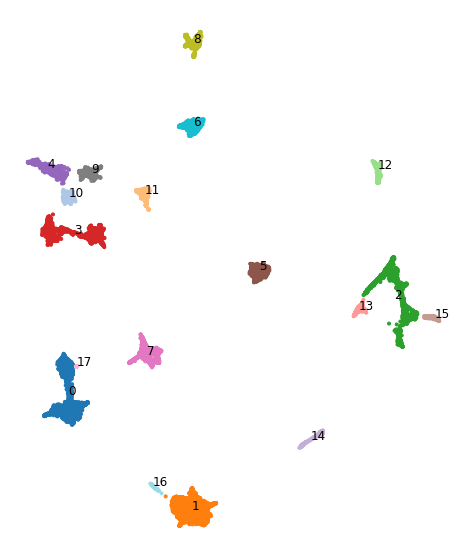

In [352]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

In [ ]:
save_dir = cluster_dir / f"spatial_networks_niches_nneigh-{cluster_params['n_neighbors']}"
save_dir.mkdir(parents=True, exist_ok=True)

# colormap for cell-types
n_cell_types = obj[pheno_col].unique().size
# palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])

plots_marker = '.'
for sample in obj[sample_col].unique():
    print("filename: {}".format(sample))
    select = np.array(obj[sample_col] == sample)

    # load nodes and edges
    coords = obj.loc[select, pos_cols].values
    # TODO: find a way to reuse pairs compatible with aggregated nodes
    # pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values
    pairs = ty.build_delaunay(coords, trim_dist=trim_dist)
    if k_sol > 0:
        pairs = ty.link_solitaries(coords, pairs, method='knn', k=k_sol)

    # Big summary plot
    fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
    i = 0
    ty.plot_network(coords, 
                    pairs,
                    labels=obj.loc[select, pheno_col], 
                    color_mapper=celltypes_color_mapper, 
                    marker=plots_marker, 
                    size_nodes=size_points, 
                    ax=ax[0])
    ax[i].set_title('Spatial map of phenotypes', fontsize=14);

    i += 1
    ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points)
    ax[i].set_title('Spatial map of detected areas', fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=5);
    ax[i].set_title("Clustering on NAS", fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors);
    ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
    ax[i].set_aspect('equal')
    
    # make plot limits equal
    ax[i-1].set_xlim(ax[i].get_xlim())
    ax[i-1].set_ylim(ax[i].get_ylim())

    suptitle = f"Spatial omics data and detected areas - sample {sample}";
    fig.suptitle(suptitle, fontsize=18)

    fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)
    plt.show()

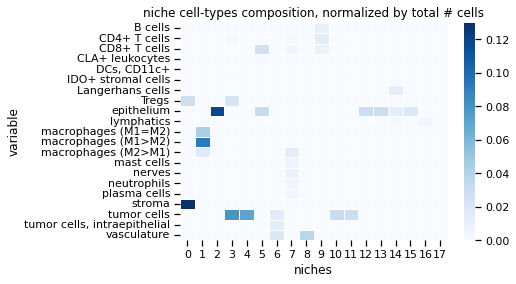

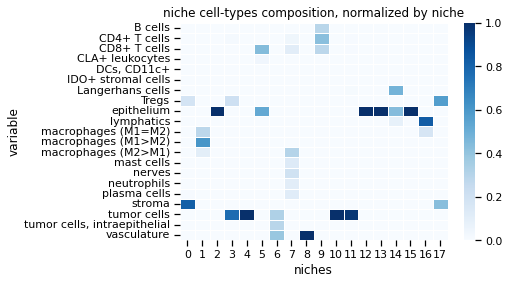

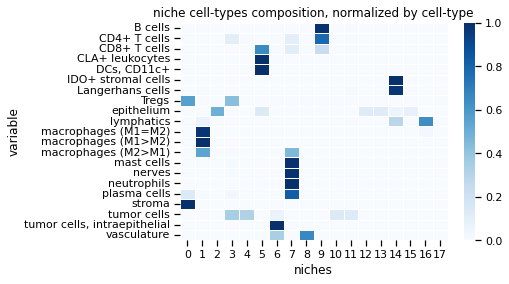

In [357]:
# Survival analysis

cell_types = nodes_all['CellCluster']
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

## On markers, order 3

#### mean & std

In [359]:
order = 3
sof_dir = reconst_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.iloc[:, :2].values

file_path = sof_dir / f'aggregation_statistics.csv'
if file_path.is_file():
    print("Loading Neighbors Aggregation Statistics file")
    var_aggreg = pd.read_csv(file_path)
else:
    print("Computing Neighbors Aggregation Statistics")
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X_clr,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
    )
    var_aggreg.to_csv(file_path, index=False)

Compouting Neighbors Aggregation Statistics


In [360]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Performing clustering
Computing dimensionality reduction
Found 39 clusters


Loading reducer object and reduced coordinates


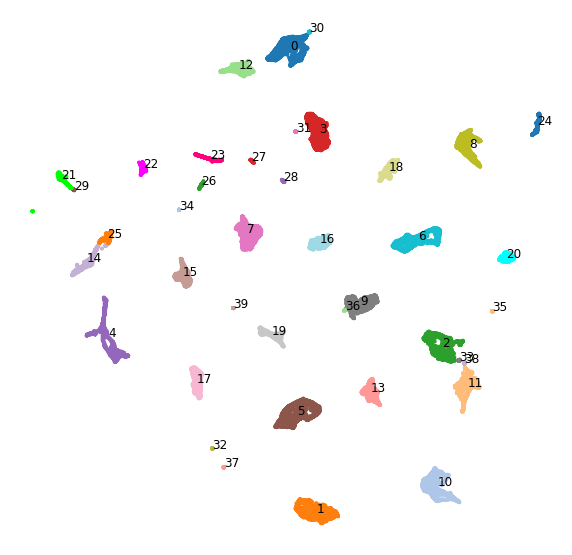

In [361]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

In [362]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Performing clustering
Computing dimensionality reduction
Found 32 clusters


Loading reducer object and reduced coordinates


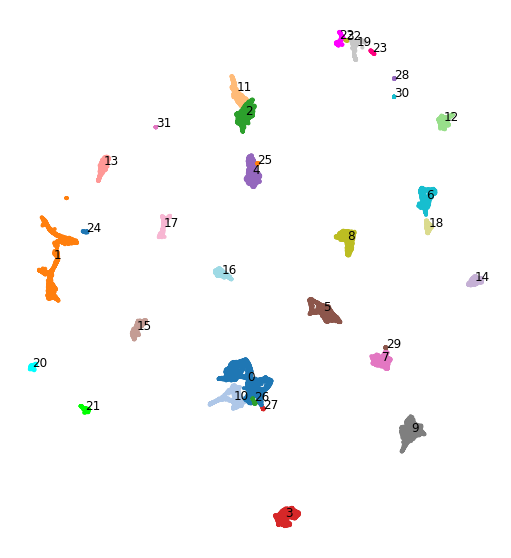

In [363]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

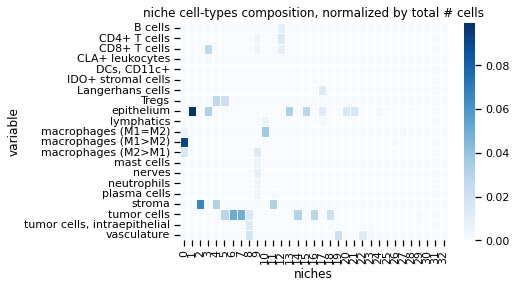

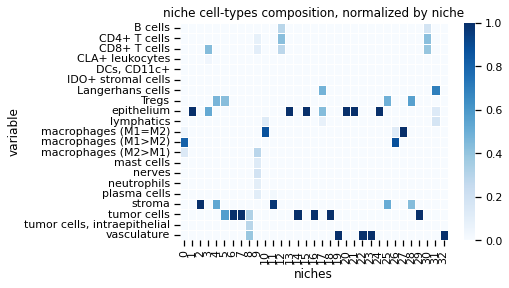

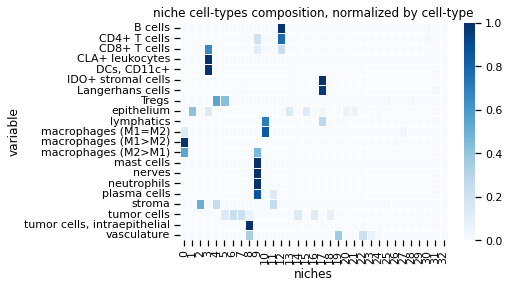

In [364]:
# Survival analysis

cell_types = nodes_all['CellCluster']
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

## mean only

In [366]:
order = 1
var_type = 'markers'
stat_names = 'mean'
aggreg_vars = marker_cols

# For UMAP visualization
marker = '.'
size_points = 10

In [367]:
sof_dir = reconst_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

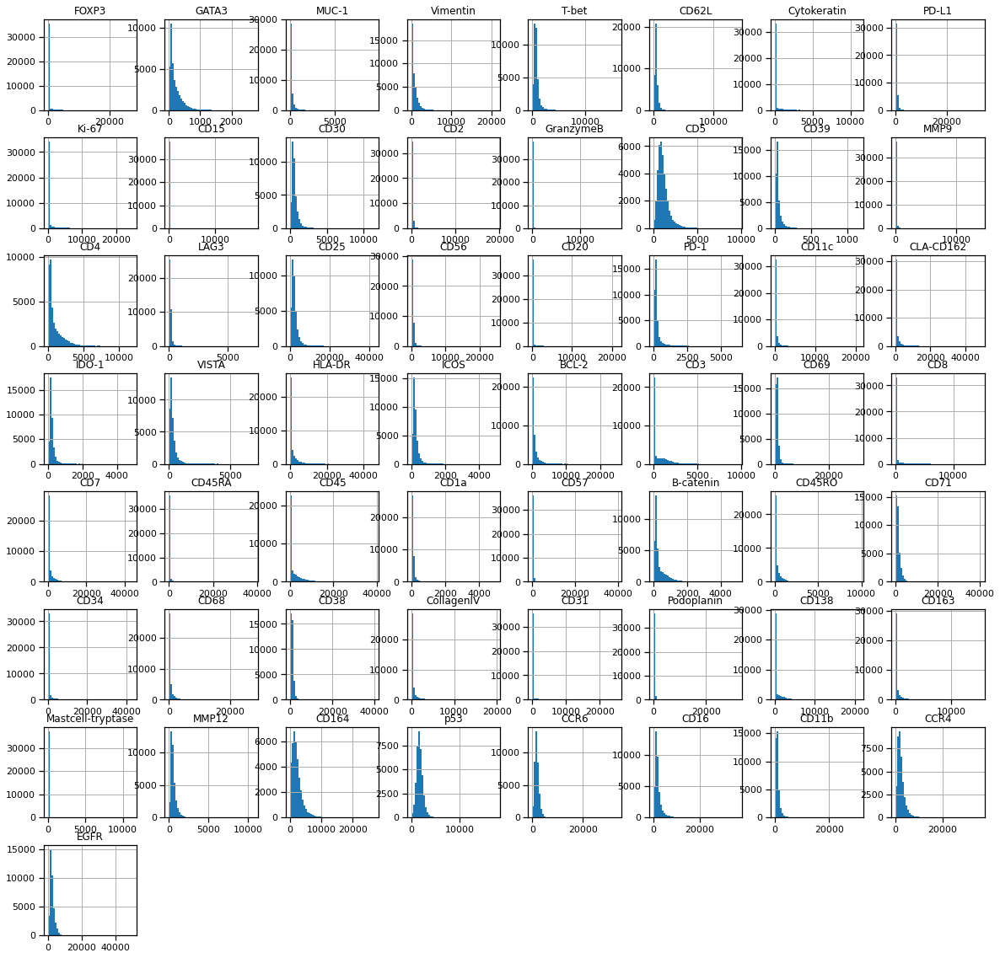

In [368]:
obj[aggreg_vars].hist(bins=50, figsize=(20, 20));

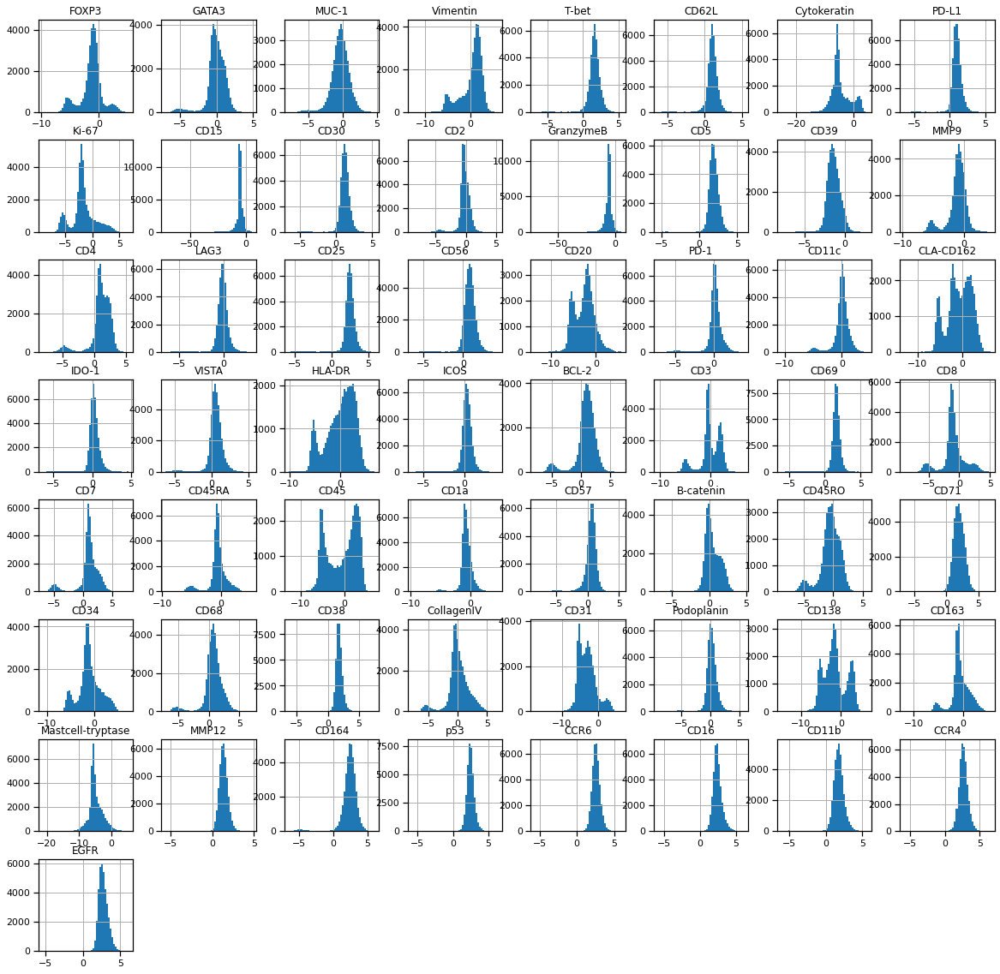

In [369]:
X = obj[aggreg_vars].values
X[X == 0] = X.max() / 100000

X_clr = cs.clr(cs.closure(X))
aggreg_vars_clr = obj[aggreg_vars].copy()
aggreg_vars_clr.loc[:, :] = X_clr
aggreg_vars_clr.hist(bins=50, figsize=(20, 20));

In [370]:
edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.values

In [372]:
file_path = sof_dir / f'aggregation_statistics.csv'

if file_path.is_file():
    print("Loading Neighbors Aggregation Statistics file")
    var_aggreg = pd.read_csv(file_path)
else:
    print("Computing Neighbors Aggregation Statistics")
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X_clr,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
        stat_funcs=np.mean,
        stat_names='mean',
    )
    var_aggreg.to_csv(file_path, index=False)

Loading Neighbors Aggregation Statistics file


In [374]:
embedding, reducer = mosna.get_reducer(
    data=var_aggreg, 
    save_dir=sof_dir,
    reducer_type='umap', 
    n_neighbors=15, 
    metric='euclidean', 
    min_dist=0.0,
    )

Loading reducer object and reduced coordinates


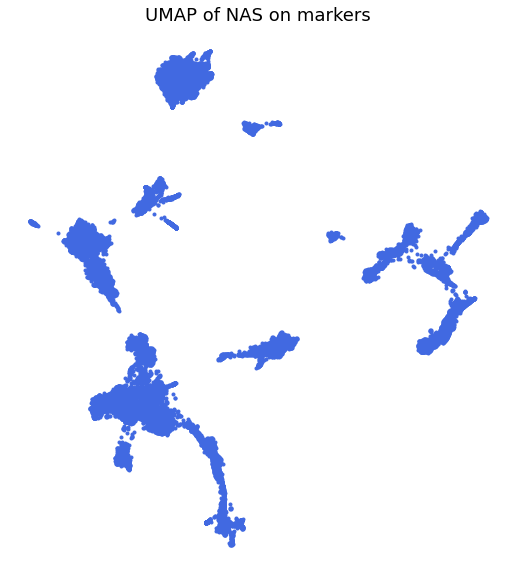

In [375]:
mosna.plot_clusters(embedding)
title = f"UMAP of NAS on {var_type}"
plt.title(title, fontsize=18);

In [378]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Loading clusterer object and cluster labels
There are 18 clusters


Loading reducer object and reduced coordinates


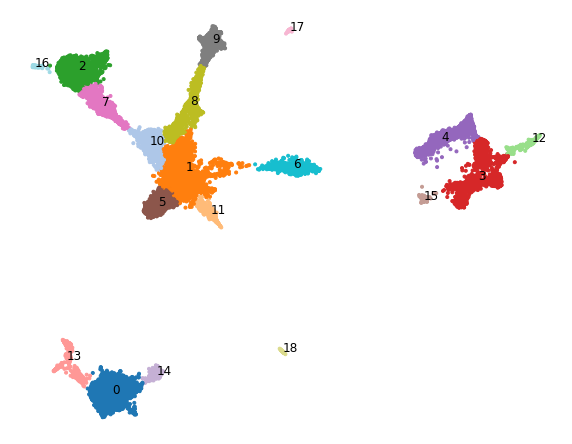

In [379]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

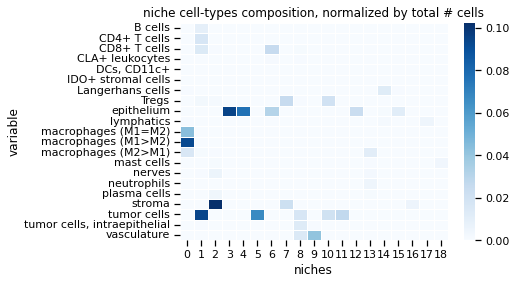

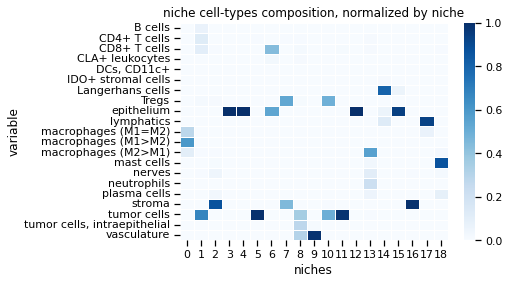

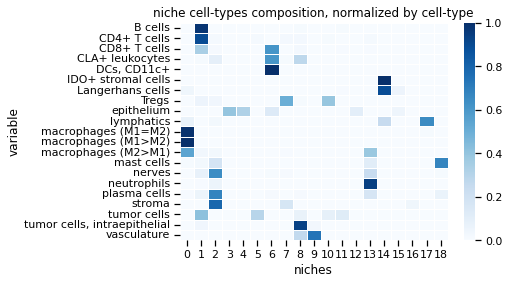

In [380]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

In [381]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Loading clusterer object and cluster labels
There are 17 clusters


Loading reducer object and reduced coordinates


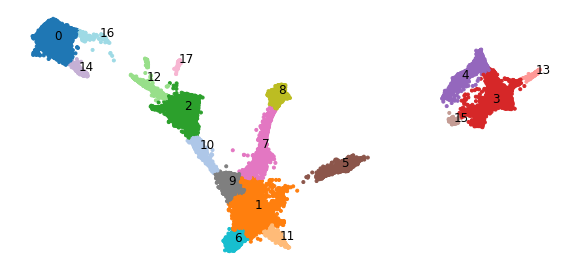

In [382]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

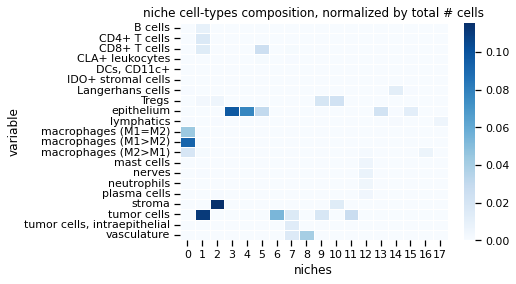

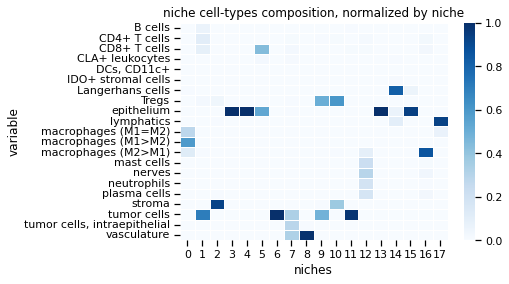

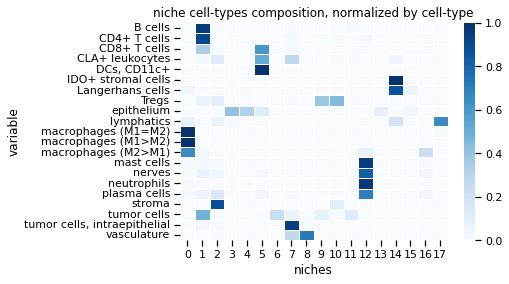

In [383]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

### On markers, order 2

In [384]:
order = 2
sof_dir = reconst_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.iloc[:, :2].values

file_path = sof_dir / f'aggregation_statistics.csv'
if file_path.is_file():
    print("Loading Neighbors Aggregation Statistics file")
    var_aggreg = pd.read_csv(file_path)
else:
    print("Computing Neighbors Aggregation Statistics")
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X_clr,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
        stat_funcs=np.mean,
        stat_names='mean',
    )
    var_aggreg.to_csv(file_path, index=False)

Computing Neighbors Aggregation Statistics


In [385]:
embedding, reducer = mosna.get_reducer(
    data=var_aggreg, 
    save_dir=sof_dir,
    reducer_type='umap', 
    n_neighbors=15, 
    metric='euclidean', 
    min_dist=0.0,
    )

Computing dimensionality reduction


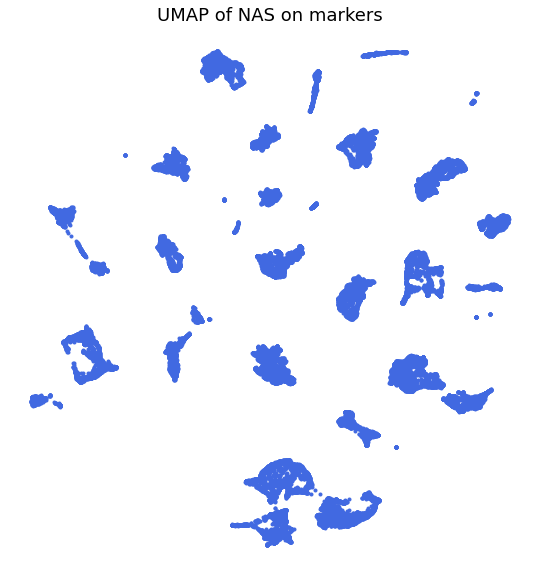

In [386]:
mosna.plot_clusters(embedding)
title = f"UMAP of NAS on {var_type}"
plt.title(title, fontsize=18);

In [387]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Performing clustering
Computing dimensionality reduction
Found 25 clusters


Loading reducer object and reduced coordinates


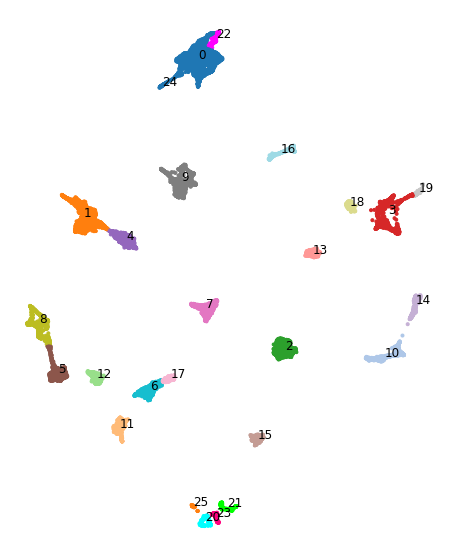

In [388]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

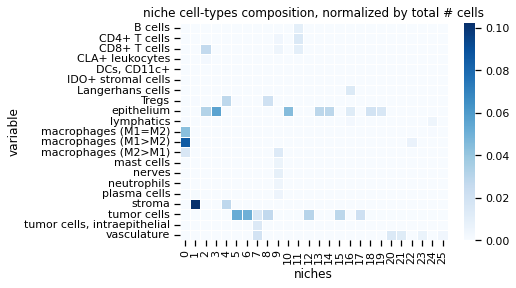

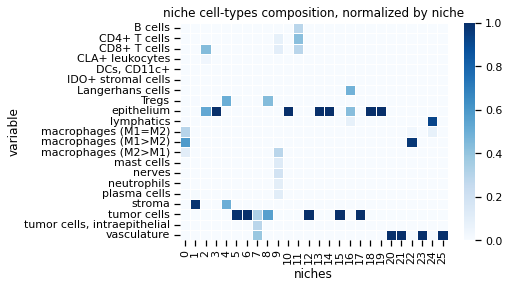

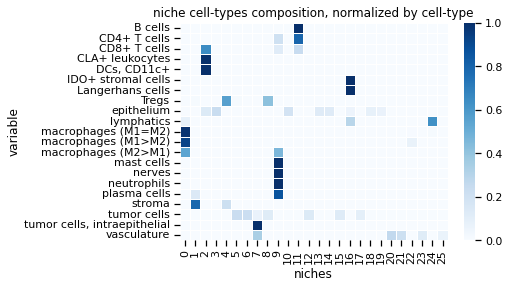

In [389]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

In [390]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Performing clustering
Computing dimensionality reduction
Found 21 clusters


Loading reducer object and reduced coordinates


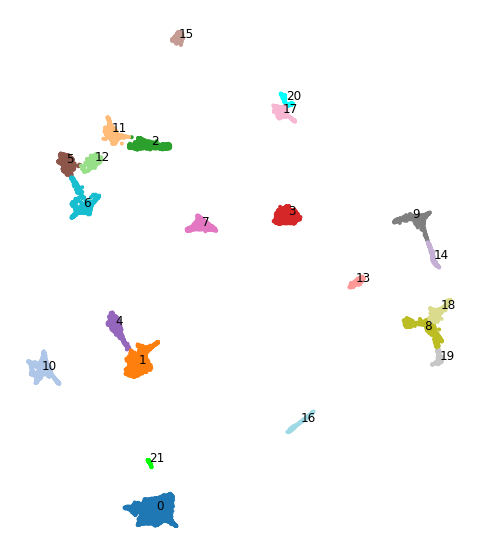

In [391]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

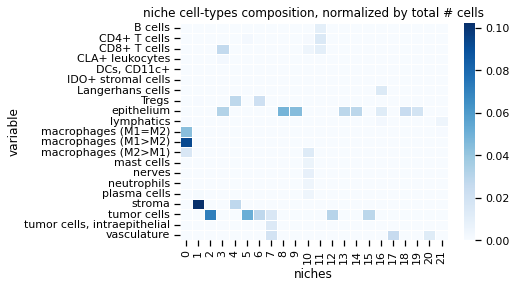

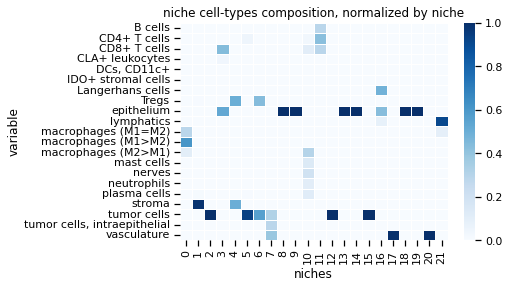

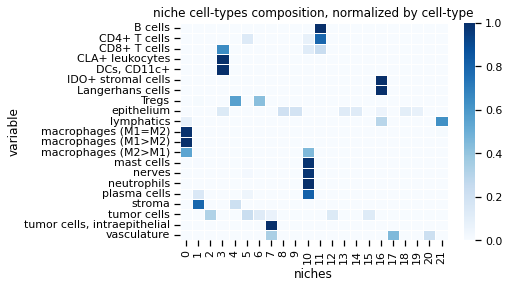

In [392]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

### On markers, order 3

In [394]:
order = 3
sof_dir = reconst_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.iloc[:, :2].values

file_path = sof_dir / f'aggregation_statistics.csv'
if file_path.is_file():
    print("Loading Neighbors Aggregation Statistics file")
    var_aggreg = pd.read_csv(file_path)
else:
    print("Computing Neighbors Aggregation Statistics")
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X_clr,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
        stat_funcs=np.mean,
        stat_names='mean',
    )
    var_aggreg.to_csv(file_path, index=False)

Computing Neighbors Aggregation Statistics


In [395]:
embedding, reducer = mosna.get_reducer(
    data=var_aggreg, 
    save_dir=sof_dir,
    reducer_type='umap', 
    n_neighbors=15, 
    metric='euclidean', 
    min_dist=0.0,
    )

Computing dimensionality reduction


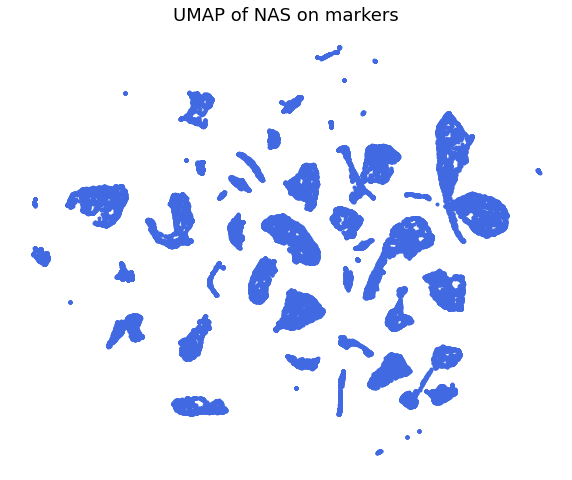

In [396]:
mosna.plot_clusters(embedding)
title = f"UMAP of NAS on {var_type}"
plt.title(title, fontsize=18);

In [397]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 75, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Performing clustering
Computing dimensionality reduction
Found 29 clusters


Loading reducer object and reduced coordinates


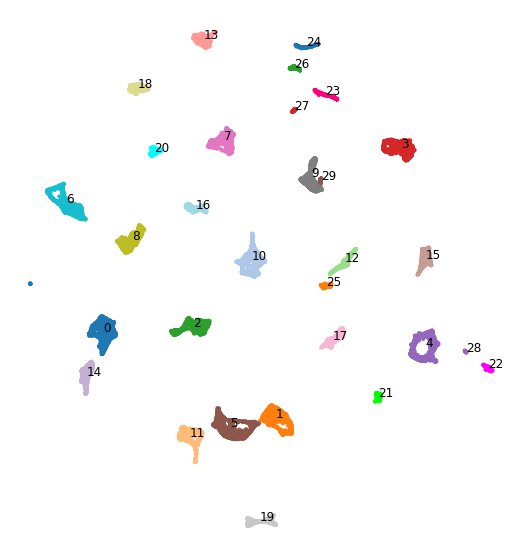

In [398]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

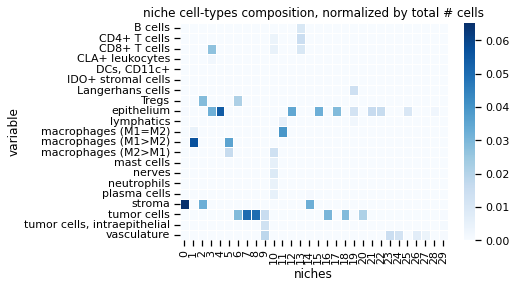

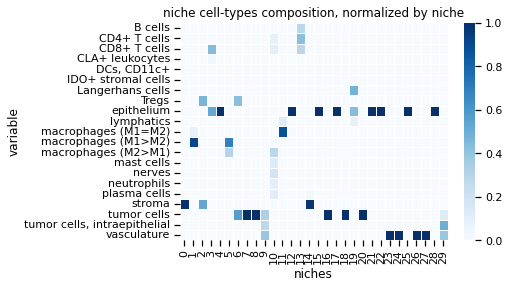

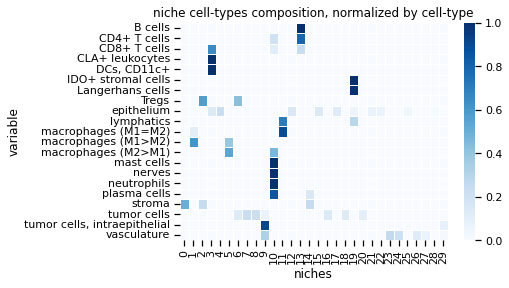

In [399]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

In [400]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean', 
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

Performing clustering
Computing dimensionality reduction
Found 28 clusters


Loading reducer object and reduced coordinates


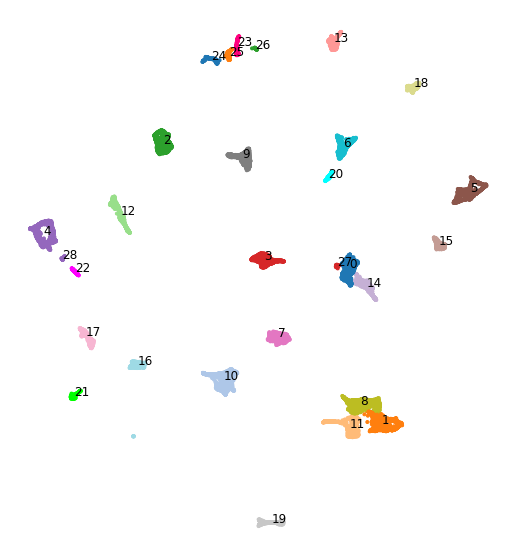

In [401]:
embed_viz, _ = mosna.get_reducer(var_aggreg, sof_dir, reducer_type='umap', n_neighbors=cluster_params['n_neighbors'])
fig, ax, niches_color_mapper = mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params, return_cmap=True)

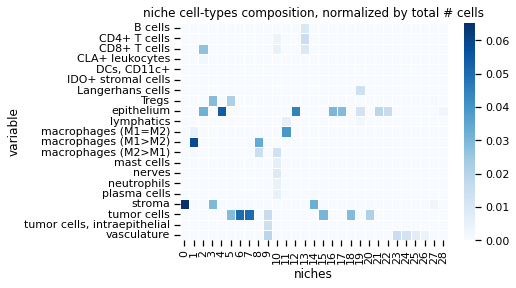

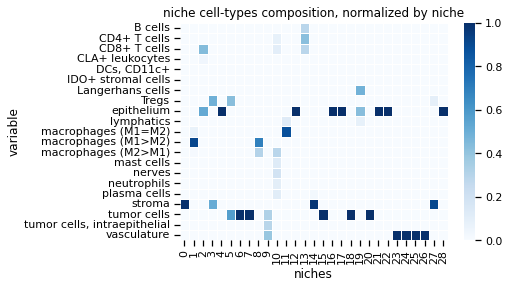

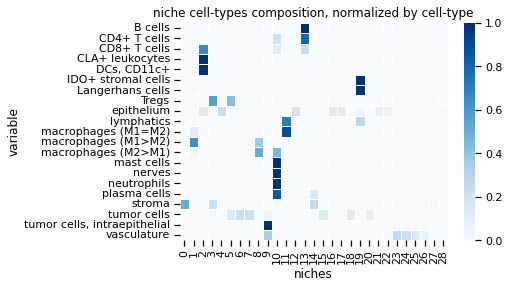

In [402]:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')